In [ ]:
import pywt
import numpy as np
import cv2
from PIL import Image

def wavelet_denoising(image, wavelet_name='db2', level=1):
  # Apply Discrete Wavelet Transform (DWT)
  coeffs = pywt.dwt2(image, wavelet_name)

  # Thresholding for noise removal (replace with a suitable thresholding function)
  thresh = np.sqrt(2. * np.log(image.shape[0] * image.shape[1]))
  for i in range(len(coeffs[0])):
    for j in range(len(coeffs[0][i])):
      coeff_arr = coeffs[0][i][j]
      coeffs[0][i][j] = np.sign(coeff_arr) * np.maximum(np.abs(coeff_arr) - thresh, 0)

  # Inverse DWT for reconstruction
  denoised_image = pywt.idwt2(coeffs, wavelet_name)

  return denoised_image

# Example usage (replace 'your_image.jpg' with your image path)
noisy_image =cv2.imread('/0000137530.tif', cv2.IMREAD_GRAYSCALE)  # Replace with your image loading method
denoised_image = wavelet_denoising(noisy_image)


ValueError: Input array has fewer dimensions than the specified axes

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload()


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"saichandana50","key":"03ee007f7dc553b72965e7f561b76371"}'}

In [ ]:
import pandas as pd

In [ ]:
import cv2
import os
import pandas as pd

def load_images(folder_path):
  images = []
  for filename in os.listdir(folder_path):
    # Check if the file is an image
    if filename.lower().endswith((".tif")):
      image_path = os.path.join(folder_path, filename)
      image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
      if image is not None:  # Check if image was loaded successfully
        images.append(image)
  return images

# Example usage
folder_path = "/content/drive/MyDrive/Datasets/invoice (1)/invoice"
loaded_images = load_images(folder_path)

# Process the loaded images here (e.g., resize, normalize)


In [ ]:
len(loaded_images)

90

In [ ]:
import numpy as np
import cv2
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model

# Create a simple denoising autoencoder
def create_denoising_autoencoder():
    input_img = Input(shape=(None, None, 1))

    # Encoder
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

    return autoencoder

# Generate synthetic training data
def generate_synthetic_data(num_samples=1000):
    clean_images = []
    noisy_images = []
    for _ in range(num_samples):
        clean_image = np.random.rand(128, 128)
        noisy_image = clean_image + np.random.normal(loc=0.0, scale=0.1, size=clean_image.shape)
        clean_image = np.clip(clean_image, 0., 1.)
        noisy_image = np.clip(noisy_image, 0., 1.)
        clean_images.append(clean_image)
        noisy_images.append(noisy_image)

    clean_images = np.array(clean_images).astype('float32').reshape(-1, 128, 128, 1)
    noisy_images = np.array(noisy_images).astype('float32').reshape(-1, 128, 128, 1)

    return noisy_images, clean_images

# Train the denoising autoencoder
autoencoder = create_denoising_autoencoder()
noisy_images, clean_images = generate_synthetic_data()
autoencoder.fit(noisy_images, clean_images, epochs=50, batch_size=32, shuffle=True)

# Save the trained model
autoencoder.save('denoise_autoencoder.h5')


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import cv2

def preprocess_invoice(image_path, use_denoise_autoencoder=False, autoencoder_model=None):
    # Load the image
    img = cv2.imread(image_path)
    print(f"Original image shape: {img.shape}")

    # Convert to grayscale
    gray_img = color.rgb2gray(img)
    gray_img = (gray_img * 255).astype(np.uint8)
    print(f"Grayscale image shape: {gray_img.shape}")

    if use_denoise_autoencoder and autoencoder_model is not None:
        # Normalize the image for the autoencoder
        img_normalized = gray_img / 255.0
        img_input = np.expand_dims(img_normalized, axis=(0, -1))  # Add batch and channel dimensions

        # Perform denoising using the autoencoder
        denoised_img = autoencoder_model.predict(img_input)

        # Check the shape of the denoised image
        print(f"Denoised image shape (from model): {denoised_img.shape}")

        # Reshape the output if needed and crop to match the input size
        denoised_img = denoised_img[0, :, :gray_img.shape[1]].reshape(gray_img.shape)
        denoised_img = (denoised_img * 255).astype('uint8')
    else:
        # Denoise using a simple Gaussian filter
        denoised_img = cv2.GaussianBlur(gray_img, (5, 5), 0)

    print(f"Denoised image shape: {denoised_img.shape}")

    # Ensure the denoised image is in uint8 format
    denoised_img = denoised_img.astype('uint8')

    # Apply histogram equalization to enhance contrast
    equalized_img = cv2.equalizeHist(denoised_img)

    # Adaptive thresholding for binarization
    try:
        blockSize = 11  # Adjust blockSize (must be odd) to control the area considered for thresholding
        C = 2  # Adjust C (positive, negative, or zero) to fine-tune thresholding
        thresh = cv2.adaptiveThreshold(equalized_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                       cv2.THRESH_BINARY, blockSize, C)
    except cv2.error as e:
        print(f"OpenCV error: {e}")
        return None

    return thresh

# Example usage with a placeholder for the autoencoder model
image_path = "/content/drive/MyDrive/Datasets/0001140965.tif"
autoencoder_model = None  # Replace with your actual autoencoder model
binary_image = preprocess_invoice(image_path, use_denoise_autoencoder=True, autoencoder_model=autoencoder_model)
if binary_image is not None:
    plt.imshow(binary_image, cmap='gray')
    plt.show()
else:
    print("Failed to preprocess the image.")


In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


Num GPUs Available:  0


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras import mixed_precision

def create_denoising_autoencoder(input_shape=(128, 128, 1)):
    input_img = Input(shape=input_shape)

    # Encoder
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(input_img)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = UpSampling2D((2, 2))(x)

    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
    return autoencoder

autoencoder = create_denoising_autoencoder()
autoencoder.summary()

def generate_synthetic_data(num_samples=1000):
    clean_images = []
    noisy_images = []
    for _ in range(num_samples):
        clean_image = np.random.rand(128, 128)
        noisy_image = clean_image + np.random.normal(loc=0.0, scale=0.1, size=clean_image.shape)
        clean_image = np.clip(clean_image, 0., 1.)
        noisy_image = np.clip(noisy_image, 0., 1.)
        clean_images.append(clean_image)
        noisy_images.append(noisy_image)

    clean_images = np.array(clean_images).astype('float32').reshape(-1, 128, 128, 1)
    noisy_images = np.array(noisy_images).astype('float32').reshape(-1, 128, 128, 1)

    return noisy_images, clean_images

noisy_images, clean_images = generate_synthetic_data(2000)

# Convert to TensorFlow datasets
train_dataset = tf.data.Dataset.from_tensor_slices((noisy_images, clean_images))
train_dataset = train_dataset.shuffle(buffer_size=1000).batch(64).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

# Profile the training process
#log_dir = "logs/profile/"
#tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, profile_batch='500,520')

# Train the autoencoder
# Split the dataset into training and validation sets
train_size = int(0.9 * len(train_dataset))
val_size = len(train_dataset) - train_size

train_dataset = train_dataset.take(train_size)
val_dataset = train_dataset.skip(train_size)

# Train the autoencoder using both datasets
#autoencoder.fit(train_dataset, epochs=50, validation_split=0.1, callbacks=[tensorboard_callback])


# Train the autoencoder using both datasets
autoencoder.fit(train_dataset, epochs=50, validation_data=val_dataset)


Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, 128, 128, 1)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_25 (Conv2D)                   │ (None, 128, 128, 16)        │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_20               │ (None, 128, 128, 16)        │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 64, 64, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_26 (Conv2D)                   │ (None, 64, 64, 16)          │           2,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_21               │ (None, 64, 64, 16)          │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 32, 32, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_27 (Conv2D)                   │ (None, 32, 32, 16)          │           2,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_22               │ (None, 32, 32, 16)          │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_10 (UpSampling2D)      │ (None, 64, 64, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_28 (Conv2D)                   │ (None, 64, 64, 16)          │           2,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_23               │ (None, 64, 64, 16)          │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_11 (UpSampling2D)      │ (None, 128, 128, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_29 (Conv2D)                   │ (None, 128, 128, 1)         │             145 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,521 (29.38 KB)

 Trainable params: 7,393 (28.88 KB)

 Non-trainable params: 128 (512.00 B)

Epoch 1/50
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - loss: 0.7876

AttributeError: 'NoneType' object has no attribute 'items'

In [ ]:
pip install --upgrade tensorflow


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 76.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 58.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 52.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 70.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 34.6 MB/s eta 0:00:00
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.2.0
    Uninstalling ml-dtypes-0.2.0:
      Successfully uninstalled ml-dtypes-0.2.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.9.0
    Uninstalling h5py-3.9.0:
      Successfully uninstalled h5py-3.9.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.15.2
    Uninstalling tensorboard-2.15.2:
      Successfully uninstalled tensorboard-2.15.2
  Attempting uninstall: keras
    Fo

In [ ]:

# 21 May 2024

array([[  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
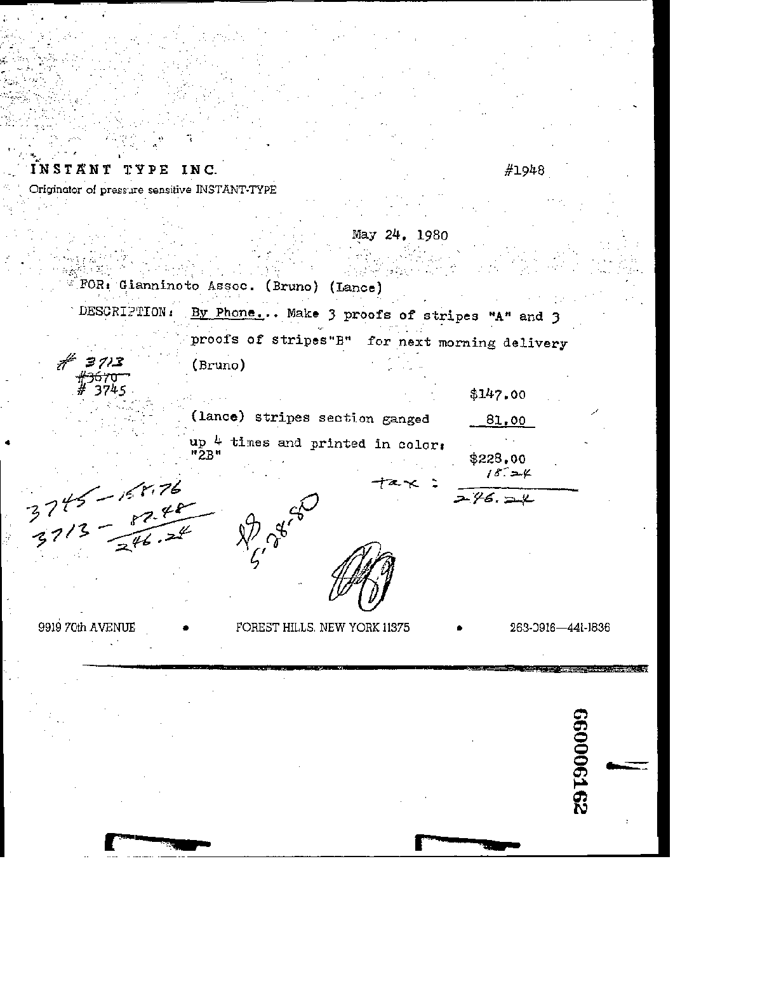

In [ ]:
cv2.imread("/content/drive/MyDrive/Datasets/0000113725.tif", cv2.IMREAD_GRAYSCALE)


array([[  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
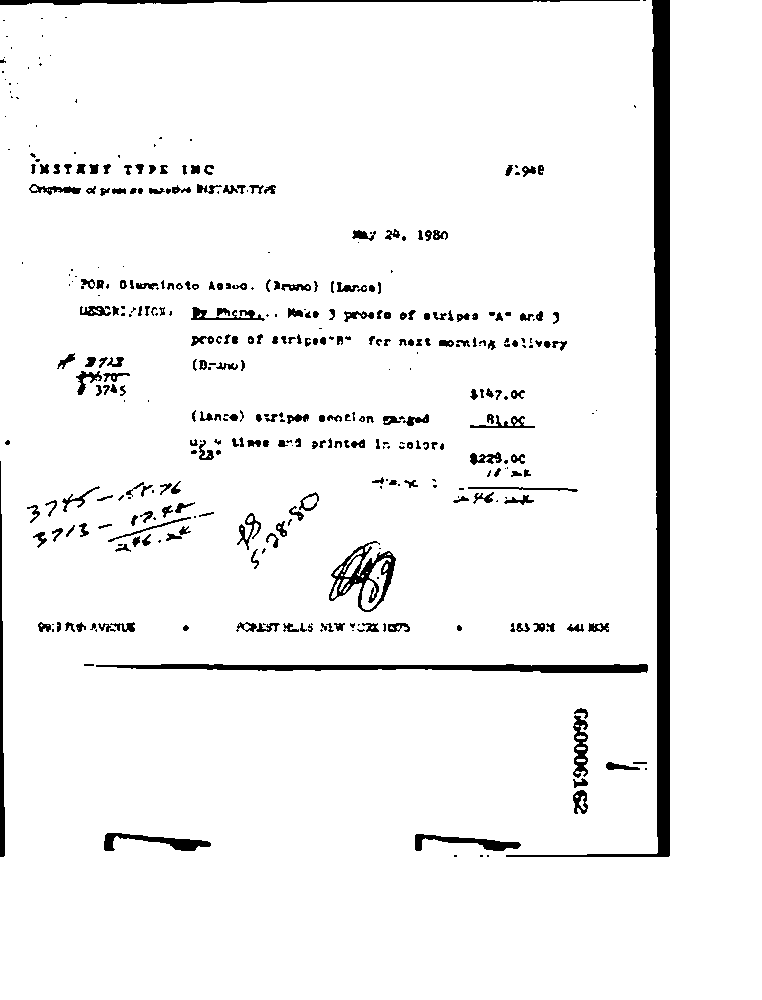

In [ ]:
import cv2

image = cv2.imread("/content/drive/MyDrive/Datasets/0000113725.tif", cv2.IMREAD_GRAYSCALE)

# Apply median filter with a window size of 3 (adjust as needed)
filtered_image = cv2.medianBlur(image, 3)
_, denoised_image = cv2.threshold(filtered_image,200, 255, cv2.THRESH_BINARY)

#filtered_image_bilateral = cv2.bilateralFilter(filtered_image, 25, 100, 100)

denoised_image


/usr/local/lib/python3.10/dist-packages/pywt/_multilevel.py:43: UserWarning: Level value of 900 is too high: all coefficients will experience boundary effects.
  warnings.warn(


array([[  6,   5,   5, ..., 254, 254, 254],
       [  0,   0,   0, ..., 254, 254, 254],
       [  0,   0,   0, ..., 254, 254, 254],
       ...,
       [254, 254, 254, ..., 255, 255, 255],
       [254, 254, 254, ..., 255, 255, 255],
       [254, 254, 254, ..., 255, 255, 255]], dtype=uint8)
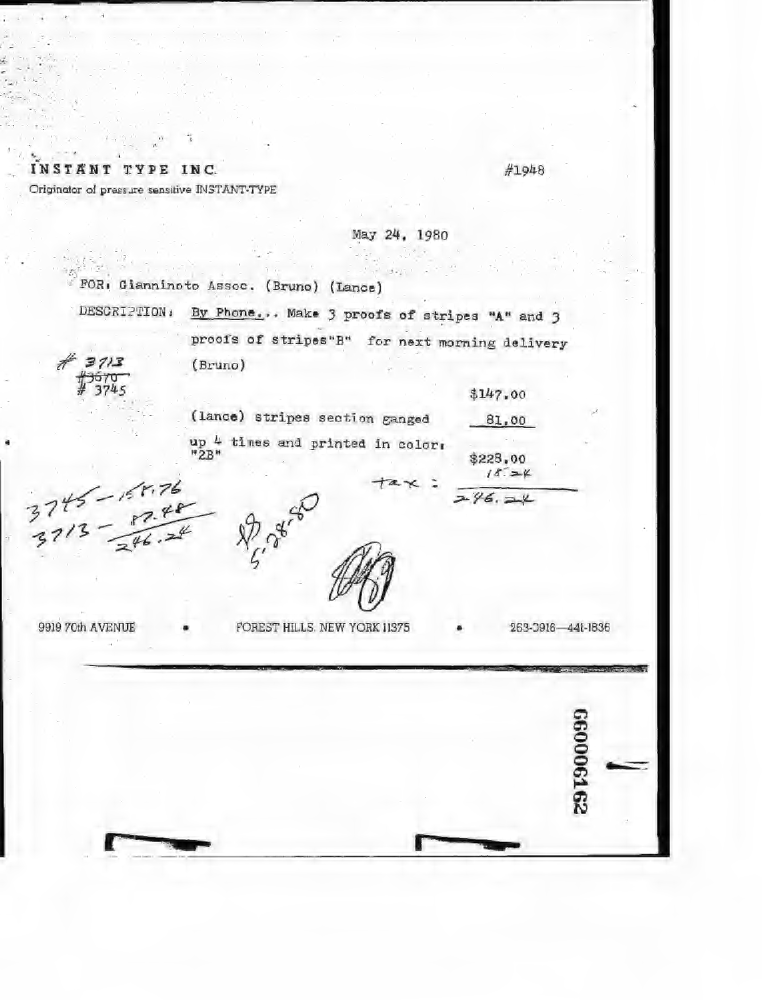

In [ ]:
#Wavelet

import cv2
import pywt
import numpy as np
import matplotlib.pyplot as plt

# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif', cv2.IMREAD_GRAYSCALE)

# Wavelet function and decomposition level
wavelet_function = 'coif1'  # Example: Daubechies 1
decomposition_level = 900

# Perform wavelet decomposition using PyWavelets
coeffs = pywt.wavedec2(image, wavelet_function, level=decomposition_level)

# Thresholding function (soft thresholding)
def thresholding(coeffs, threshold):
    def soft_thresholding(x, thresh):
        return np.sign(x) * np.maximum(np.abs(x) - thresh, 0)

    thresholded_coeffs = [coeffs[0]]  # Approximation coefficients are not thresholded
    for detail_level in coeffs[1:]:
        cH, cV, cD = detail_level
        cH = soft_thresholding(cH, threshold)
        cV = soft_thresholding(cV, threshold)
        cD = soft_thresholding(cD, threshold)
        thresholded_coeffs.append((cH, cV, cD))

    return thresholded_coeffs

# Apply thresholding
threshold = 40  # Adjust threshold value as needed
thresholded_coeffs = thresholding(coeffs, threshold)

# Reconstruct the image from thresholded coefficients
denoised_image = pywt.waverec2(thresholded_coeffs, wavelet_function)

# Clip values to valid range
denoised_image = np.clip(denoised_image, 0, 255)

# Convert to uint8
denoised_image = denoised_image.astype(np.uint8)
denoised_image


array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
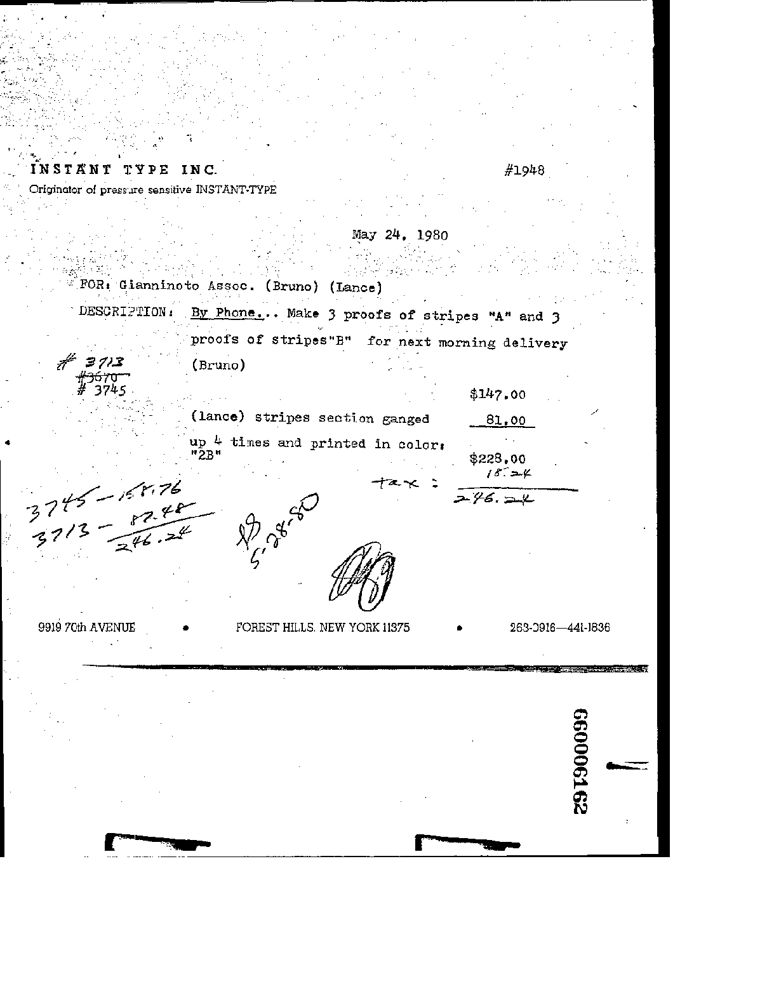

In [ ]:
cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif')

array([[  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       [  0,   0,   0, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
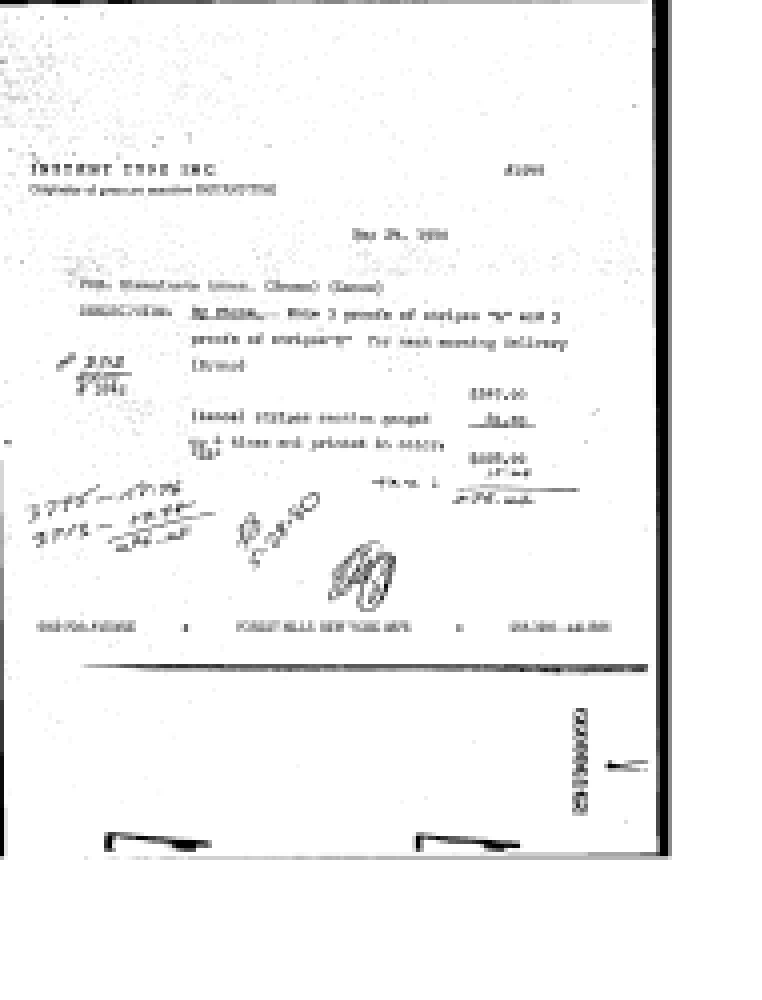

In [ ]:
import cv2
import pywt
import numpy as np
import matplotlib.pyplot as plt

# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif', cv2.IMREAD_GRAYSCALE)

# Wavelet function and decomposition level
wavelet_function = 'db1'  # Example: Daubechies 1
decomposition_level = 2

# Perform wavelet decomposition using PyWavelets
coeffs = pywt.wavedec2(image, wavelet_function, level=decomposition_level)

# Adaptive thresholding function
def adaptive_thresholding(x, global_thresh):
    local_thresh = global_thresh * (1 + 0.5 * np.var(x) / np.mean(np.abs(x)))
    return np.sign(x) * np.maximum(np.abs(x) - local_thresh, 0)

def thresholding(coeffs, threshold):
    thresholded_coeffs = [coeffs[0]]  # Approximation coefficients are not thresholded
    for detail_level in coeffs[1:]:
        cH, cV, cD = detail_level
        cH = adaptive_thresholding(cH, threshold)
        cV = adaptive_thresholding(cV, threshold)
        cD = adaptive_thresholding(cD, threshold)
        thresholded_coeffs.append((cH, cV, cD))
    return thresholded_coeffs

# Apply adaptive thresholding
threshold = 5  # Adjust threshold value as needed
thresholded_coeffs = thresholding(coeffs, threshold)

# Reconstruct the image from thresholded coefficients
denoised_image = pywt.waverec2(thresholded_coeffs, wavelet_function)

# Clip values to valid range
denoised_image = np.clip(denoised_image, 0, 255)

# Convert to uint8
denoised_image = denoised_image.astype(np.uint8)
denoised_image


/usr/local/lib/python3.10/dist-packages/pywt/_multilevel.py:43: UserWarning: Level value of 1000 is too high: all coefficients will experience boundary effects.
  warnings.warn(


True

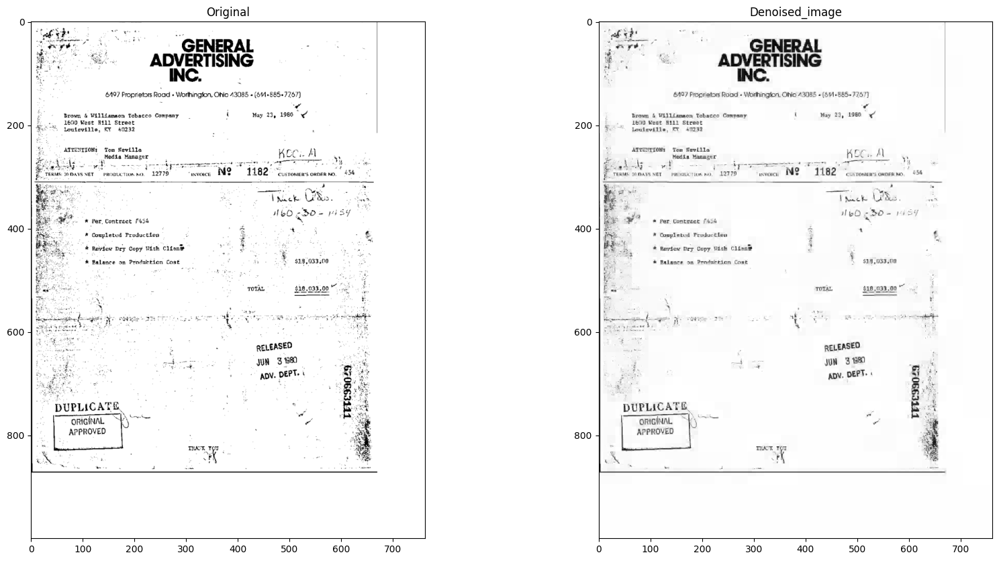

In [ ]:
#Working - Wavelet with binary threshold

import cv2
import pywt
import numpy as np
import matplotlib.pyplot as plt

# Read the image
org_image = cv2.imread('/content/drive/MyDrive/Datasets/0000442735.tif', cv2.IMREAD_GRAYSCALE)

# Wavelet function and decomposition level
wavelet_function = 'db1'  # Example: Daubechies 1
decomposition_level = 1000
image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=20, searchWindowSize=60)

# Perform wavelet decomposition using PyWavelets
coeffs = pywt.wavedec2(image, wavelet_function, level=decomposition_level)

# Thresholding function (soft thresholding)
def thresholding(coeffs, threshold):
    def soft_thresholding(x, thresh):
        return np.sign(x) * np.maximum(np.abs(x) - thresh, 0)

    thresholded_coeffs = [coeffs[0]]  # Approximation coefficients are not thresholded
    for detail_level in coeffs[1:]:
        cH, cV, cD = detail_level
        cH = soft_thresholding(cH, threshold)
        cV = soft_thresholding(cV, threshold)
        cD = soft_thresholding(cD, threshold)
        thresholded_coeffs.append((cH, cV, cD))

    return thresholded_coeffs

# Apply thresholding
threshold = 50  # Adjust threshold value as needed
thresholded_coeffs = thresholding(coeffs, threshold)
#_, denoised_image = cv2.threshold(image,980, 555, cv2.THRESH_BINARY)

# Reconstruct the image from thresholded coefficients
denoised_image = pywt.waverec2(thresholded_coeffs, wavelet_function)
# Clip values to valid range
denoised_image = np.clip(denoised_image, 0, 255)

# Convert to uint8
denoised_image = denoised_image.astype(np.uint8)
#_, denoised__image = cv2.threshold(denoised_image, 20, 255, cv2.THRESH_TRUNC)


plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_wavelet.jpg',denoised_image)

In [ ]:
output_path = '/content/drive/MyDrive/Datasets/denoised_image.jpg'  # Change this path as needed
cv2.imwrite(output_path, denoised_image)

True

In [ ]:
#Accuracy

import cv2
import numpy as np
from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error

def calculate_psnr(original, denoised):
    return peak_signal_noise_ratio(original, denoised)

def calculate_ssim(original, denoised):
    return structural_similarity(original, denoised, full=False)

def calculate_mse(original, denoised):
    return mean_squared_error(original, denoised)

# Load the original (ground truth) and denoised images
original = cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif', cv2.IMREAD_GRAYSCALE)
denoised = cv2.imread('/content/drive/MyDrive/Datasets/denoised_image_bilateral.jpg', cv2.IMREAD_GRAYSCALE)

# Ensure the images are loaded correctly
if original is None or denoised is None:
    raise ValueError("Error loading images. Check the file paths.")

# Calculate PSNR
psnr_value = calculate_psnr(original, denoised)
print(f'PSNR: {psnr_value} dB')

# Calculate SSIM
ssim_value = calculate_ssim(original, denoised)
print(f'SSIM: {ssim_value}')

# Calculate MSE
mse_value = calculate_mse(original, denoised)
print(f'MSE: {mse_value}')


PSNR: 30.30108254142789 dB
SSIM: 0.9332222948043476
MSE: 60.669736220472444


In [ ]:
# Total Variation denoising

import cv2
import matplotlib.pyplot as plt
from skimage.restoration import denoise_tv_chambolle

# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif', cv2.IMREAD_GRAYSCALE)

# Apply Total Variation Denoising
denoised_image = denoise_tv_chambolle(image, weight=0.12, multichannel=False)
denoised_image = cv2.fastNlMeansDenoising(denoised_image, None, h=10, templateWindowSize=7, searchWindowSize=21)

# Scale the denoised image to the range [0, 255]
denoised_image = (denoised_image * 255).astype(np.uint8)
denoised_image


<ipython-input-17-928335671345>:11: FutureWarning: `multichannel` is a deprecated argument name for `denoise_tv_chambolle`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoised_image = denoise_tv_chambolle(image, weight=0.12, multichannel=False)


error: OpenCV(4.8.0) /io/opencv/modules/photo/src/denoising.cpp:141: error: (-5:Bad argument) Unsupported depth! Only CV_8U is supported for NORM_L2 in function 'fastNlMeansDenoising'


In [ ]:
output_path = '/content/drive/MyDrive/Datasets/denoised_image_bilateral.jpg'
cv2.imwrite(output_path, denoised_image_bilateral)

True

True

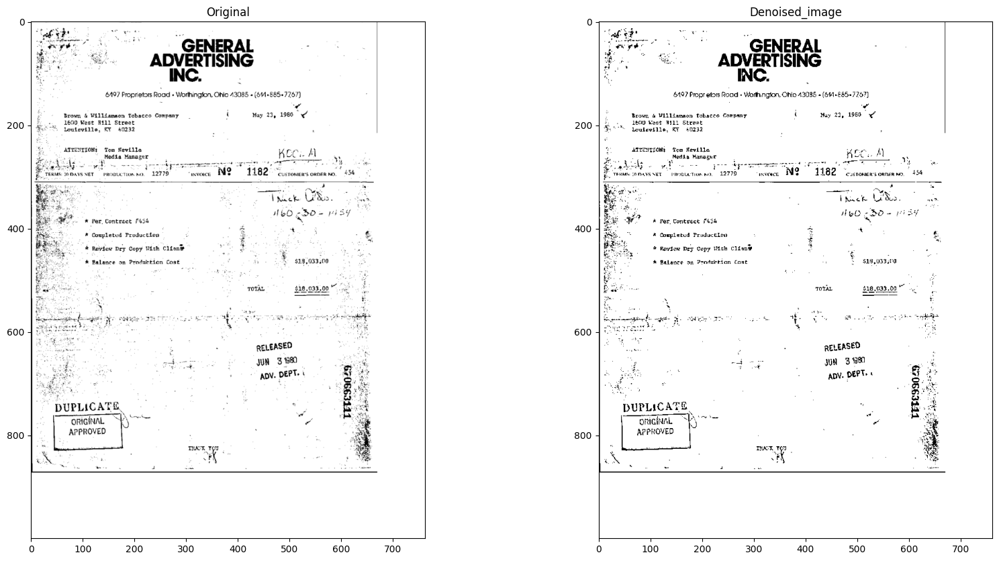

In [ ]:
# Bilateral filtering

import cv2
import matplotlib.pyplot as plt

# Read the image
org_image = cv2.imread('/content/drive/MyDrive/Datasets/0000442735.tif', cv2.IMREAD_GRAYSCALE)

# Apply Bilateral Filtering

image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=7, searchWindowSize=41)
denoised_image = cv2.bilateralFilter(image, d=15, sigmaColor=75, sigmaSpace=75)
denoised_image = cv2.adaptiveThreshold(denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 19, 25)



#_, denoised_image_bilateral = cv2.threshold(denoised_image_bilateral, 25, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_bilateral.jpg',denoised_image)



True

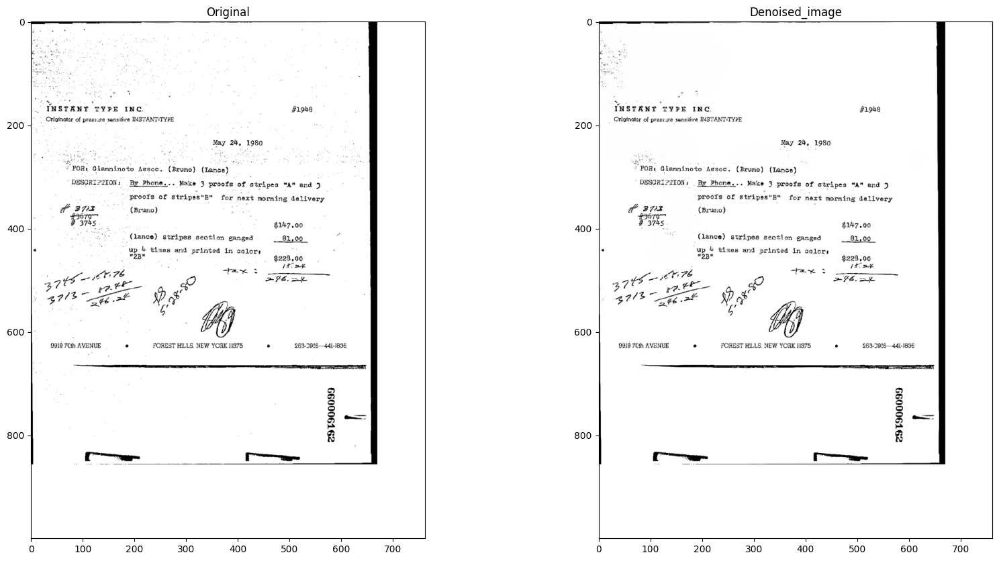

In [ ]:
#Anisotropic diffusion

import numpy as np
import cv2
import matplotlib.pyplot as plt

def anisotropic_diffusion(image, iterations, kappa, gamma,option):
    image = image.astype('float32')

    if option == 1:
        image = cv2.GaussianBlur(image, (1, 1), 0)
    elif option == 2:
        image = cv2.medianBlur(image.astype(np.uint8), 3)

    # Pad the image to handle border cases
    image_padded = np.pad(image, ((1, 1), (1, 1)), mode='constant')

    for i in range(iterations):
        # Compute gradients
        nablaN = image_padded[:-2, 1:-1] - image_padded[1:-1, 1:-1]
        nablaS = image_padded[2:, 1:-1] - image_padded[1:-1, 1:-1]
        nablaW = image_padded[1:-1, :-2] - image_padded[1:-1, 1:-1]
        nablaE = image_padded[1:-1, 2:] - image_padded[1:-1, 1:-1]

        # Conductance
        cN = np.exp(-(nablaN / kappa) ** 2)
        cS = np.exp(-(nablaS / kappa) ** 2)
        cW = np.exp(-(nablaW / kappa) ** 2)
        cE = np.exp(-(nablaE / kappa) ** 2)

        # Update image
        image_update = image_padded[1:-1, 1:-1] + gamma * (
            cN * nablaN + cS * nablaS + cW * nablaW + cE * nablaE
        )

        # Update padded image
        image_padded[1:-1, 1:-1] = image_update

    return image_padded[1:-1, 1:-1]

# Example usage (replace 'your_image.jpg' with your image path)
org_image = cv2.imread('/content/drive/MyDrive/Datasets/0000113725.tif', 0)  # Read as grayscale
image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=20, searchWindowSize=100)

denoised_image = anisotropic_diffusion(image, iterations=30, kappa=20, gamma=0.2,option=1)
#_, denoised_image = cv2.threshold(denoised_image, 127, 255, cv2.THRESH_BINARY)
#denoised_image = cv2.equalizeHist(denoised_image)
kernel = np.ones((1, 1), np.uint8)
denoised_image = cv2.morphologyEx(denoised_image, cv2.MORPH_CLOSE, kernel)
plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_image_aniso.jpg',denoised_image)


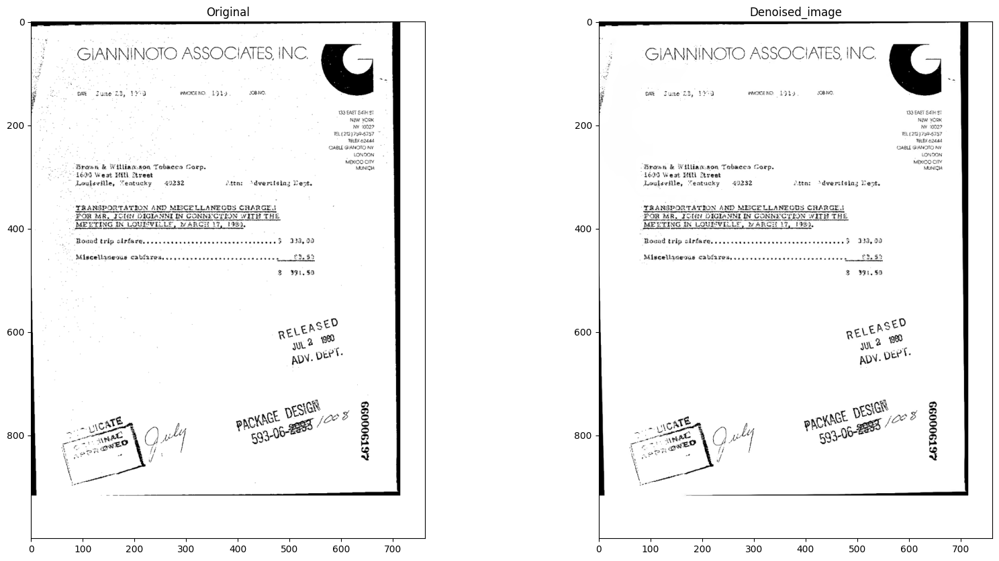

In [ ]:
plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

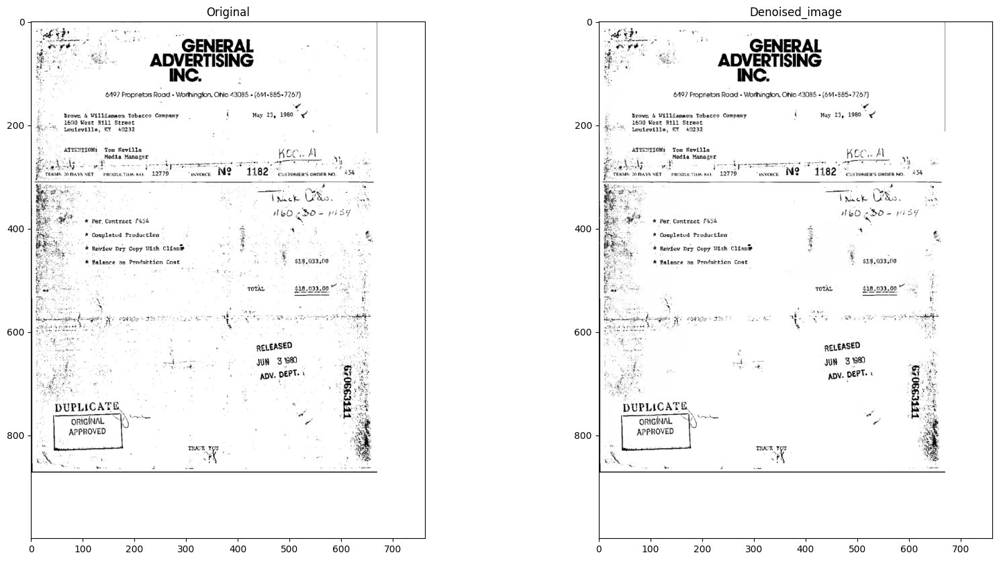

In [ ]:
plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

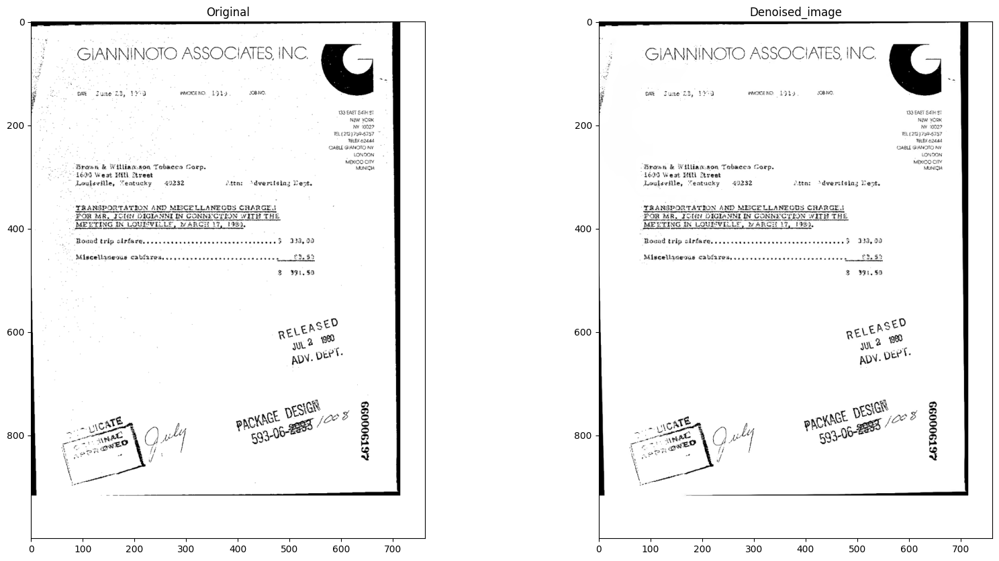

In [ ]:
plt.figure(figsize=(20, 10))  # Adjust width and height as desired
plt.subplot(1,2,1)
plt.title('Original')
plt.imshow(org_image,cmap='gray')

plt.subplot(1,2,2)
plt.title('Denoised_image')
plt.imshow(denoised_image,cmap='gray')

(-0.5, 761.5, 999.5, -0.5)

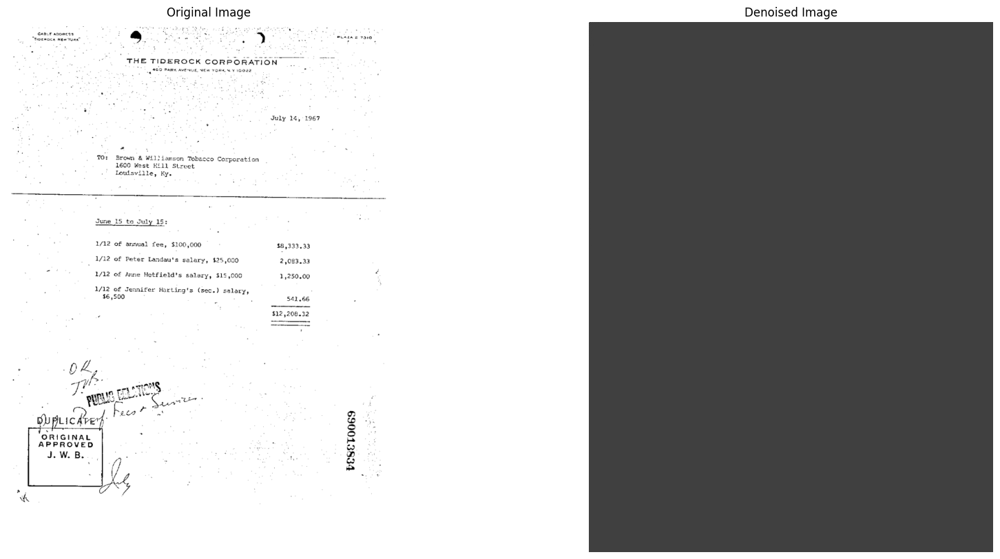

In [ ]:
import numpy as np
from scipy.fftpack import idct

def nsdct_transform(image):
    m, n = image.shape
    nsdct_image = np.zeros((m, n))

    for i in range(m):
        nsdct_image[i, :] = dct(image[i, :], norm='ortho')

    for j in range(n):
        nsdct_image[:, j] = dct(nsdct_image[:, j], norm='ortho')

    return nsdct_image


def nsdct_threshold(nsdct_image, sigma):
    thresholded_nsdct_image = np.where(np.abs(nsdct_image) < sigma, 0, nsdct_image)
    return thresholded_nsdct_image


def nsdct_inverse_transform(nsdct_image):
    m, n = nsdct_image.shape
    denoised_image = np.zeros((m, n))

    for i in range(m):
        denoised_image[i, :] = idct(nsdct_image[i, :], norm='ortho')

    for j in range(n):
        denoised_image[:, j] = idct(denoised_image[:, j], norm='ortho')

    return denoised_image


# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000333214.tif', 0)  # Read as grayscale

# Perform NSDCT transformation
nsdct_image = nsdct_transform(image)

# Apply thresholding
sigma = 20  # Adjust sigma according to noise level
thresholded_nsdct_image = nsdct_threshold(nsdct_image, sigma=sigma)

# Reconstruct the denoised image
denoised_image = nsdct_inverse_transform(thresholded_nsdct_image)

# Plot original and denoised images side by side
plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Denoised Image")
plt.imshow(denoised_image, cmap='gray')
plt.axis('off')


In [ ]:
!pip install nsdct

ERROR: Could not find a version that satisfies the requirement nsdct (from versions: none)
ERROR: No matching distribution found for nsdct


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_dict_learning.py:213: RuntimeWarning: Orthogonal matching pursuit ended prematurely due to linear dependence in the dictionary. The requested precision might not have been met.
  new_code = orthogonal_mp_gram(


(-0.5, 761.5, 999.5, -0.5)

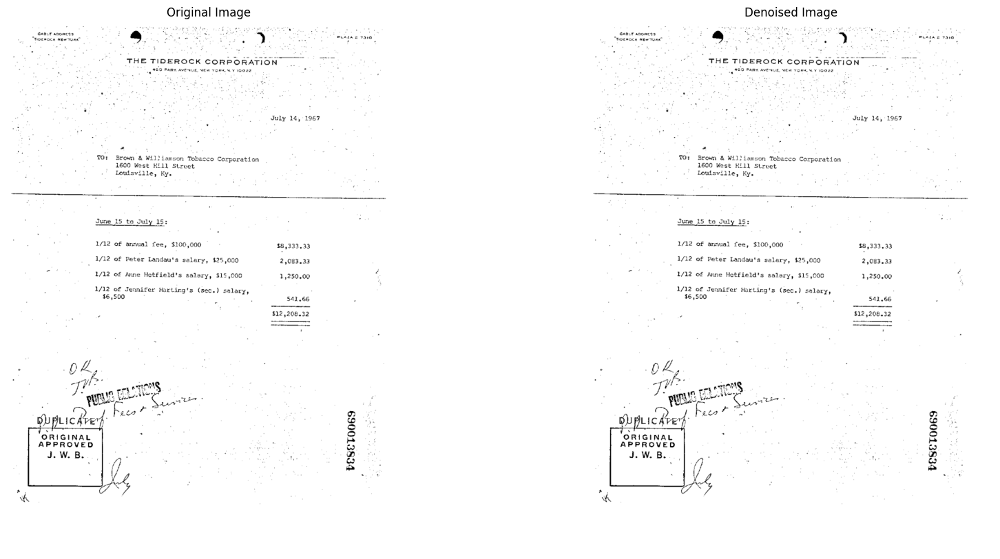

In [ ]:
# Dictionary Learning


import cv2
import numpy as np
from sklearn.decomposition import DictionaryLearning

# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000333214.tif', 0)  # Read as grayscale

# Flatten the image into a 1D array
X = image.reshape(-1, 1)

# Define the number of atoms (dictionary elements)
n_atoms = 250

# Perform dictionary learning
dl = DictionaryLearning(n_components=n_atoms)
dl.fit(X)

# Get the learned dictionary
dictionary = dl.components_

# Sparse representation
sparse_code = dl.transform(X)

# Reconstruct the image using the sparse code and dictionary
reconstructed_image = np.dot(sparse_code, dictionary)

# Reshape the reconstructed image to its original shape
reconstructed_image = reconstructed_image.reshape(image.shape)

# Plot original and denoised images side by side
plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Denoised Image")
plt.imshow(reconstructed_image, cmap='gray')
plt.axis('off')


(-0.5, 761.5, 999.5, -0.5)

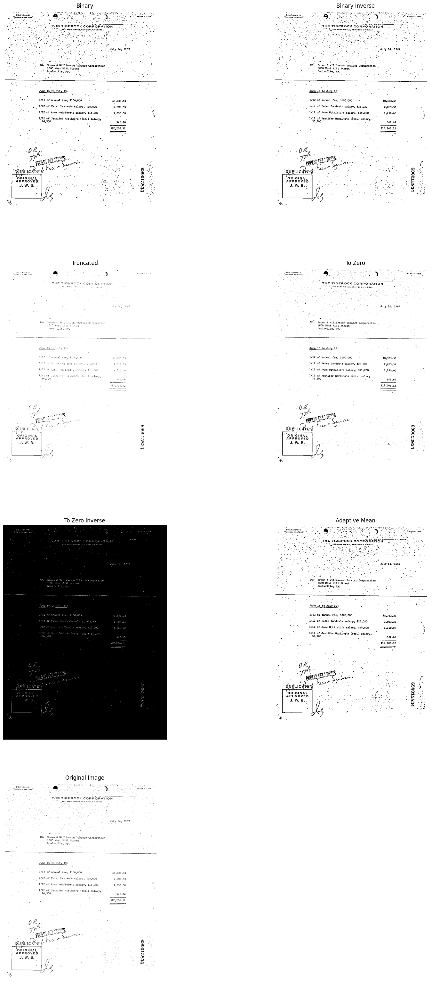

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read the image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000333214.tif', cv2.IMREAD_GRAYSCALE)

# Thresholding methods
methods = [
    ("Binary", cv2.THRESH_BINARY),
    ("Binary Inverse", cv2.THRESH_BINARY_INV),
    ("Truncated", cv2.THRESH_TRUNC),
    ("To Zero", cv2.THRESH_TOZERO),
    ("To Zero Inverse", cv2.THRESH_TOZERO_INV),
    ("Adaptive Mean", cv2.ADAPTIVE_THRESH_MEAN_C),
    ("Adaptive Gaussian", cv2.ADAPTIVE_THRESH_GAUSSIAN_C)
]

# Apply each thresholding method
plt.figure(figsize=(20, 40))
for i, (name, method) in enumerate(methods, 1):
    if method in {cv2.ADAPTIVE_THRESH_MEAN_C, cv2.ADAPTIVE_THRESH_GAUSSIAN_C}:
        # Adaptive thresholding requires additional parameters
        thresholded_image = cv2.adaptiveThreshold(image, 255, method, cv2.THRESH_BINARY, 11, 2)
    else:
        _, thresholded_image = cv2.threshold(image, 127, 255, method)
    plt.subplot(4, 2, i)
    plt.imshow(thresholded_image, cmap='gray')
    plt.title(name)
    plt.axis('off')

# Original image
plt.subplot(4, 2, 7)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
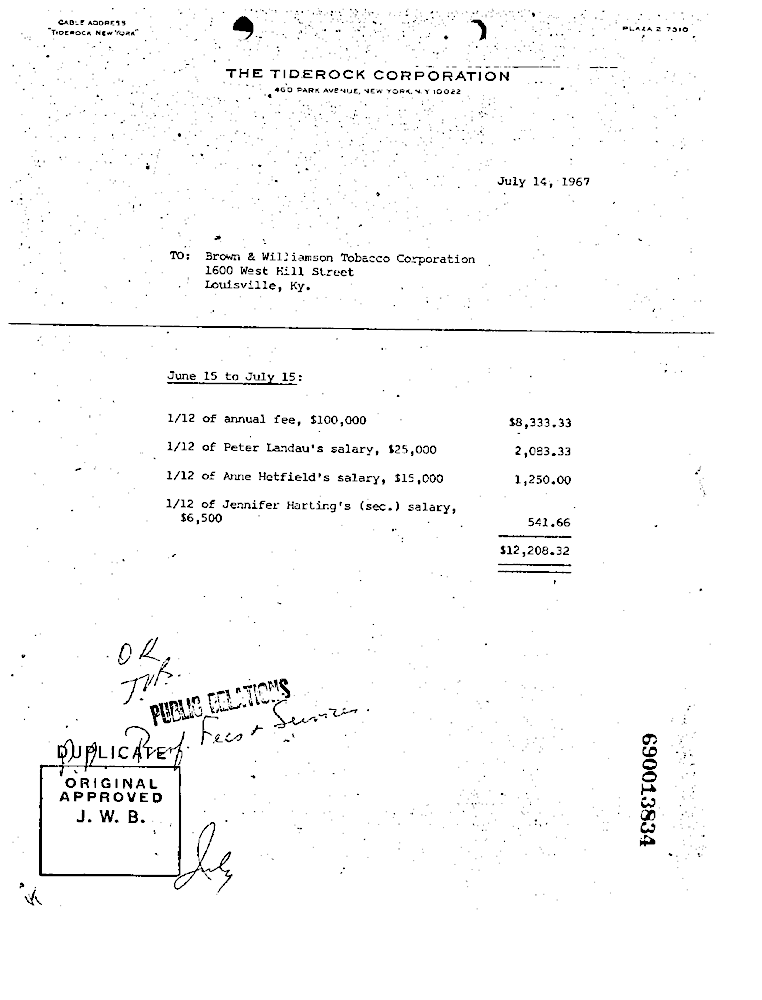

In [ ]:
image=cv2.imread('/content/drive/MyDrive/Datasets/0000333214.tif')
_, de_img = cv2.threshold(image, 127, 255, cv2.THRESH_TOZERO)
de_img

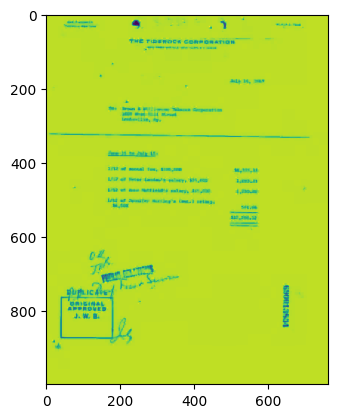

In [ ]:
# Historical Document denoising

import cv2
import numpy as np
from skimage.restoration import denoise_tv_chambolle, denoise_wavelet

# Read the historical document image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000333214.tif', cv2.IMREAD_GRAYSCALE)

# Perform denoising using OpenCV's fastNlMeansDenoising function
denoised_fastnl = cv2.fastNlMeansDenoising(image, h=10, templateWindowSize=20, searchWindowSize=51)

# Perform denoising using Total Variation (TV) denoising
denoised_tv = denoise_tv_chambolle(denoised_fastnl, weight=0.1)

# Perform denoising using Wavelet denoising
denoised_wavelet = denoise_wavelet(denoised_tv, sigma=0.1)

# Display the original and denoised images
plt.imshow(denoised_wavelet)


OCR Testing


In [ ]:
!pip install pytesseract

In [ ]:
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 3s (1,772 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [ ]:
!tesseract -v

tesseract 4.1.1
 leptonica-1.82.0
  libgif 5.1.9 : libjpeg 8d (libjpeg-turbo 2.1.1) : libpng 1.6.37 : libtiff 4.3.0 : zlib 1.2.11 : libwebp 1.2.2 : libopenjp2 2.4.0
 Found AVX2
 Found AVX
 Found FMA
 Found SSE
 Found libarchive 3.6.0 zlib/1.2.11 liblzma/5.2.5 bz2lib/1.0.8 liblz4/1.9.3 libzstd/1.4.8


In [ ]:
!which tesseract

/usr/bin/tesseract


In [ ]:
import pytesseract
import shutil
import os
import random
try:
 from PIL import Image
except ImportError:
 import Image

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/0000442735.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

 

“GENERAL .
ADVERTISING
INC.

6197 Proprietors Road « Worthinglon, Ohio 43085 « (611+885+7267)

<
Brown & Willdanson Tobacco Company i May 23, 1960
1600 West E11 Strect
loutevitle, KF 40232

 

 

S| asrexrtow tom revttte ar
£ iat Kec. A
Polk. abe meee joe

TERMS. 20 DAYS NET PRODUCTION NO. 127

 

 

woes M2 1182" “ciouensommano. | 454

   

 

    
  
   

© # Per. Contrect F454

 

* Completed Production

a

 

4 neindew ney Copy Wich chtan

# Balance on Produttion Cost * $28,033.00

 

roth

 

   

     
 

a ab, 28: a
y
RELEASED
+ qn 3880
ADV. DEPT.
ORIGINAL "¢
APPROVED
muck rg
. a

 

 

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_image_aniso.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))

print(extractedInformation)

 

 

GENERAL
ADVERTISING
INC.

6197 Proprietors Road « Worthinglon, Ohic 43085 « (614-885+7267)

 

 

<
Brown & Williamson Tebacco Company i May 23, 1980
Uoctevilie, FY AS
© ARNEATEON) on Fevttte ikGee ih
< Media Manager Koc. Al 3
gael. i weer eee TR re
Fite pooner" noaiciwnia 1182 ucournsonnanve 454

 

 

* Per. Contract 1456

 

 

 

        

 

   
    

© caepietiat Pewnctton 3 + £
Review Dey Copy With clian® y g
‘* Balance on Produttion Cost s $19,033.00
roth, e 4
< :
\ .
- wm ab oe -
> gag ok 3
: 4 :
' RELEASED
ate nan JUN 3 1980
7 Apv. DEPT. « g5
B :
ORIGINAL aS *

 
 

  

APPROVED

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_bilateral.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))

print(extractedInformation)

GENERAL
ADVERTISING
INC.

6197 Proprietors Road + Worthinglon, Ohio “3085 « (511-885+7767)

<
1960

 

 

Brown & Williamson Tobaces Company ‘ May
1600 West W111 Street
Youleville, KF 40232

ATTENTION: Tom Revi1le
Media Manager

       

 

 

 

 

aide - ot a ere
FF reluws opays wer proouction sn 12779 ssvoner 182 cusromewsonnrmno 54
Vac LR:
HeO -B0-+
* ver. Conteect 7456
‘
ee Ty : t

4 Review Dey Copy Wish Chins

   

& Balance on Produttion cost 538,033.00

 

   

   

 

     
  
 

BS ‘rors a
:
” a 2
RELEASED i
j Jun 3 1880 ‘
ADV. DEPT: « : 2
TR a &
DUPLICATE fh 8
ORIGINAL ~\°) 7 © mI
APPROVED = [~
TUCK Te
& ‘

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_wavelet.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))

print(extractedInformation)

 

 

 

 

  

  

 

 

 

    

   

     
 
  

(6497 Proprietors Road » Worlhingion. Ohic 43085 « (511-885-7767)
«
row & FLILimaon Tobacco Company aay 23, 1980
Lu, Teta weet ALT Street
2% Loalevttley RY A232
AtTeITTOW Tow RevLita a
Gimain. Kec. A,
Benady - =f! -4-— esr 4
Fl reas sonays ser pmaucrion 12779 wvoce WP 1182 “cosrowers canes, 158
a * Treck Likes —
3
i a EO gBO= Vi
Bop + re coum 44 <i iil
AY © Completud Prductton 3 - t
ee : i ‘
peeks @ Revdew Dry Copy With Clinai ‘ “
‘ ‘* Balance on Produrtion Cost: ¥ $38,033.00
roth. $18,033.00 ~ f
x :
see 2 te 2 aoe
\ :
RELEASED
bg JN 3880
apy. DEPT. «
DUPLICATE.
ORIGINAL, i "2
APPROVED
maT Ts

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_pca.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))

print(extractedInformation)

 

 

GENERAL
ADVERTISING
INC.

6107 Propr etors Road + ‘Northingion, Ohio 43085 « (564-£85+7257)

 

”
Brown & Williamson Tobaces Company a May 23, 1980
eo Kost AML! Street
Ubateet ile, RF 40232

$: aavenvOM ton nevttto sre

Neste Manager Koc. AL

 

a yy

 

    
   

wg. ant sped

SIDDAYS NET" bmaueTion ee, 12779

    

hak NG? 1182 “cscaxnsconesse 58

Taek EBs. ads
HeO dO- 7

 

* Per. Contrect 1636

 

4 «
4% completud Pruduceten F t
# Roviow Dey Copy Tish cltas® é f
‘* Balance on Produrtion Cost 5 818,033.00

Tota $18,033.00 7

 

 

 

     

z ‘ ‘
: N
RELEASED
od JN 3 960 +

apy. DEPT. «

 

Frtess029.

 
 

  
  
 

ORIGINAL
APPROVED

 

   



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_fractal.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

 

 

 

GENERAL
ADVERTISING
INC. .

6197 Proprietors Road « Worhingion, Ohio 42085 « (81+885+7767)

 

   
   
     
   
 

     

 

¢
Brown & Williamson Tobacco Company May 25, 1980
100 West BILD Street
Voutevitie, RY 40232
ATTENTION: Tom FevLlle .
hedia Manager Ken. Al
t oes see —" a
wf. ---- poppe eee a 4
mnioucTion n03. 12778 wwe M2 1182 “coctouces oaoennn | 454
4 =
= a
\nack Li's me
HOO gBO- 1

 

‘* Per. Contract P44

 

4

* Completed Production

 

# Review Dey Copy With Clisn®

 

   

& Balance on Produttien Cost * 318,033,00
roth sin.ox.00
:
of 8 sate
y
i RELEASED
ahect Jun 3880
apy. DEPT: «

  

‘ORIGINAL
APPROVED

         



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/denoised_ica.jpg'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

PCA

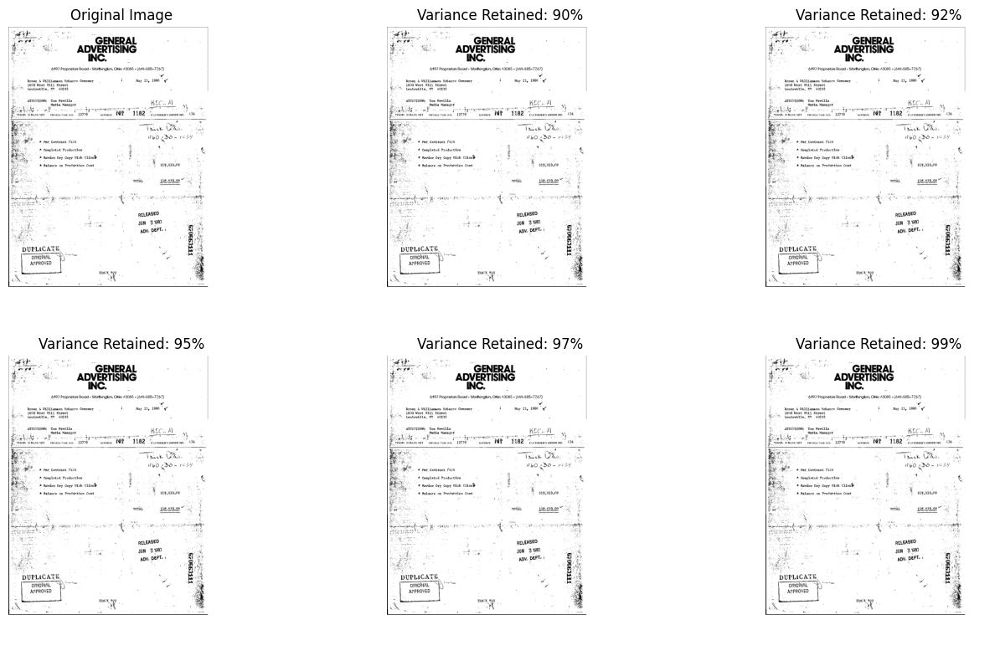

In [ ]:
import cv2
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def pca_denoising(image, variance_retained=0.95):
    # Convert image to float32 for PCA
    image_float32 = np.float32(image)

    # Flatten the image into a 1D array
    X = image_float32.flatten()

    # Perform PCA on the flattened image
    pca = PCA(n_components=variance_retained)
    pca.fit(X.reshape(-1, 1))

    # Project the noisy image onto the principal components
    projected_image = pca.transform(X.reshape(-1, 1))

    # Reconstruct the image using the reduced number of principal components
    reconstructed_image = pca.inverse_transform(projected_image).reshape(image.shape)

    # Convert reconstructed image back to uint8
    denoised_image = np.uint8(np.clip(reconstructed_image, 0, 255))

    return denoised_image

# Read the noisy text image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000442735.tif', cv2.IMREAD_GRAYSCALE)

# Define a list of variance levels to test
variance_levels = [0.90, 0.92, 0.95, 0.97, 0.99]

# Plot the original and denoised images
plt.figure(figsize=(15, 8))

# Plot original image
plt.subplot(2, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

# Loop through each variance level and denoise the image
for i, variance in enumerate(variance_levels, start=2):
    # Denoise the image using PCA with the current variance level
    denoised_image = pca_denoising(image, variance)

    # Plot denoised image
    plt.subplot(2, 3, i)
    plt.imshow(denoised_image, cmap='gray')
    plt.title(f'Variance Retained: {variance*100:.0f}%')
    plt.axis('off')

plt.tight_layout()
plt.show()


True

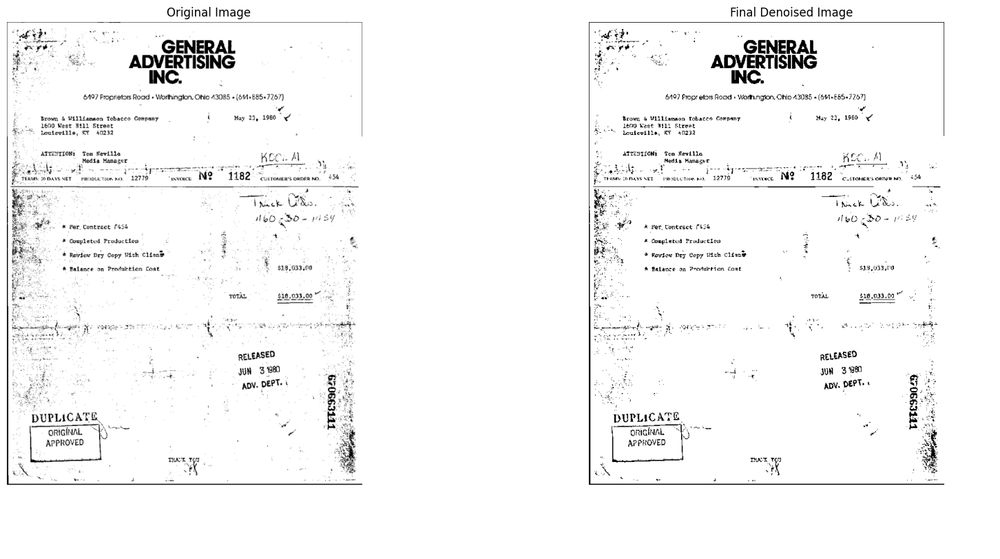

In [ ]:
import cv2
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def pca_denoising(image, variance_retained=0.95):
    # Convert image to float32 for PCA
    image_float32 = np.float32(image)

    # Flatten the image into a 1D array
    X = image_float32.flatten()

    # Perform PCA on the flattened image
    pca = PCA(n_components=variance_retained)
    pca.fit(X.reshape(-1, 1))

    # Project the noisy image onto the principal components
    projected_image = pca.transform(X.reshape(-1, 1))

    # Reconstruct the image using the reduced number of principal components
    reconstructed_image = pca.inverse_transform(projected_image).reshape(image.shape)

    # Convert reconstructed image back to uint8
    denoised_image = np.uint8(np.clip(reconstructed_image, 0, 255))

    return denoised_image

# Read the noisy text image
image = cv2.imread('/content/drive/MyDrive/Datasets/0000442735.tif', cv2.IMREAD_GRAYSCALE)

# Step 1: Apply Gaussian Blurring
blurred_image = cv2.GaussianBlur(image, (1, 1), 0)

# Step 2: Apply PCA Denoising
variance_retained = 0.15
pca_denoised_image = pca_denoising(blurred_image, variance_retained)

# Step 3: Apply Non-Local Means Denoising
final_denoised_image = cv2.fastNlMeansDenoising(pca_denoised_image, None, 10, 17, 60)
_, final_denoised_image = cv2.threshold(final_denoised_image, 127, 255, cv2.THRESH_BINARY)

# Display the original and denoised images
plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

'''plt.subplot(1, 3, 2)
plt.imshow(pca_denoised_image, cmap='gray')
plt.title('PCA Denoised Image')
plt.axis('off')'''

plt.subplot(1, 2, 2)
plt.imshow(final_denoised_image, cmap='gray')
plt.title('Final Denoised Image')
plt.axis('off')

cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_pca.jpg',final_denoised_image)


ICA Method

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:589: UserWarning: n_components is too large: it will be set to 25
  warnings.warn(


True

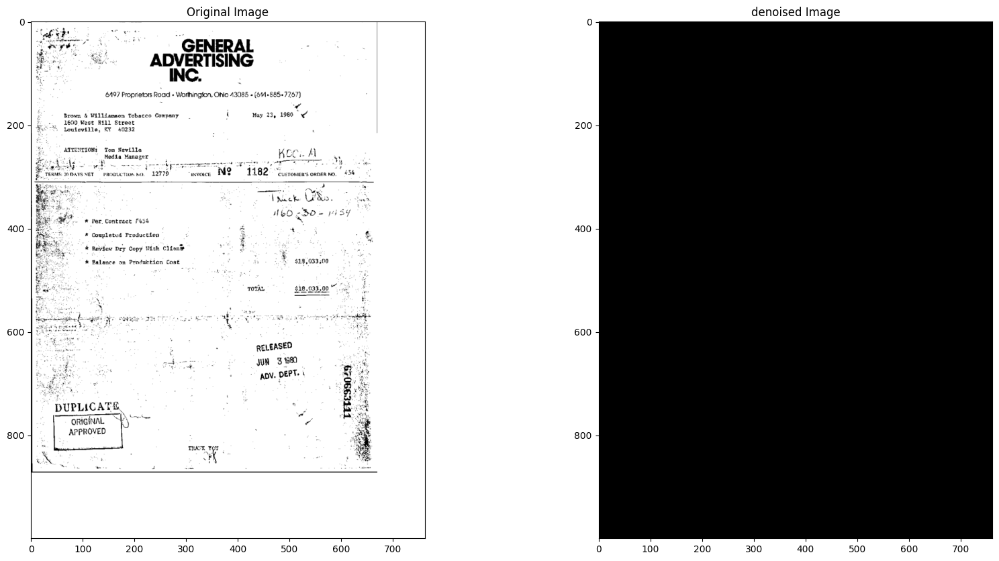

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from sklearn.decomposition import FastICA

# Load a single noisy image (modify the path as needed)
image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Normalize the image
noisy_image = image / 255.0
noisy_image = (noisy_image * 255).astype(np.uint8)
noisy_image = cv2.fastNlMeansDenoising(noisy_image, None, h=10, templateWindowSize=7, searchWindowSize=31)
noisy_image = cv2.bilateralFilter(noisy_image, d=9, sigmaColor=75, sigmaSpace=75)

# Function to extract patches from the image
def extract_patches(image, patch_size=(8, 8)):
    patches = []
    h, w = image.shape
    patch_h, patch_w = patch_size
    for i in range(0, h - patch_h + 1, patch_h):
        for j in range(0, w - patch_w + 1, patch_w):
            patch = image[i:i + patch_h, j:j + patch_w]
            patches.append(patch.flatten())
    return np.array(patches)

# Extract patches from the noisy image
patch_size = (5, 5)
patches = extract_patches(noisy_image, patch_size)

# Apply ICA to the patches
ica = FastICA(n_components=patches.shape[0], random_state=0)
S_ = ica.fit_transform(patches)  # Reconstruct signals
A_ = ica.mixing_  # Get estimated mixing matrix

# Reconstruct the original patches
reconstructed_patches = np.dot(S_, A_.T)
reconstructed_patches = reconstructed_patches.reshape(-1, patch_size[0], patch_size[1])

# Function to reconstruct the image from patches
def reconstruct_image(patches, image_size, patch_size=(8, 8)):
    h, w = image_size
    patch_h, patch_w = patch_size
    reconstructed_image = np.zeros((h, w))
    patch_idx = 0
    for i in range(0, h - patch_h + 1, patch_h):
        for j in range(0, w - patch_w + 1, patch_w):
            reconstructed_image[i:i + patch_h, j:j + patch_w] = patches[patch_idx]
            patch_idx += 1
    return reconstructed_image

# Reconstruct the denoised image
reconstructed_image = reconstruct_image(reconstructed_patches, noisy_image.shape, patch_size)
_, reconstructed_image = cv2.threshold(reconstructed_image, 250, 255, cv2.THRESH_BINARY)

# Display the noisy image
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")

plt.subplot(1,2,2)
plt.imshow(reconstructed_image, cmap='gray')
plt.title("denoised Image")

import cv2
cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_ica.jpg',reconstructed_image)

Fractal Based Methods

<ipython-input-74-dcf305381782>:11: FutureWarning: `multichannel` is a deprecated argument name for `denoise_wavelet`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)


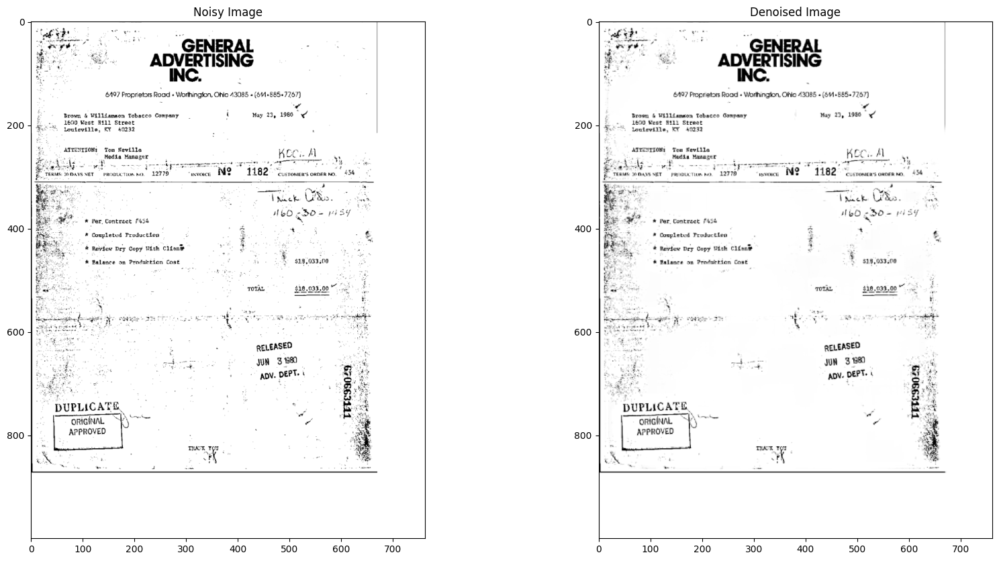

In [ ]:
import cv2
import numpy as np
from skimage import img_as_float
from skimage.restoration import denoise_wavelet

def fractal_denoise(image, level=480):
    # Convert image to float
    image = img_as_float(image)

    # Apply wavelet denoising as a proxy for fractal-based denoising
    denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)

    return denoised_image

def main():
    # Read the input image
    image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'  # Replace with your image path
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    denoised_image = cv2.fastNlMeansDenoising(image, None, 10, 37, 70)
    denoised_image = fractal_denoise(denoised_image, level=1)


    # Normalize the image for better visualization
    denoised_image = (255 * denoised_image).astype(np.uint8)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image, cmap='gray')
    plt.title("Noisy Image")

    plt.subplot(1, 2, 2)
    plt.imshow(denoised_image, cmap='gray')
    plt.title("Denoised Image")
    cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_fractal.jpg',denoised_image)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import numpy as np
from skimage import img_as_float
from skimage.restoration import denoise_wavelet

def fractal_denoise(image, level=480):
    # Convert image to float
    image = img_as_float(image)

    # Apply wavelet denoising as a proxy for fractal-based denoising
    denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)

    return denoised_image

def main():
    # Read the input image
    image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'  # Replace with your image path
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    denoised_image = cv2.fastNlMeansDenoising(image, None, 10, 37, 70)
    denoised_image = fractal_denoise(denoised_image, level=1)


    # Normalize the image for better visualization
    denoised_image = (255 * denoised_image).astype(np.uint8)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image, cmap='gray')
    plt.title("Noisy Image")

    plt.subplot(1, 2, 2)
    plt.imshow(denoised_image, cmap='gray')
    plt.title("Denoised Image")
    cv2.imwrite('/content/drive/MyDrive/Datasets/denoised_fractal.jpg',denoised_image)

if __name__ == "__main__":
    main()


**Total Variation**

<ipython-input-81-dfa95280ca8a>:14: FutureWarning: `multichannel` is a deprecated argument name for `denoise_tv_chambolle`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoised_image = denoise_tv_chambolle(image, weight=weight, multichannel=False)


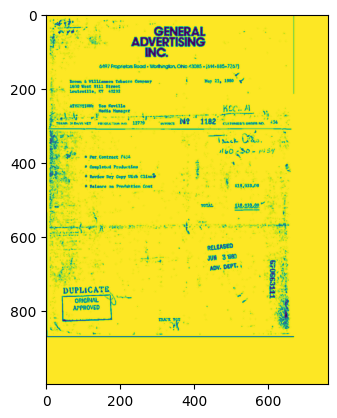

In [ ]:
import cv2
import numpy as np
from skimage.restoration import denoise_tv_chambolle

def total_variation_denoise(image_path, weight=0.08):

    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Convert image to float
    image = image.astype(np.float32) / 255.0

    # Apply Total Variation Denoising
    denoised_image = denoise_tv_chambolle(image, weight=weight, multichannel=False)

    # Convert back to 8-bit
    denoised_image = (denoised_image * 255).astype(np.uint8)
    plt.imshow(denoised_image)

if __name__ == "__main__":
    image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'
    total_variation_denoise(image_path)


**Wiener Filter**

<ipython-input-83-3da30942fabf>:8: RuntimeWarning: invalid value encountered in cast
  denoised_image = np.uint8(wiener_filtered_image)


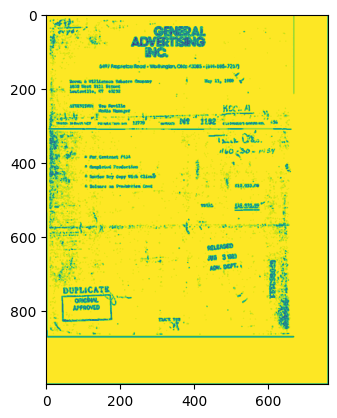

In [ ]:
import cv2
import numpy as np
from scipy.signal import wiener

def apply_wiener_filter(image_path, kernel_size=3):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    wiener_filtered_image = wiener(image, (kernel_size, kernel_size))
    denoised_image = np.uint8(wiener_filtered_image)
    plt.imshow(denoised_image)

if __name__ == "__main__":
    apply_wiener_filter('/content/drive/MyDrive/Datasets/0000442735.tif')


<ipython-input-120-e0cd0f9cd072>:13: FutureWarning: `multichannel` is a deprecated argument name for `denoise_wavelet`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)


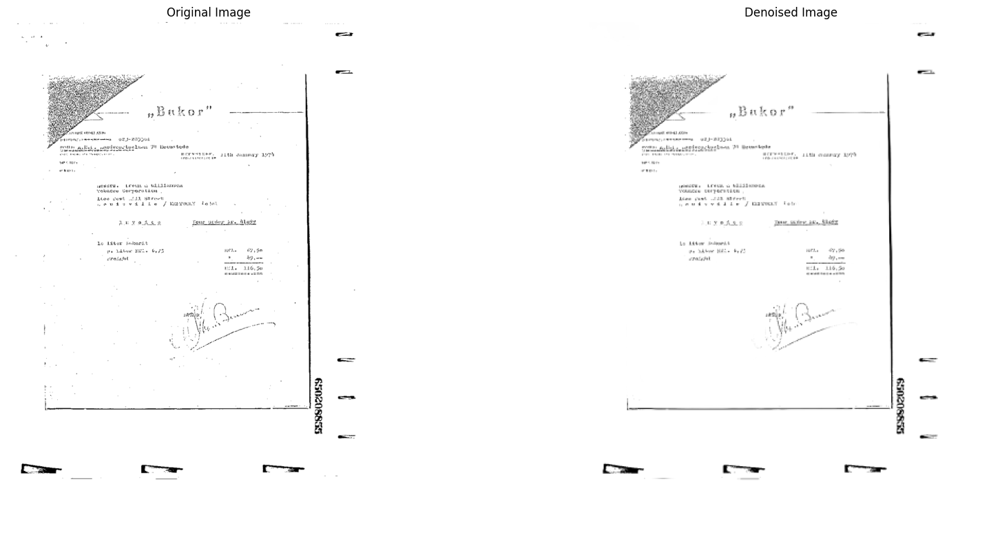

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_1.png


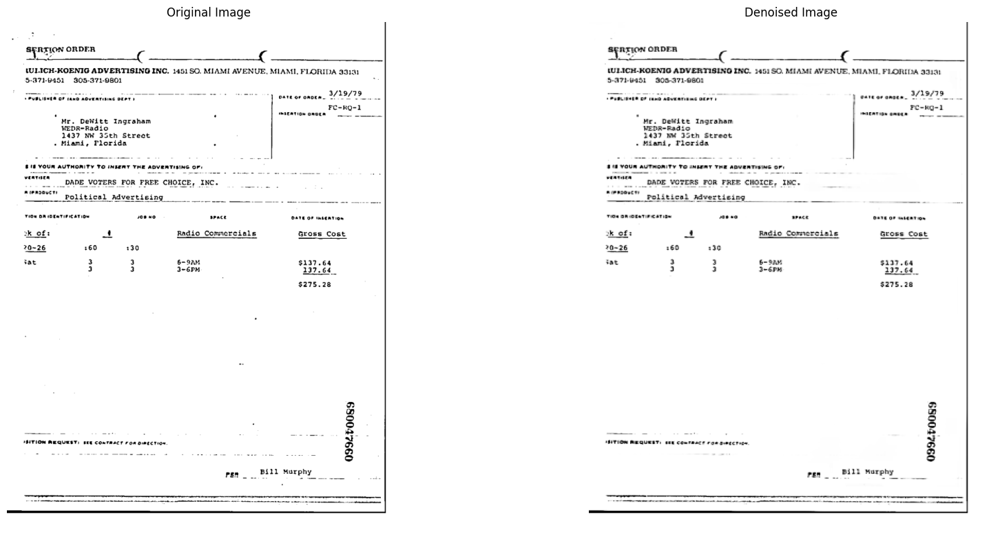

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_2.png


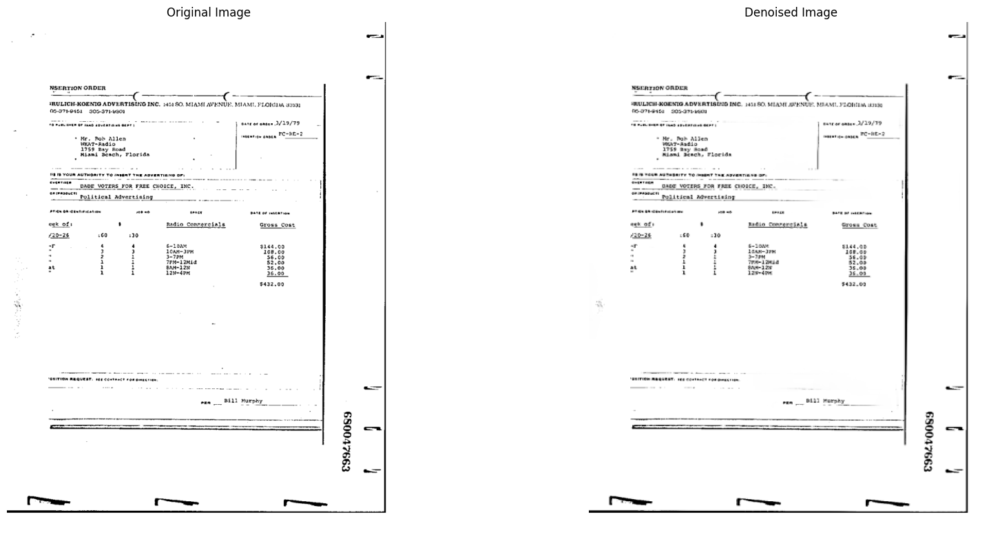

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_3.png


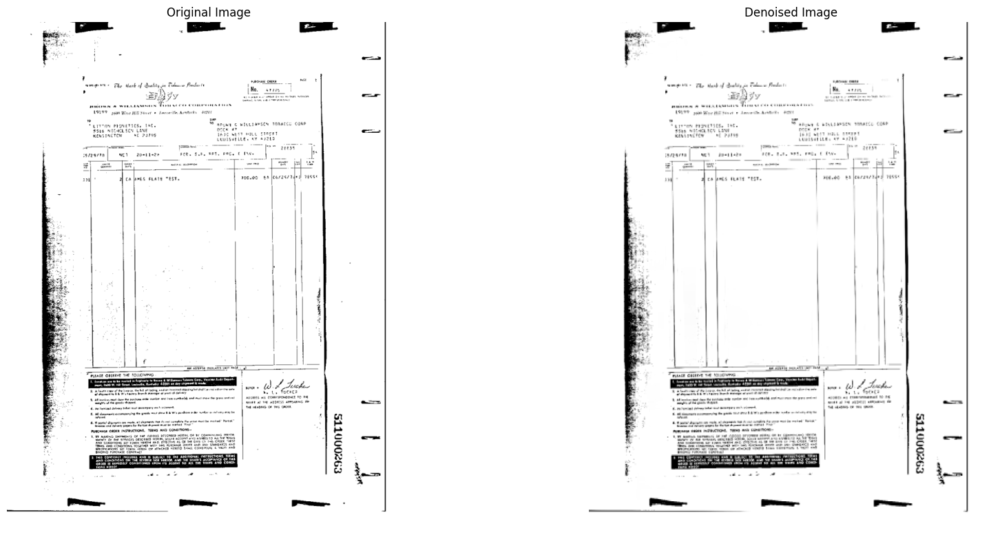

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_4.png


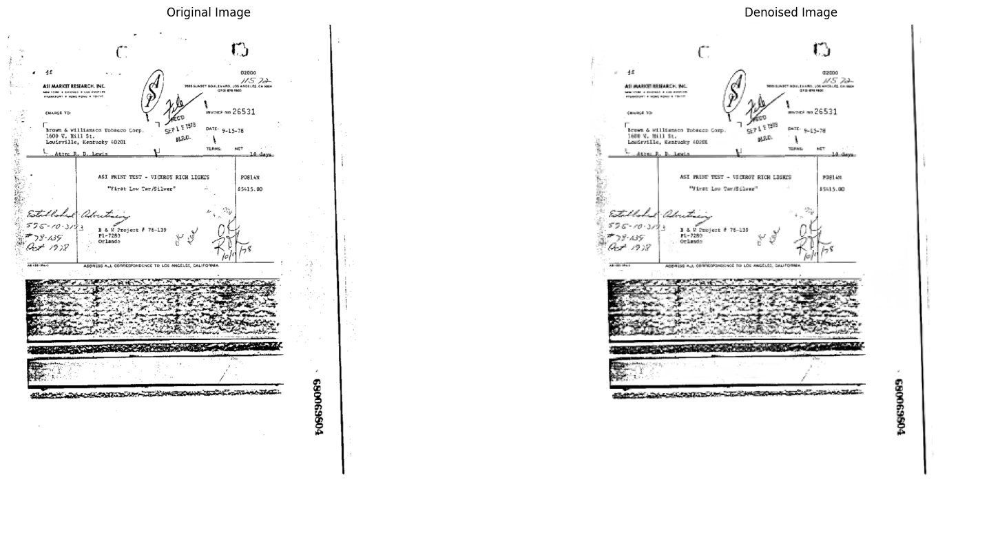

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_5.png


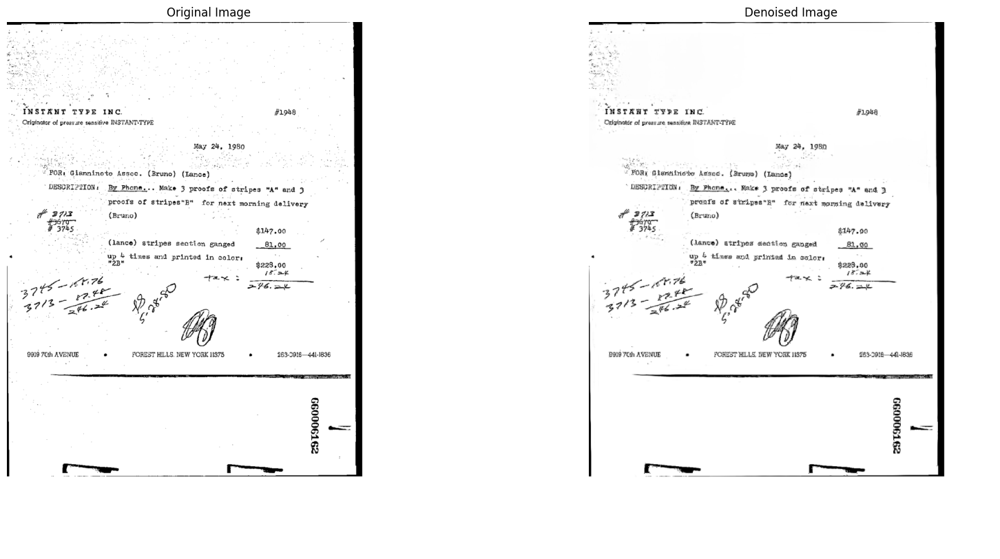

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_6.png


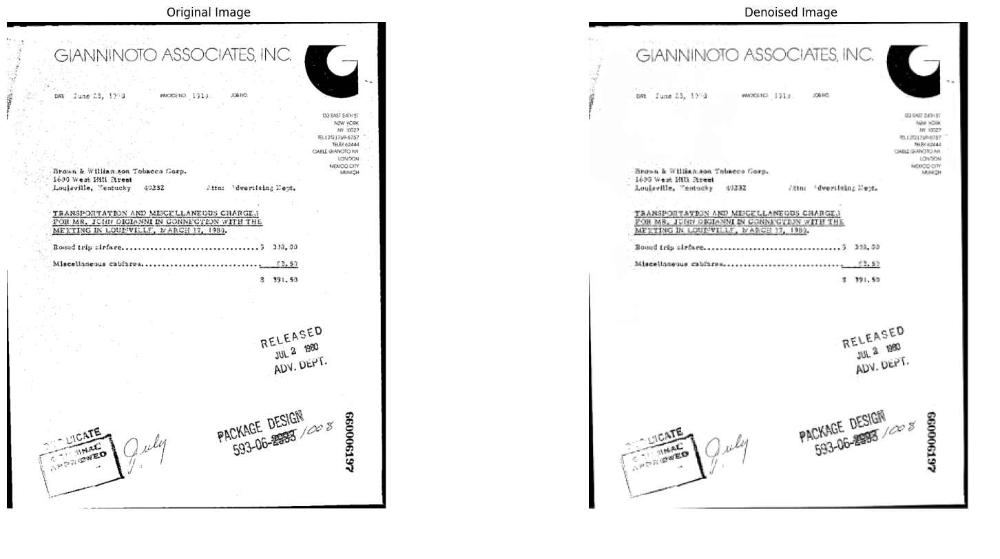

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_7.png


In [ ]:
import os
import cv2
import numpy as np
from skimage import img_as_float
from skimage.restoration import denoise_wavelet
import matplotlib.pyplot as plt

def fractal_denoise(image, level=980):
    # Convert image to float
    image = img_as_float(image)

    # Apply wavelet denoising as a proxy for fractal-based denoising
    denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)

    return denoised_image

def process_image(image_path, output_path):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Error: Image not found at {image_path}")
        return

    # Apply non-local means denoising
    denoised_image = cv2.fastNlMeansDenoising(image, None, 10, 37, 70)

    # Apply fractal denoising (wavelet denoising as a proxy)
    denoised_image = fractal_denoise(denoised_image, level=1)

    # Normalize the images for better visualization
    original_image = (255 * image).astype(np.uint8)
    denoised_image = (255 * denoised_image).astype(np.uint8)

    # Display original and denoised images side by side
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(denoised_image, cmap='gray')
    plt.title("Denoised Image")
    plt.axis('off')

    plt.show()

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)
    print(f"Processed and saved: {output_path}")

def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_{i+1}.png')
        process_image(image_path, output_path)

if __name__ == "__main__":
    main()


Image 1

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000023361.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

Date ap?
»Bakor ee

  

3209308
1 7 Ave tede

 

sem goamay ayy

 

+ Leona gy wasataaon

 

Moe ewe 241 strowt
STS SETI tasrwvcny bo tot

 

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_1.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

 

 

 

=
ereAge (eve ure in a

—

—

 

 

 



Image 2

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000037007.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

SPRTION ORDER C C

(ULICH-KOENIG ADVERTISING INC. 1451 SO. MIAMI AVENUE, MIAMI, FLORIDA 33131
5-971-0451 905-371-9801 .

3/29/78

 
 

Mr. DeWitt Ingraham
WEDR-Radio
1437 NW 35th Streot

+ Miami, Plorida :

$18 YOUR AUTHORITY To INSERT THE ADVERTISING 01

 

 

 

 

  

 

a Radio Commercials Gross Cost
330
we Poo} gm an

 

$275.28

0994.50089

 

Bill Murphy

ren phy

 

 

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_2.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

SyNTION ORDER re C

IWLICH-KOENIG ADVERTISING INC.
S-AT-udS1 SOSaTL-GO!

 

5150. MIAMI AVENUE, MIAMI, FLORIDA 39131

3/15/79_
Fe-kg-1

  

 

Mr. Delite Ingraham

WEDR-Fadia

2437 We 35th Streat
+ Hiand, Plerids

 

  

 

 

 

Radio Commercials Gross Cost
we Po} tne

 

$275.28

   

0994-0089

 

 

 



Image 3

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000037010.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

NSERTION ORDER

SRULICH-KOENIG ADVERTISING INC, 135180. MIAMI AV}
05.971-0981 909-971-4901

  

+ Me. Poh Allen .

 

 

, Radio Conrerets

 

 

s-20n%
Loan eH
sen
Fpusizmia
banel2N
Landen

 

4
3
:
i
i
i

 

 

 

 

 

Gross cost

5264.00
108/00,
36:00
53100
36:00
36200

3432.00

€99200089

 

 

 

 

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_3.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

NSEnrow ORDER

ARULICH ROESTOADYERTISIS IC. 1421S. MIAME,
feoties sosaneweu

   

+ Mr. Rab atzen
wrr-aadis

hss Bay ea

ism Beech, Fiseiaa

TAM FEOUI A 3135

or ontae 2/79

 

 

  

 

 

 

€99210089

f

 

 

 

 



Image 4

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000089370.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_4.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

Image 5

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000102823.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

 

b Yoon

 

 

 

 

2000
US. 72~

 

26531
se
Brom 6 williassen Tobacco Corp gett ome: isc
eo We WL fe p.
2 touisvitle, Keatveky 40201 we \
wads.
: ASE PRN? TEST - VIGEROY RICH LIGHES Posten
teat Low Tar/Sives” 5015.00

Slide) CileBeis,

SOS 10-3044

 

36 i Feoject # 76-199
P5839 ee

er 1908

 

 

 

 

 

 

POSE9O08S -



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_5.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

   
     

mM

‘seme

HES A

Le 26531

PAE Satsang

eh see

 

POSEIOORS -



Image 6

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000113725.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

 

INSTANT TYPE INC #9k8
Originater of presyaze sensitive INSTANT-TYPE

May 2, 1980

FOR: Gianninoto Assoc. (Bruno) (Lance)
DESCRI?EIONs By Phone... Nake 3 proofs of stripes "A" end 3

proofs of stripes"E" for next morning delivery

wf 278 (Bruno)
3745 ($147,00
~ Qance) stripes section ganged 81,00
. up 4 tines and printed in colors
“3pm $228,00
axe: it
athe we ee QO SPE ae
a (37 ee D
378 oe Nom
9919 70h AVENUE . ST HILLS. NEW YORK 11975 . 269-2916—4411836

 

 

291900099

   



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_6.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

INSTANT TYPE INC. #1
Otiginatée of prosrare sensitive INSTANTTYPE

May 2%, 1980
“FOR, Glanninote Acsce. (Bruno) (Danse)
DESCRIPTION: By Phone... Maké 3 proofs of stripes "A" and 3

pranfs of stripes"”" for riext morwing delivery
& 27 (Bruno)

3745 $147.90
* Gaence) stripes section ganged Bi .a0.
up 4 tines and printed im color:
"2B" $228.00
: ces tie

8 eh NE Q Pee
3 Re re ee ¢
2th rat 9 a
Bod7cn AVENUE === FOREST MILLS NEW'YORKUSTS «== =—seo016- asa

 

o
—

2

8

 



Image 7

In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000113760.tif'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

GIANNINOTO ASSOCIATES, INC.

 

 

 

ome Sune23, 1259 OCENO. 1929 sane,

Tas EAST EST

Naw york

wv (0127

¥5(212) 790.5797

wit. apace cm

Brown & Williawson Tobacca Corp. Mung

1629 Weat MMU Ztreet

Louisville, Tentucky 49232 Atta: ‘dverttsing Feo

 

 
        

NG IN LG WARCH 17, 198).
Rouad trip airfares. esos detetea ents eeeeeee teveeeee3 323,99

Miscellaneous cablaresy.syesereceeenseeeseeaee serene

 

3 391,59

ever
ww?
apy. be? ‘.

w&
—
o
pee)
Rio
ae
OB
w
261900099

 

 



In [ ]:
image_path_in_colab='/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_7.png'
extractedInformation = pytesseract.image_to_string(Image.open(image_path_in_colab))
print(extractedInformation)

GIANNINGTO ASSOCIATES, INC.

val wees L9La mae

   

391,99

  



Enhanced text images using binarization and adaptive threshold

<ipython-input-121-56da6a9adca4>:12: FutureWarning: `multichannel` is a deprecated argument name for `denoise_wavelet`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)


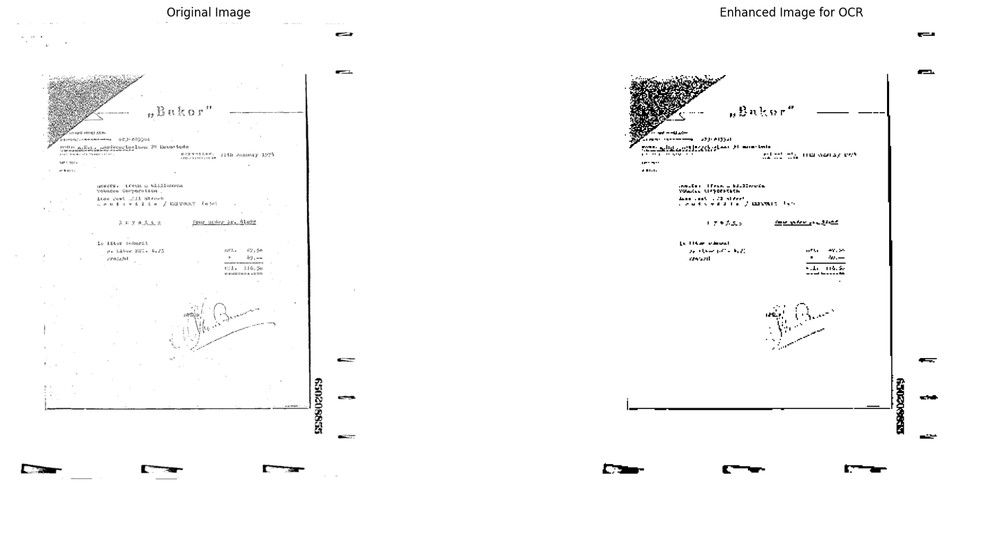

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png


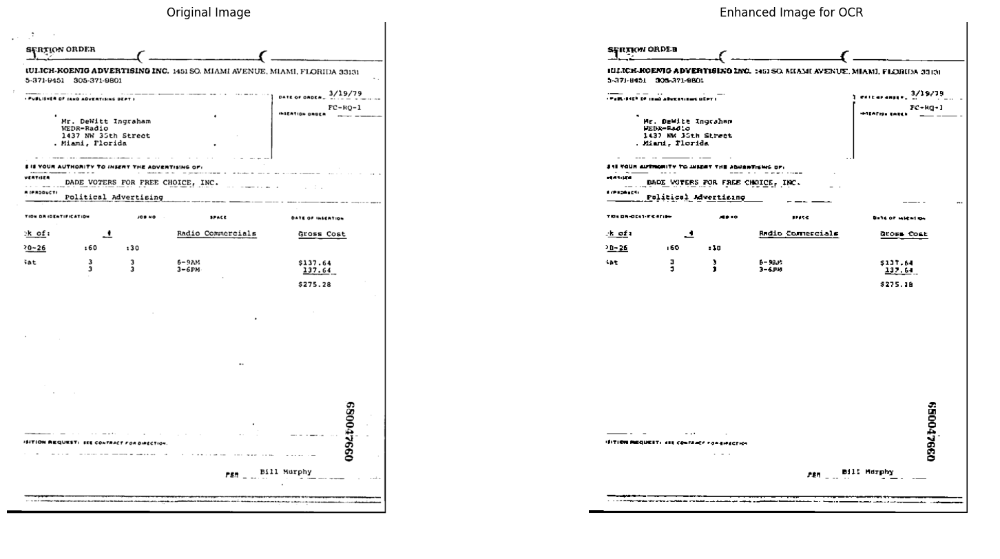

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_2.png


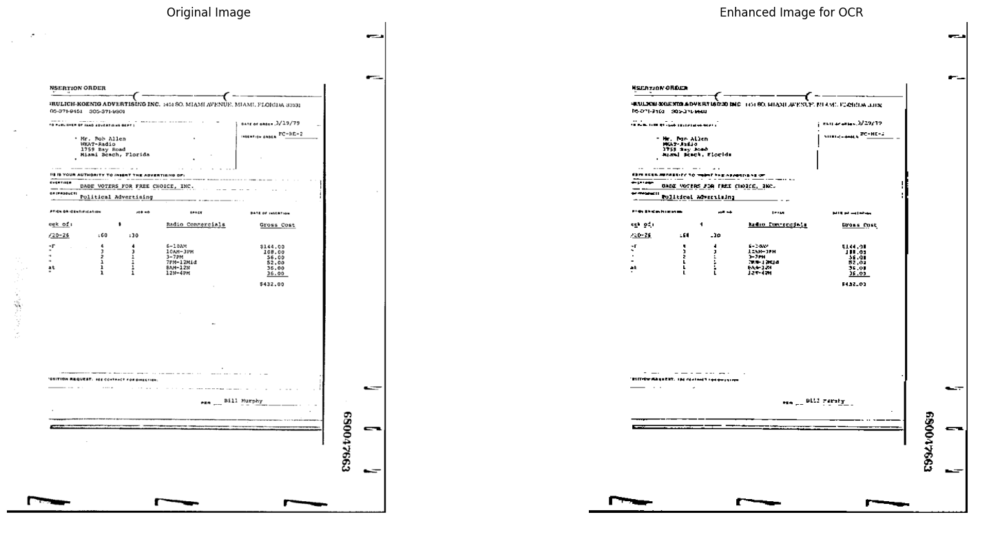

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_3.png


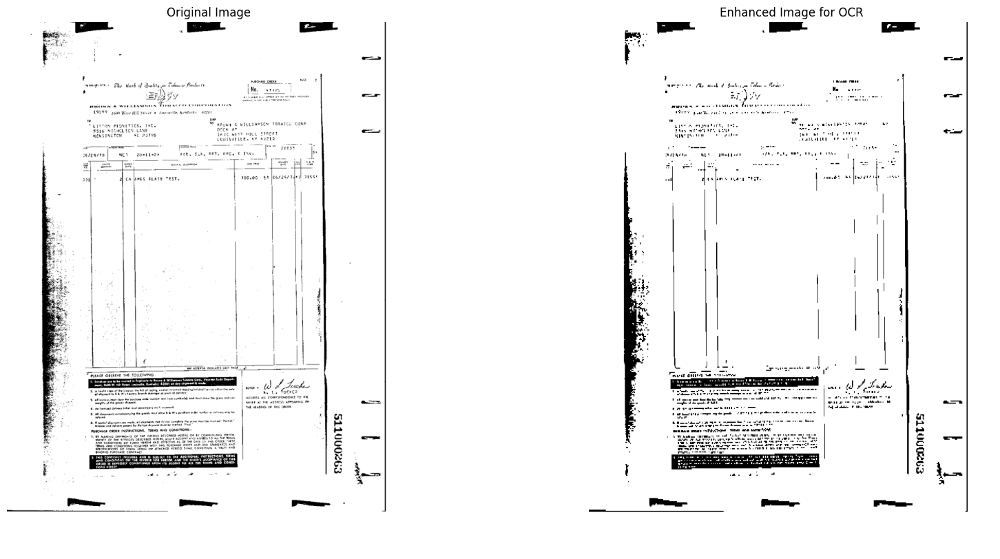

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_4.png


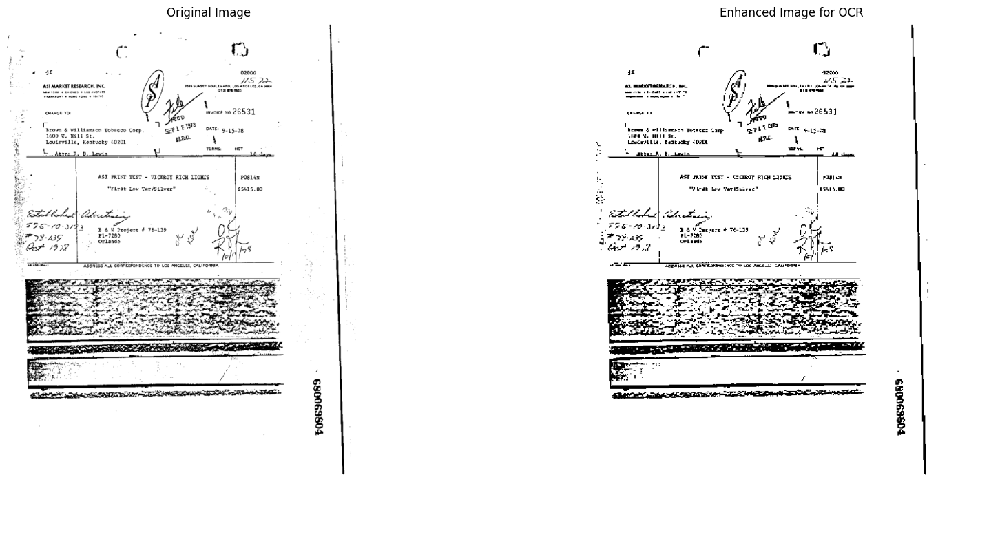

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_5.png


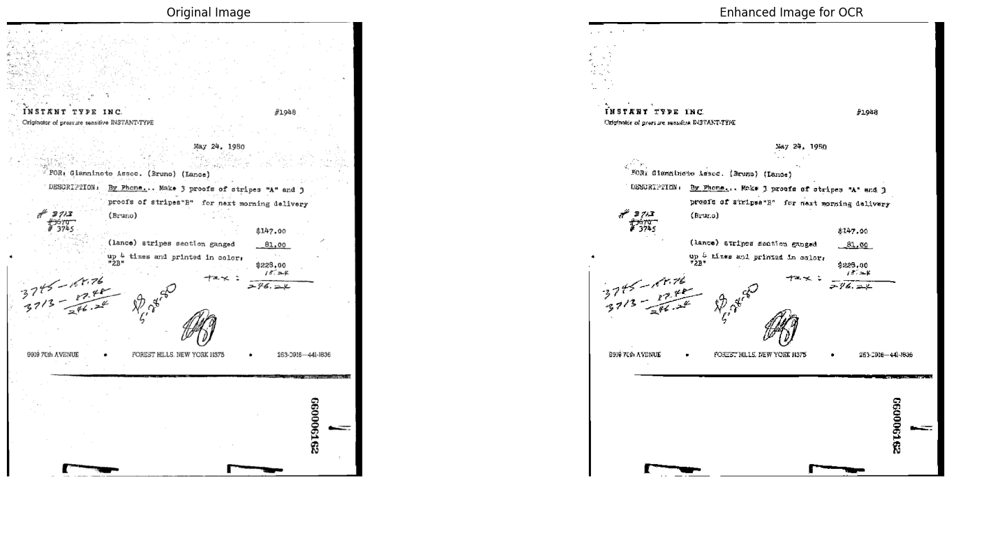

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_6.png


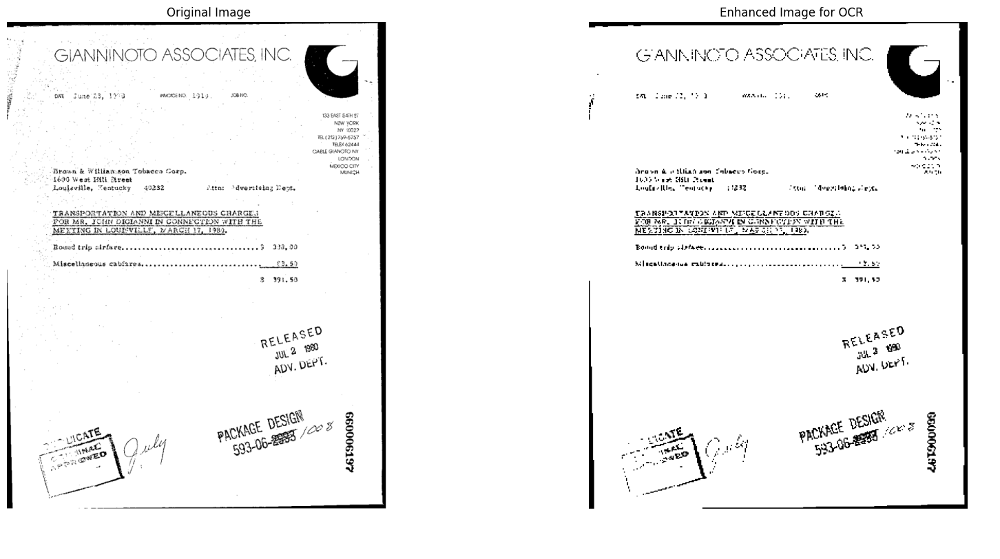

Processed and saved: /content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_7.png


In [ ]:
import cv2
import numpy as np
from skimage import img_as_float
from skimage.restoration import denoise_wavelet
import matplotlib.pyplot as plt

def fractal_denoise(image, level=480):
    # Convert image to float
    image = img_as_float(image)

    # Apply wavelet denoising as a proxy for fractal-based denoising
    denoised_image = denoise_wavelet(image, multichannel=False, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)

    return denoised_image

def enhance_for_ocr(image):
    # Convert to binary using adaptive thresholding
    image = (image * 255).astype(np.uint8)
    #binary_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 15, 17)
    _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Apply morphological operations to remove small noise and close gaps in text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, 1))
    morphed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)

    dilated_image = cv2.dilate(morphed_image, kernel, iterations=1)

    return dilated_image

def process_image(image_path, output_path):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Apply non-local means denoising
    denoised_image = cv2.fastNlMeansDenoising(image, None, 10, 37, 70)

    # Apply fractal denoising (wavelet denoising as a proxy)
    denoised_image = fractal_denoise(denoised_image, level=1)

    # Enhance image for OCR
    enhanced_image = enhance_for_ocr(denoised_image)

    # Display original, denoised, and enhanced images side by side
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    '''plt.subplot(1, 2, 2)
    plt.imshow(denoised_image, cmap='gray')
    plt.title("Denoised Image")
    plt.axis('off')'''

    plt.subplot(1, 2, 2)
    plt.imshow(enhanced_image, cmap='gray')
    plt.title("Enhanced Image for OCR")
    plt.axis('off')

    plt.show()

    # Save the enhanced image
    cv2.imwrite(output_path, enhanced_image)
    print(f"Processed and saved: {output_path}")

def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{i+1}.png')
        process_image(image_path, output_path)

if __name__ == "__main__":
    main()


In [ ]:
# Updated code

import os
import cv2
import numpy as np
from skimage import img_as_float
from skimage.restoration import denoise_wavelet
import matplotlib.pyplot as plt

def fractal_denoise(image, level=480):
    # Convert image to float
    image = img_as_float(image)

    # Apply wavelet denoising as a proxy for fractal-based denoising
    denoised_image = denoise_wavelet(image, channel_axis=None, wavelet='haar', mode='soft', wavelet_levels=level, rescale_sigma=True)

    return denoised_image

def histogram_equalization(image):
    return cv2.equalizeHist(image)

'''def apply_clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    return clahe.apply(image)

def bilateral_filter(image, d=9, sigma_color=75, sigma_space=75):
    return cv2.bilateralFilter(image, d=d, sigmaColor=sigma_color, sigmaSpace=sigma_space)

def unsharp_mask(image, kernel_size=(5, 5), sigma=1.0, amount=1.0, threshold=0):
    blurred = cv2.GaussianBlur(image, kernel_size, sigma)
    sharpened = float(amount + 1) * image - float(amount) * blurred
    sharpened = np.maximum(sharpened, np.zeros(sharpened.shape))
    sharpened = np.minimum(sharpened, 255 * np.ones(sharpened.shape))
    sharpened = sharpened.round().astype(np.uint8)
    if threshold > 0:
        low_contrast_mask = np.absolute(image - blurred) < threshold
        np.copyto(sharpened, image, where=low_contrast_mask)
    return sharpened'''

def laplacian_sharpen(image):
    laplacian = cv2.Laplacian(image, cv2.CV_64F)
    laplacian = np.clip(laplacian, 0, 255).astype(np.uint8)
    sharpened = cv2.subtract(image, laplacian)
    return sharpened

def enhance_for_ocr(image):
    # Ensure the image is in uint8 format
    image = (image * 255).astype(np.uint8)
    en_image=histogram_equalization(image)
  '''# Apply CLAHE with adjusted parameters
    clahe_image = apply_clahe(image, clip_limit=1.5, tile_grid_size=(8, 8))

    # Apply bilateral filter with adjusted parameters
    bilateral_image = bilateral_filter(clahe_image, d=5, sigma_color=50, sigma_space=50)

    # Apply unsharp masking with adjusted parameters
    sharpened_image = unsharp_mask(bilateral_image, amount=1.0, threshold=10)'''

    # Optionally, apply Laplacian sharpening
    final_image = laplacian_sharpen(en_image)

    return final_image

def process_image(image_path, output_path):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Error: Image not found at {image_path}")
        return

    # Apply non-local means denoising
    denoised_image = cv2.fastNlMeansDenoising(image, None, 10, 7, 21)

    # Apply fractal denoising (wavelet denoising as a proxy)
    denoised_image = fractal_denoise(denoised_image, level=1)

    # Enhance image for OCR
    enhanced_image = enhance_for_ocr(denoised_image)

    # Display original, denoised, and enhanced images side by side
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(denoised_image, cmap='gray')
    plt.title("Denoised Image")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(enhanced_image, cmap='gray')
    plt.title("Enhanced Image for OCR")
    plt.axis('off')

    plt.show()

    # Save the enhanced image
    cv2.imwrite(output_path, enhanced_image)
    print(f"Processed and saved: {output_path}")

def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{i+1}.png')
        process_image(image_path, output_path)

if __name__ == "__main__":
    main()


IndentationError: unindent does not match any outer indentation level (<tokenize>, line 50)

In [ ]:
import cv2
import numpy as np

def calculate_variance(image, x, y, window_size):
    half_window = window_size // 2
    window = image[x-half_window:x+half_window+1, y-half_window:y+half_window+1]
    variance = np.var(window)
    return variance

def calculate_sum_of_differences(image, x, y, window_size):
    half_window = window_size // 2
    central_pixel = image[x, y]
    window = image[x-half_window:x+half_window+1, y-half_window:y+half_window+1]
    differences = np.abs(window - central_pixel)
    return np.sum(differences)

def is_uncorrupted_pixel(image, x, y, window_size, T1, T2):
    half_window = window_size // 2
    window = image[x-half_window:x+half_window+1, y-half_window:y+half_window+1]
    Wmin = np.min(window)
    Wmax = np.max(window)
    S = calculate_sum_of_differences(image, x, y, window_size)
    V = calculate_variance(image, x, y, window_size)
    central_pixel = image[x, y]

    if (Wmin < central_pixel < Wmax) or (S < T1 and V < T2):
        return True
    else:
        return False

def ifbda_denoise(image, window_size=5, T1=50, T2=20):
    denoised_image = image.copy()
    half_window = window_size // 2
    rows, cols = image.shape

    for x in range(half_window, rows - half_window):
        for y in range(half_window, cols - half_window):
            if not is_uncorrupted_pixel(image, x, y, window_size, T1, T2):
                window = image[x-half_window:x+half_window+1, y-half_window:y+half_window+1]
                central_pixel = image[x, y]
                differences = np.abs(window - central_pixel)
                membership_values = 1 - (differences / np.max(differences))
                valid_pixels = window[(membership_values > 0.1) & (membership_values < 0.9)]

                if len(valid_pixels) > 0:
                    denoised_image[x, y] = np.median(valid_pixels)
                else:
                    denoised_image[x, y] = central_pixel
    return denoised_image

def main():
    # Path to input image
    image_path = '/content/drive/MyDrive/Datasets/0000218219.tif'
    output_path = '/content/drive/MyDrive/Datasets/denoised_image_ifbda.tif'

    # Read the input image in grayscale mode
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Error: Image not found at {image_path}")
        return

    # Apply IFBDA denoising
    denoised_image = ifbda_denoise(image)

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)
    print(f"Processed and saved: {output_path}")

if __name__ == "__main__":
    main()


Processed and saved: /content/drive/MyDrive/Datasets/denoised_image_ifbda.tif


array([[ 33,  95,  91, ..., 255, 255, 255],
       [ 91, 255, 255, ..., 255, 255, 255],
       [ 91, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
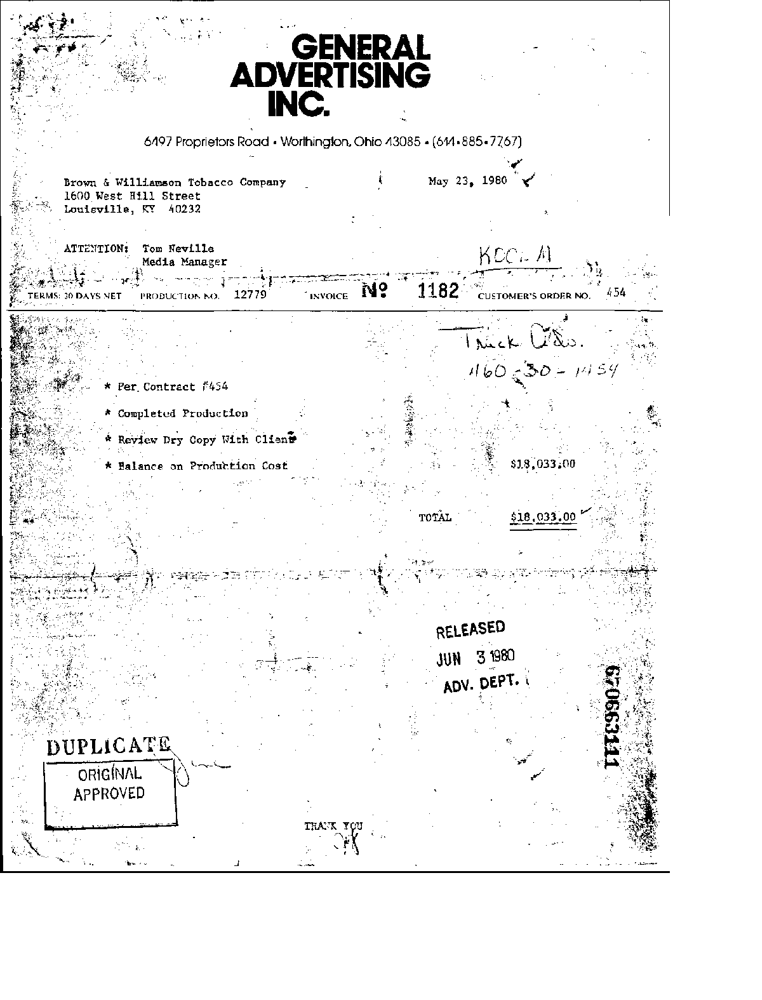

In [ ]:
denoised_image

array([[[ 33,  33,  33],
        [ 95,  95,  95],
        [ 91,  91,  91],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[ 91,  91,  91],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[ 91,  91,  91],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
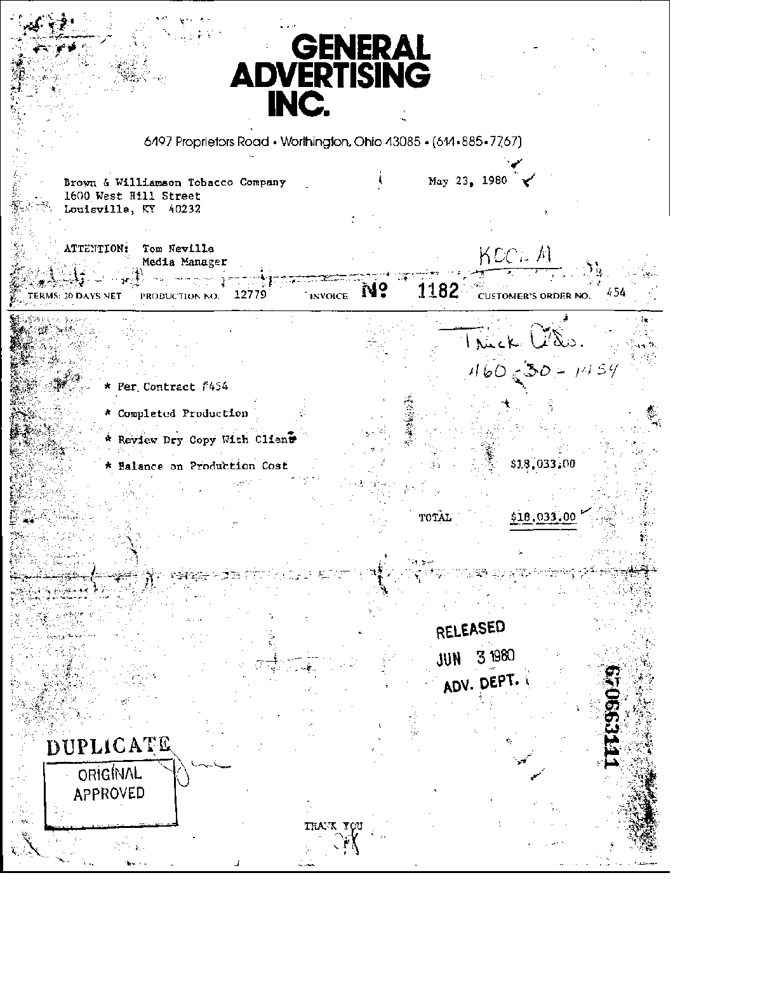

In [ ]:
cv2.imread('/content/drive/MyDrive/Datasets/0000442735.tif')

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/denoised_image_ifbda.tif')
print(text)

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/0000218219.tif')
print(text)

 

| a

670212783

 

 

 

 

 

 

 

 

 

 

ws BE
TouNsin LT Svs SOs

 

 

 

 

 

 

 

 

 

 

 

 

 

 

 



In [ ]:
import cv2
import numpy as np
from scipy.stats import multivariate_normal
from sklearn.mixture import GaussianMixture
from skimage.util import view_as_windows

def local_noise_identifier(image, threshold_salt=240, threshold_pepper=15):
    """
    Identify salt and pepper noise in the image.
    """
    salt_noise = (image >= threshold_salt)
    pepper_noise = (image <= threshold_pepper)
    return salt_noise, pepper_noise

def extract_patches(image, patch_size):
    """
    Extract overlapping patches from the image.
    """
    patches = view_as_windows(image, (patch_size, patch_size))
    patches = patches.reshape(-1, patch_size, patch_size)
    return patches

def em_clustering(patches, n_components=5):
    """
    Perform EM-based clustering on the patches.
    """
    patches_flat = patches.reshape(patches.shape[0], -1)
    gmm = GaussianMixture(n_components=n_components, covariance_type='full')
    gmm.fit(patches_flat)
    labels = gmm.predict(patches_flat)
    return labels, gmm

def non_local_switching_filter(image, labels, gmm, patch_size, salt_noise, pepper_noise):
    """
    Perform non-local switching filtering based on EM clustering.
    """
    denoised_image = image.copy()
    half_patch = patch_size // 2
    patches = view_as_windows(image, (patch_size, patch_size))
    patches = patches.reshape(-1, patch_size, patch_size)

    for idx, (x, y) in enumerate(np.ndindex(image.shape[0] - patch_size + 1, image.shape[1] - patch_size + 1)):
        if salt_noise[x + half_patch, y + half_patch] or pepper_noise[x + half_patch, y + half_patch]:
            similar_patches = patches[labels == labels[idx]]
            weights = np.array([np.exp(-np.linalg.norm(patch - patches[idx])**2 / (2 * gmm.covariances_[labels[idx]].diagonal().mean())) for patch in similar_patches])
            weights /= weights.sum()
            denoised_pixel = np.sum([weight * patch[half_patch, half_patch] for weight, patch in zip(weights, similar_patches)])
            denoised_image[x + half_patch, y + half_patch] = denoised_pixel

    return denoised_image

def denoise_image(image_path, output_path, patch_size=5, n_components=5):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Identify salt and pepper noise
    salt_noise, pepper_noise = local_noise_identifier(image)

    # Extract patches from the image
    patches = extract_patches(image, patch_size)

    # Perform EM-based clustering on the patches
    labels, gmm = em_clustering(patches, n_components=n_components)

    # Apply non-local switching filtering
    denoised_image = non_local_switching_filter(image, labels, gmm, patch_size, salt_noise, pepper_noise)

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)

if __name__ == "__main__":
    image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'
    output_path = '/content/drive/MyDrive/Datasets/denoised_image_proposed.tif'
    denoise_image(image_path, output_path)
    print(f"Processed and saved: {output_path}")


In [ ]:
import cv2
import numpy as np
from scipy.stats import multivariate_normal
from sklearn.mixture import GaussianMixture
from skimage.util import view_as_windows

def local_noise_identifier(image, threshold_salt=240, threshold_pepper=15):
    """
    Identify salt and pepper noise in the image.
    """
    salt_noise = (image >= threshold_salt)
    pepper_noise = (image <= threshold_pepper)
    return salt_noise, pepper_noise

def extract_patches(image, patch_size):
    """
    Extract overlapping patches from the image.
    """
    patches = view_as_windows(image, (patch_size, patch_size))
    patches = patches.reshape(-1, patch_size, patch_size)
    return patches

def em_clustering(patches, n_components=5):
    """
    Perform EM-based clustering on the patches.
    """
    patches_flat = patches.reshape(patches.shape[0], -1)
    gmm = GaussianMixture(n_components=n_components, covariance_type='full')
    gmm.fit(patches_flat)
    labels = gmm.predict(patches_flat)
    return labels, gmm

def non_local_switching_filter(image, labels, gmm, patch_size, salt_noise, pepper_noise):
    """
    Perform non-local switching filtering based on EM clustering.
    """
    denoised_image = image.copy()
    half_patch = patch_size // 2
    patches = view_as_windows(image, (patch_size, patch_size))
    patches = patches.reshape(-1, patch_size, patch_size)

    for idx, (x, y) in enumerate(np.ndindex(image.shape[0] - patch_size + 1, image.shape[1] - patch_size + 1)):
        if salt_noise[x + half_patch, y + half_patch] or pepper_noise[x + half_patch, y + half_patch]:
            similar_patches = patches[labels == labels[idx]]
            weights = np.array([np.exp(-np.linalg.norm(patch - patches[idx])**2 / (2 * gmm.covariances_[labels[idx]].diagonal().mean())) for patch in similar_patches])
            weights /= weights.sum()
            denoised_pixel = np.sum([weight * patch[half_patch, half_patch] for weight, patch in zip(weights, similar_patches)])
            denoised_image[x + half_patch, y + half_patch] = denoised_pixel

    return denoised_image

def denoise_image(image_path, output_path, patch_size=5, n_components=5):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Identify salt and pepper noise
    salt_noise, pepper_noise = local_noise_identifier(image)

    # Extract patches from the image
    patches = extract_patches(image, patch_size)

    # Perform EM-based clustering on the patches
    labels, gmm = em_clustering(patches, n_components=n_components)

    # Apply non-local switching filtering
    denoised_image = non_local_switching_filter(image, labels, gmm, patch_size, salt_noise, pepper_noise)

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)

if __name__ == "__main__":
    image_path = '/content/drive/MyDrive/Datasets/0000442735.tif'
    output_path = '/content/drive/MyDrive/Datasets/denoised_image_proposed.tif'
    denoise_image(image_path, output_path)
    print(f"Processed and saved: {output_path}")


In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/denoised_image_ifbda.tif')
print(text)

Anisotropic with multiple samples

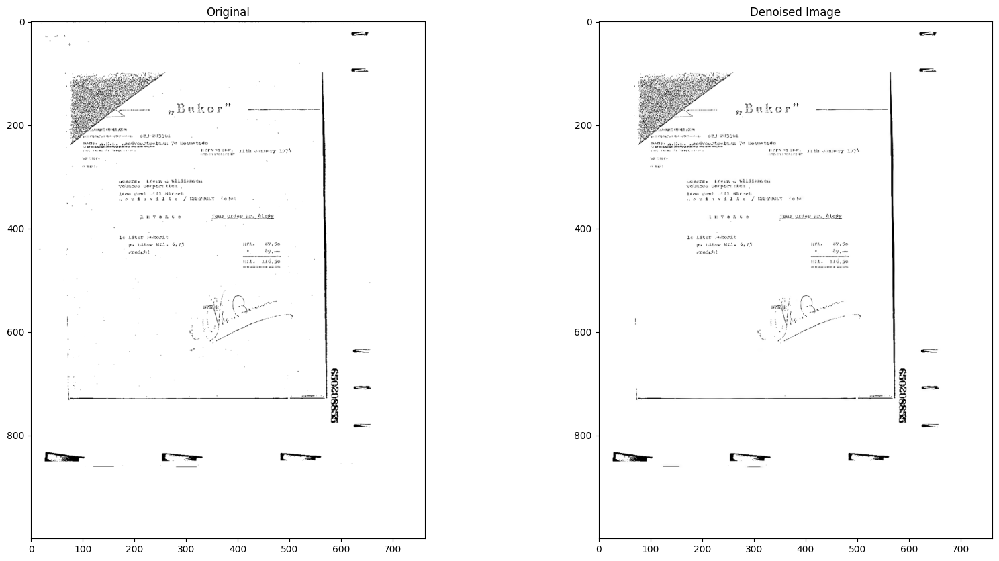

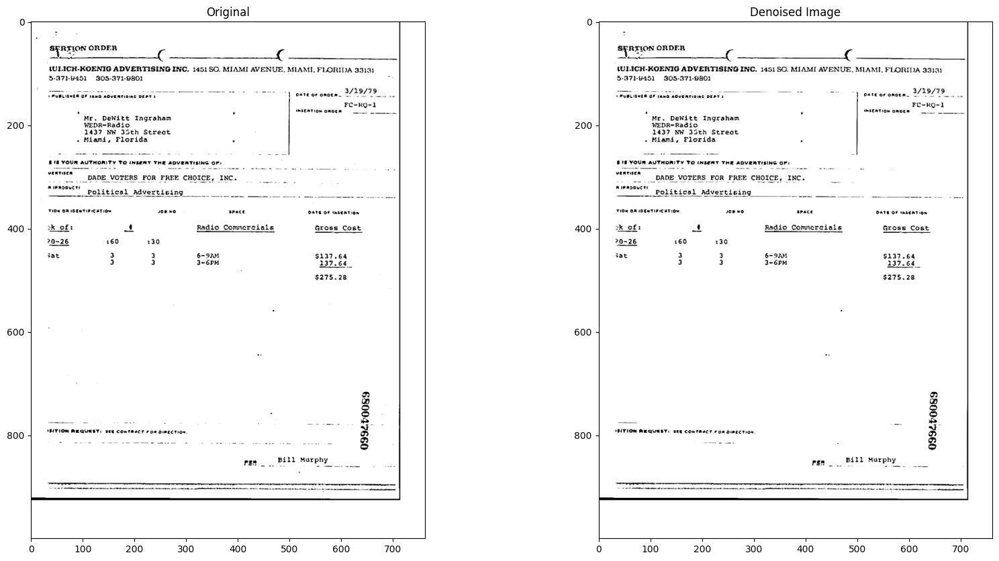

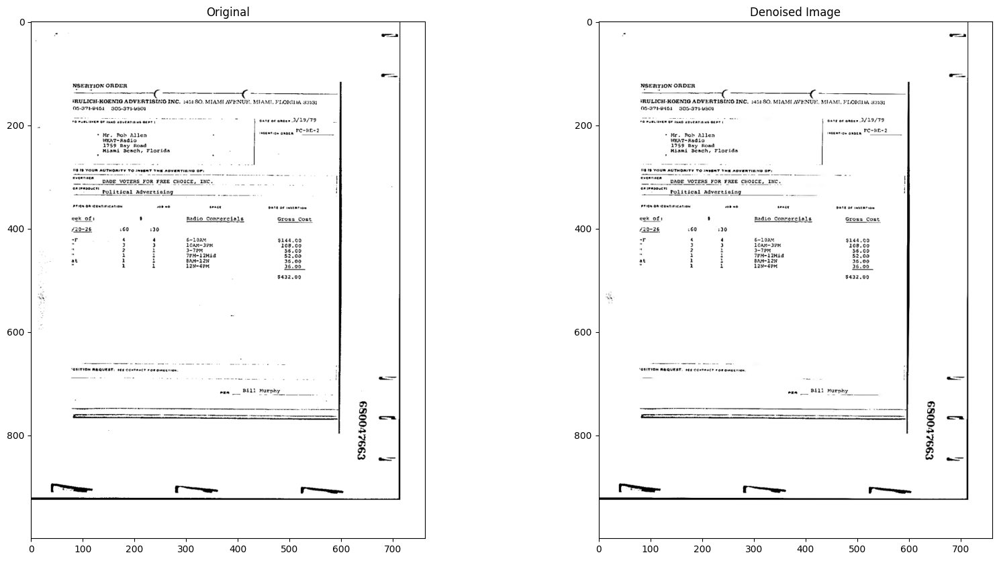

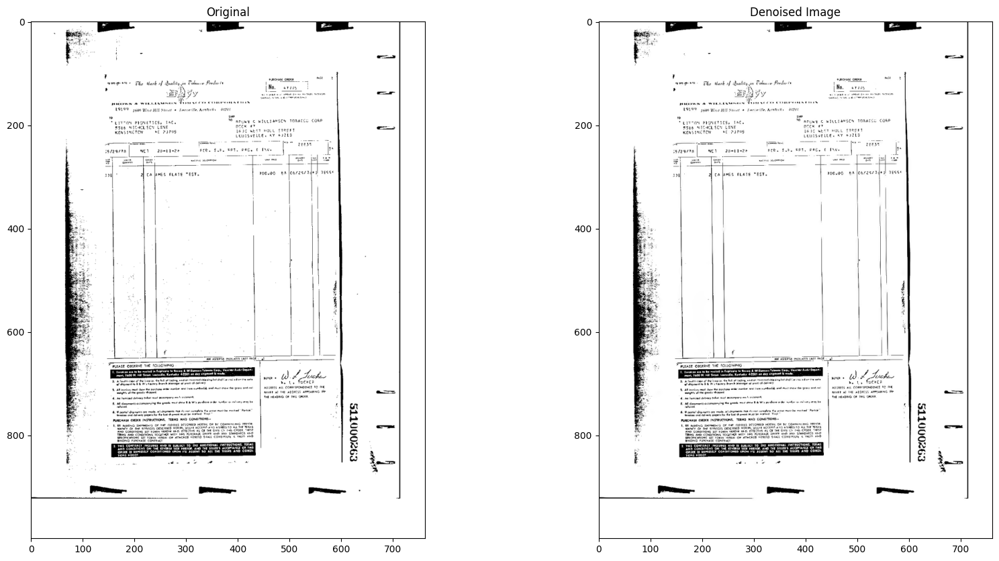

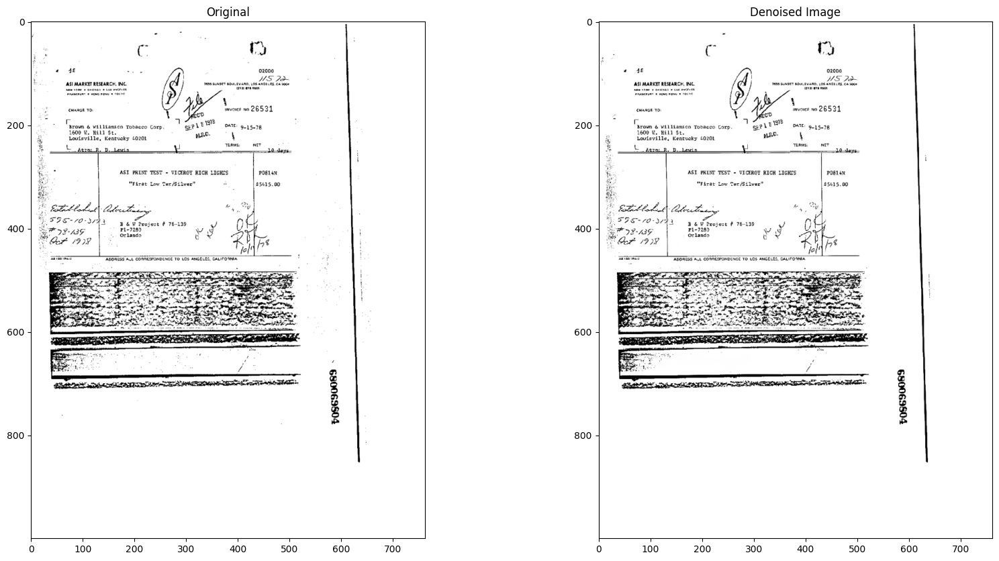

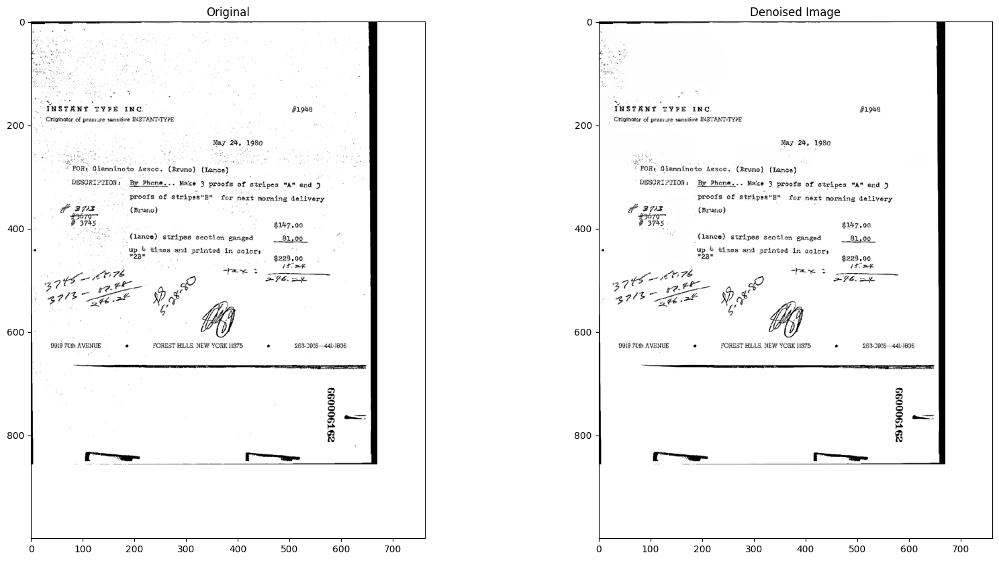

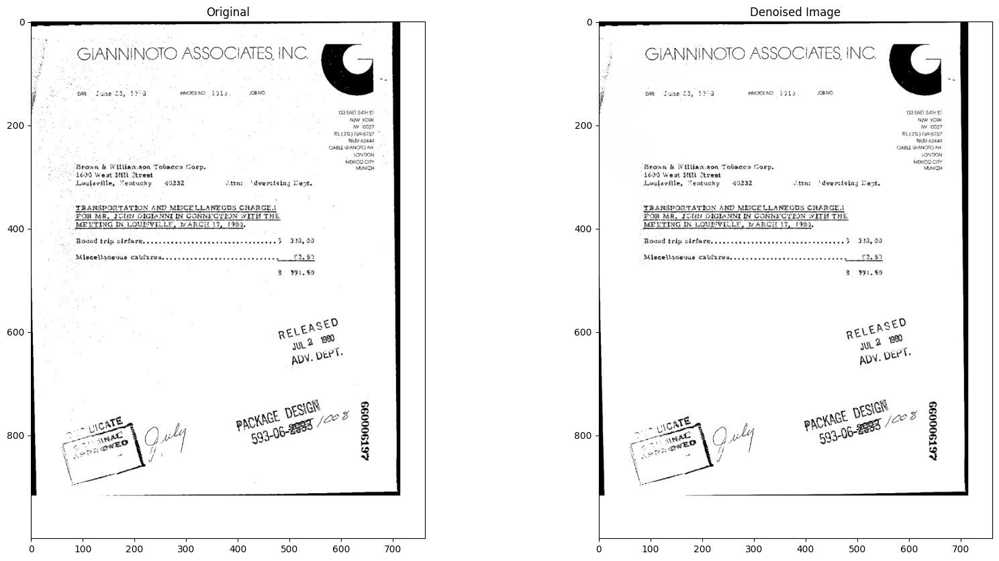

In [ ]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

def anisotropic_diffusion(image, iterations, kappa, gamma, option):
    image = image.astype('float32')

    if option == 1:
        image = cv2.GaussianBlur(image, (1, 1), 0)
    elif option == 2:
        image = cv2.medianBlur(image.astype(np.uint8), 3)

    # Pad the image to handle border cases
    image_padded = np.pad(image, ((1, 1), (1, 1)), mode='constant')

    for i in range(iterations):
        # Compute gradients
        nablaN = image_padded[:-2, 1:-1] - image_padded[1:-1, 1:-1]
        nablaS = image_padded[2:, 1:-1] - image_padded[1:-1, 1:-1]
        nablaW = image_padded[1:-1, :-2] - image_padded[1:-1, 1:-1]
        nablaE = image_padded[1:-1, 2:] - image_padded[1:-1, 1:-1]

        # Conductance
        cN = np.exp(-(nablaN / kappa) ** 2)
        cS = np.exp(-(nablaS / kappa) ** 2)
        cW = np.exp(-(nablaW / kappa) ** 2)
        cE = np.exp(-(nablaE / kappa) ** 2)

        # Update image
        image_update = image_padded[1:-1, 1:-1] + gamma * (
            cN * nablaN + cS * nablaS + cW * nablaW + cE * nablaE
        )

        # Update padded image
        image_padded[1:-1, 1:-1] = image_update

    return image_padded[1:-1, 1:-1]

def process_image(image_path, output_path):
    # Read the original image as grayscale
    org_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    # Apply Non-Local Means Denoising
    image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=20, searchWindowSize=100)
    # Apply anisotropic diffusion
    denoised_image = anisotropic_diffusion(image, iterations=30, kappa=20, gamma=0.2, option=1)
    # Apply morphological closing
    kernel = np.ones((1, 1), np.uint8)
    denoised_image = cv2.morphologyEx(denoised_image, cv2.MORPH_CLOSE, kernel)
    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)
    # Display the original and denoised images
    plt.figure(figsize=(20, 10))  # Adjust width and height as desired
    plt.subplot(1, 2, 1)
    plt.title('Original')
    plt.imshow(org_image, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.title('Denoised Image')
    plt.imshow(denoised_image, cmap='gray')
    plt.show()

def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{i+1}.png')
        process_image(image_path, output_path)

if __name__ == "__main__":
    main()


Image 1

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000023361.tif',config=r'--oem 3 --psm 6')
print(text)

wtb il one a —_=
ae
Yeu Ss Saf ”
oe Po Bakor rs
ene”
f\ aero
” ‘otadabakogetalveectye ten 7 theemtode
a omyeyeme: autie gasumaye ap7'
oye trey watinvcn
te biter intoett
: 2 Meanene’ Magee
Was aN6,s6
i cy —
we Vy
i i er ee
¥ : a
, - —_—
g
: gs =
Ie IS
4 =—



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

=
ieee” —
& se” =
Pee Bakor —-—__—-
oe
Pennines axnsne
uladibakceuttausstye ton 7 lecontede
SEAS Saree siuufemen O70
fiers, cea saa
roe
Se aes Or
aa earns
— one
nat cy _
mes | cy
Vie ao
! » Mb
. i A
—
. g
po
a —
| Co oe



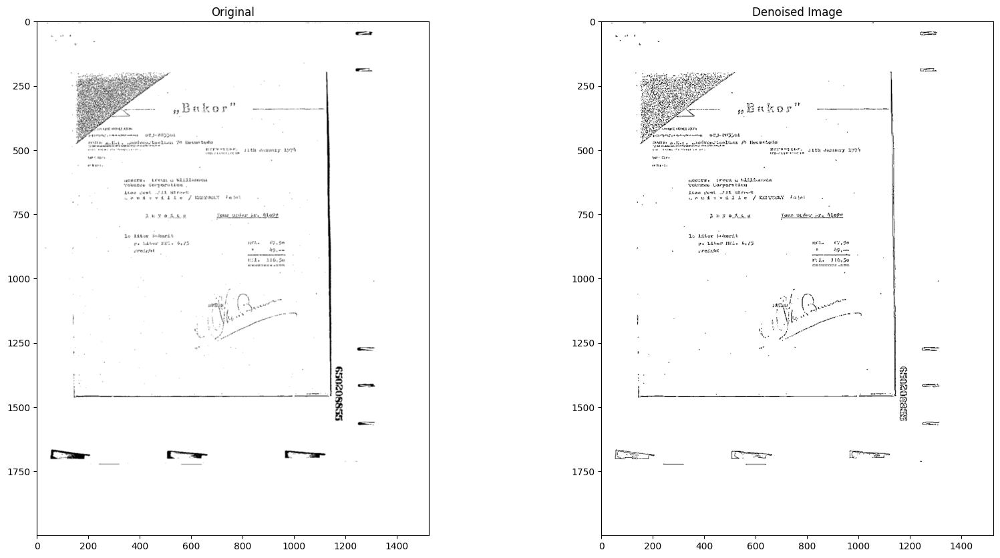

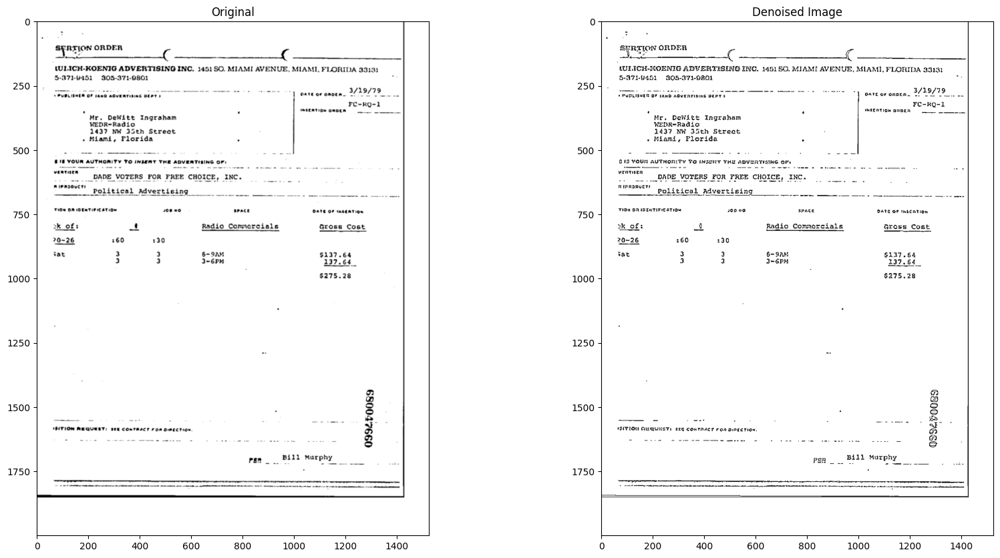

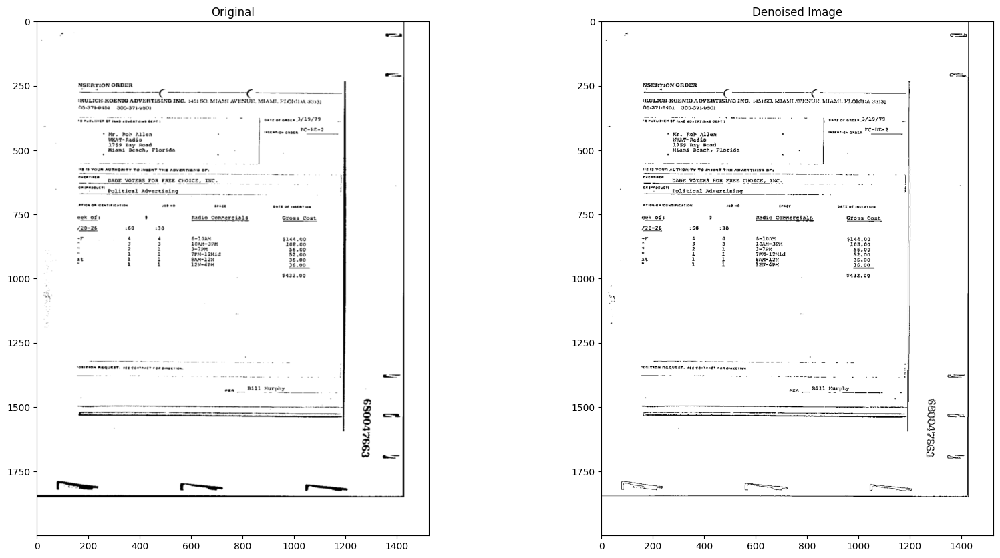

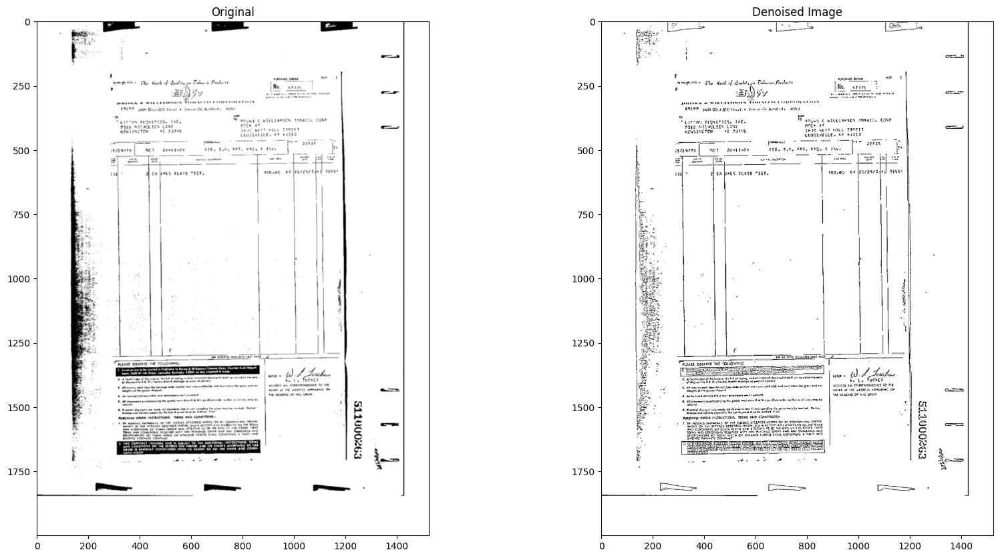

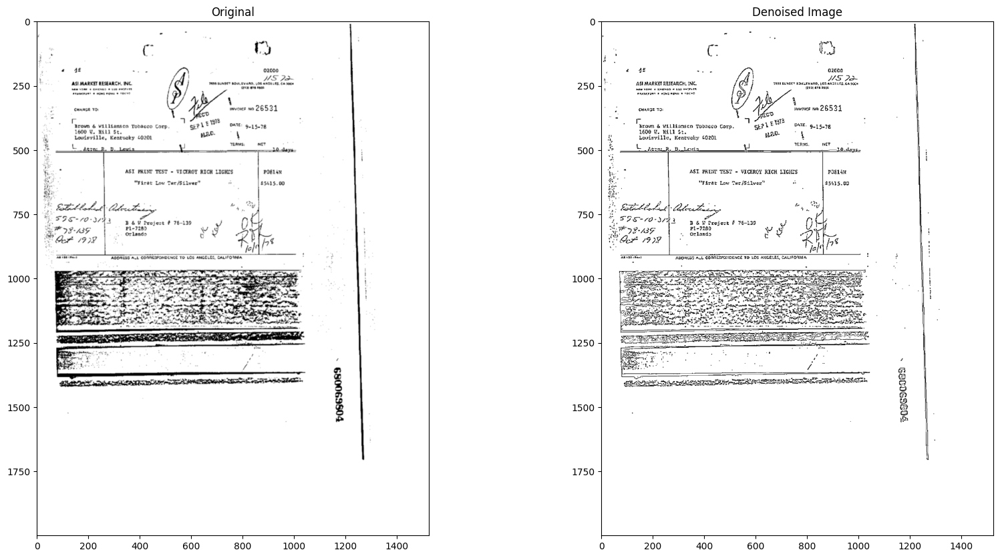

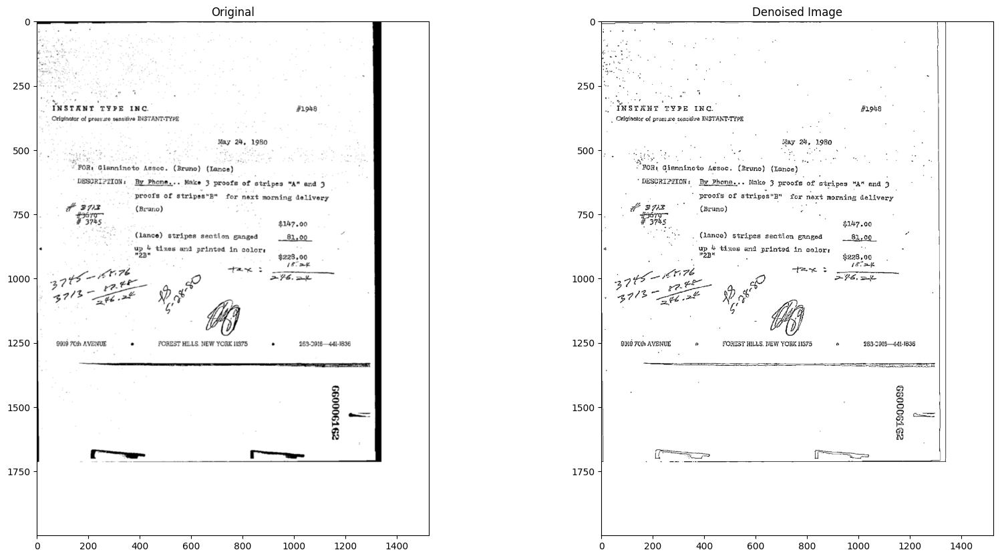

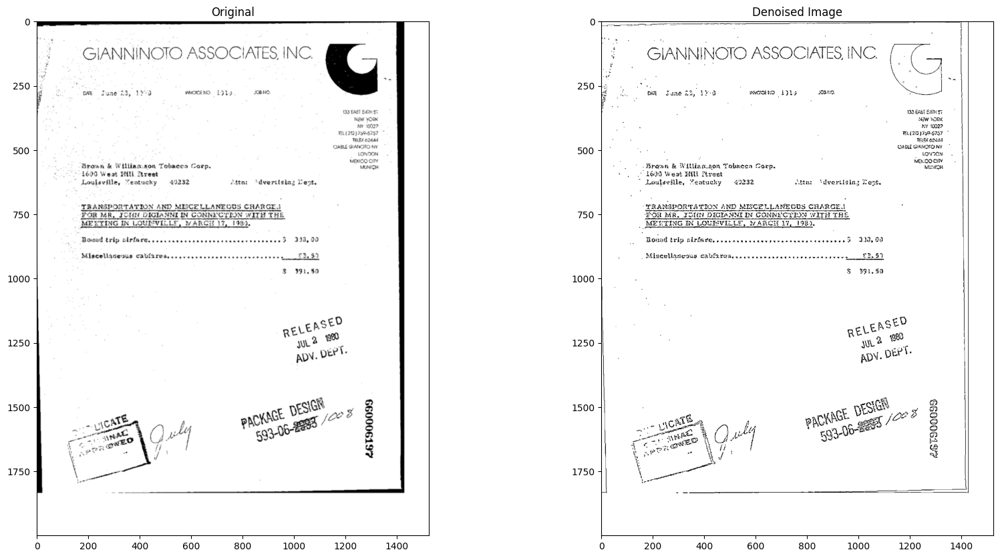

In [ ]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pytesseract

def anisotropic_diffusion(image, iterations, kappa, gamma, option):
    image = image.astype('float32')

    if option == 1:
        image = cv2.GaussianBlur(image, (1, 1), 0)
    elif option == 2:
        image = cv2.medianBlur(image.astype(np.uint8), 3)

    # Pad the image to handle border cases
    image_padded = np.pad(image, ((1, 1), (1, 1)), mode='constant')

    for i in range(iterations):
        # Compute gradients
        nablaN = image_padded[:-2, 1:-1] - image_padded[1:-1, 1:-1]
        nablaS = image_padded[2:, 1:-1] - image_padded[1:-1, 1:-1]
        nablaW = image_padded[1:-1, :-2] - image_padded[1:-1, 1:-1]
        nablaE = image_padded[1:-1, 2:] - image_padded[1:-1, 1:-1]

        # Conductance
        cN = np.exp(-(nablaN / kappa) ** 2)
        cS = np.exp(-(nablaS / kappa) ** 2)
        cW = np.exp(-(nablaW / kappa) ** 2)
        cE = np.exp(-(nablaE / kappa) ** 2)

        # Update image
        image_update = image_padded[1:-1, 1:-1] + gamma * (
            cN * nablaN + cS * nablaS + cW * nablaW + cE * nablaE
        )

        # Update padded image
        image_padded[1:-1, 1:-1] = image_update

    return image_padded[1:-1, 1:-1]

def process_image(image_path, output_path):
    # Read the original image as grayscale
    org_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Resize the image for better OCR performance
    scale_factor = 2
    org_image = cv2.resize(org_image, (0, 0), fx=scale_factor, fy=scale_factor)

    # Apply Non-Local Means Denoising
    image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Apply anisotropic diffusion
    denoised_image = anisotropic_diffusion(image, iterations=30, kappa=20, gamma=0.2, option=1)

    # Apply adaptive thresholding
    denoised_image = cv2.adaptiveThreshold(denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 7, 15)

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)

    # Display the original and denoised images
    plt.figure(figsize=(20, 10))  # Adjust width and height as desired
    plt.subplot(1, 2, 1)
    plt.title('Original')
    plt.imshow(org_image, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.title('Denoised Image')
    plt.imshow(denoised_image, cmap='gray')
    plt.show()


def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{i+1}.png')
        process_image(image_path, output_path)
if __name__ == "__main__":
    main()


In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000023361.tif',config=r'--oem 3 --psm 6')
print(text)

wtb il one a —_=
ae
Yeu Ss Saf ”
oe Po Bakor rs
ene”
f\ aero
” ‘otadabakogetalveectye ten 7 theemtode
a omyeyeme: autie gasumaye ap7'
oye trey watinvcn
te biter intoett
: 2 Meanene’ Magee
Was aN6,s6
i cy —
we Vy
i i er ee
¥ : a
, - —_—
g
: gs =
Ie IS
4 =—



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

hee ear
\ -
etteriee etm a eS na cg
on Bul eet ot seek Mig eae ae
‘PS rete Siipate crete :
EUROS NP
SE ABE
eget era eM SIy
Se UNE ie RB i ty op oF
Pia Te Eile gt es a uF — ee ee
sqpgeciktesc eae BA a de
EG eS 0
eraccaai ose .
A
RReaE Ne :
Ep RS soe anes sxe :
SP te apr paren as Be s- 20908 : .
AO orth sealing gsetitlvope Sagkeacs ft Tegint iede
Ma tetas Nn engT ed ome BOPVATRer. Gate amare AE
leit quar aster
wecine
wun .
exGUEree Leow es WALA Suro
. ‘akonue Garporiticu
Ateo geal .24L Beret '
. wewdevdille /§ jayrceny Jotei -
pusyoAto Tour vider ive ALode
Le Udtaw bokged t
fra Lalewat Whe ba ob neh im, de
‘ : erndrtet 4 ‘Gime
Medes Mla, Su .
aeusioga «=e
: ae :
Pf ee
av bo Nee
“AG ra woo}
i . fy be a i
' » ot ye Pa
woot a
u Foe oe
' “t fot
: Maas
, . at : —
. -
G1
rah
=



Image 2

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000037007.tif',config=r'--oem 3 --psm 6')
print(text)

SERTION ORDER
(ULICH-KOENIG ADVERTISING INC. 1451 SO. MIAMI AVENUE, MIAMI, FLORIDA 33131
S-871-0451 805-371-0801 :
Peat ov tana caveats sists Tr ware or onoen 2/29/79
FC-RQ=1
‘ Mr. DeWitt Ingraham . oo
WEDR=Radio
3437 NH 35th Streot
« Miami, Plorida .
#18. YOUR AUTHORITY FO INLERY THE ADVERTISING OF
“must DADE VOTERS FOR FREE CHOICE, INC. an
Rimini Political advertising a
ok of: a Radio Commercials Gross Cost
20~26 360 330
sat 3 3 6-9AN $137.64
3 3 3+6PH 237.64
$275.28
n
wD
2
: 3
ee a — a
INTION REQUEST: 1U Conraacr rom omtcrio¥ 2
pen BALL Morphy _



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_2.png',config=r'--oem 3 --psm 6')
print(text)

SER TION ORDER
nn
WULICH-HOENIG ADVERTISING INC. 145150. MIAMI AVENUE, MIAMI, FLORIDA 33131
371-0451 805-371-6801 *-
Te ee we ee ee 3/13/7
* PYDLODMES OF (aNd AQvIATIBING DEPT OATL GF OROLA. ¢ = uf a --
FC-RQ-1
a ‘ JHIERTION CARER — om
Mr, DeWitt Ingraham
WEDR=Radio
1437 NW 35th Streat .
» Miami, Florida *
$0) YOUR AUTHORITY Ta iNDZRY YHE ADYERTIONG OFFI .
ManiN ._.DMDE_VOTERS FOR FREE CHOICE, INC. | a
ee Political Advertising
Tidy OF IDEA TIP ATION sOD HD BRACE DATE OF InSC ATOR
nk of: i Radio Commercials Bross Cost
20~26 360 330
sat 3 3 6-9AM $147.64
3 a 3+6PH 137.64
$275.28
a
a
Qo
. 2
—— —— i ; . eee LL
IDTIOS GUQueay: and ConTaacr ron pete trios. a
ee ee eee 2 .
GS
PER Bill Murphy /
EE TE A



Image 3

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000037010.tif',config=r'--oem 3 --psm 6')
print(text)

NSERTION ORDER
IRULICH-KOENIG ADVERTISING INC. 112150, MIAMI AVENUE, MIAMI, PLOMIDA soa3
sa7nossi | 8oe-3714801
SO PunameR OF inne avvenrangotery - ‘eave of noun 3/29/79 -
- mucarvon onvea PCTRE*2
+ Me. Roh, aaten : oo
Wiz" aselo
THE Bay Rona
Wham Seach rioctan
srr" DADE VOTERS FOR FREE CHOICE, INC. oe |
SreTane pox itieal advertioing _ !
ent oft ' nadio conrerciats sross cost
129-26 0330
z ‘ ‘ ean suss.o0
: $ ; foneSon 68"00
: 3 i 38h $8.98
: i i Fenrlansa 305
* i i seat Sétoe
: i i iNchn 3ée0
#432,00
pan __BALI HoEDhy a
a 2
~ ~ es @
= ee]! OB
$
>
x
Qn
a
Oo es



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_3.png',config=r'--oem 3 --psm 6')
print(text)

“ wm
moe
NSENTION ONDER
MULICH-KOENTG ADVERTISING ING. 215150, MIAMI AVENUE, MIAMI. FLOMIDA guar
OS-371-8401 905-371-801
Varpireuceeee SF faa avvenraume oxme nave of oncex 3/29/79 -
- «he. Pom atten . wrentioe annen POWER
WRAT=Radio
L753 Ray Rasd
Miami Beach, Florida . .
. .
Ng th YOUR AUTHORITY To inenat THO ADWEATIAING DFS
er TTT mm . I
— —_DADE VOUERS FORK FREE CHOICE, INC. wo ee tee }
j :
. onmenoryert Political advertising nae _. 4
PTiOm GRIP ATION 2b ao cence BOTK BF WARES LOR
ouk oft a fadio Comrercisia Gross Cost
#20625 260 20
a 4 a B= LOAM S144 .G0
" 3 3 TiAM= 38M Age. cg
“ 2 2 s-7PM 36,00
” i i 7PH-U2hid §2,00
: ak 1 1 Gra-Len 36,00
™ 1 i Lanedpy i6.00
: $432,009
es
“DUTIOM AL QUEST. ben Cantante fom Oink et :
—.-- a cane Coe eee ee oe .t oo
ent Bill Murphy
a A RR oo
SE Oe ee 3 =
9
. xox
at
G
G3
BD ao



Image 4

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

Image 5

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

Image 6

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_1.png',config=r'--oem 3 --psm 6')
print(text)

Image 7

In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000113760.tif',config=r'--oem 3 --psm 6')
print(text)

7 GIANNINOTO ASSOCIATES, INC. | ©
¢ om fune'23, 393 mwoneno 19ty, | smn
: RO EAST SST
at Yoo
epee)
mcenesn?
‘ecu
camomtone
on
Brown & Wiltiag.son Tabacco Corp. oe
1603 West HIM street
Loulseille, “eatucky 49232 Dita: “dvertising Best.
TRANSPORTATION AND MISCELLANEOUS CHARGES
HOR MR, JoUN DIGIANNE IN CONNECTION WITB THE
MECTING IRLOUMVELLE, NARGH 17, 190),
Rowad trip alrfaressccsccceccceseecsscensaccessesee s 335,90
Miscetladesus cabiaresscsscseseeessesesesesesseerg £2053
e 391.59
sed
REE
ww?
ADV. pert.
4 2
GK aS
Ck ve joeb 3
ont, / packer / 3
EY Oly Peo 8
co wee By’ ~ a
Plone” Vy eS
\ . it a
\
\ ee



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_7.png',config=r'--oem 3 --psm 6')
print(text)

: , | ~ _—
: GIANNINCTO ASSOCIATES, INC.
2)” gee Sane ga, bea © peROSENO LBL SBN, ~~
pT a WEST Ea
. . NEW WORSE
, ber 10027
, : TEL(212) 799-5757
. . . Tei e2aad
. : CABLE GEROTONY ~
oo . : _ UGATGN.
- 0° Brawn & Williawson Tabseca Corp, ee eae ;
+) EBA Weak BM Zeveet
” Loujawille, Yeatucky 42232 Site: ‘dyeritging Lax.
“TRANSPORTATION jND MUCELLANEDUS CHARGES .
OH MR, TOUM DUGTANNT IN CONNES TION WITH TRE
. ME STING ES LOUISVILLE, MARCH 17, 1982,
. “Unnad trip akrlives eves ccceccavesucnsteneaceusveees3 Ad, 30
: . Mincebiaiewig Calarey ence wavwan een re reewnkebeues 2.57
| 3 841.50
. . GED
RELES
2, 4g80
Soe eye
| apy. DER}.
6 cy ACE pret poe &
_ okt Lu phe ve Ae / 3
2, % CO) ee Rayo " 3
Teno AT e
er J! “
t
\ ees



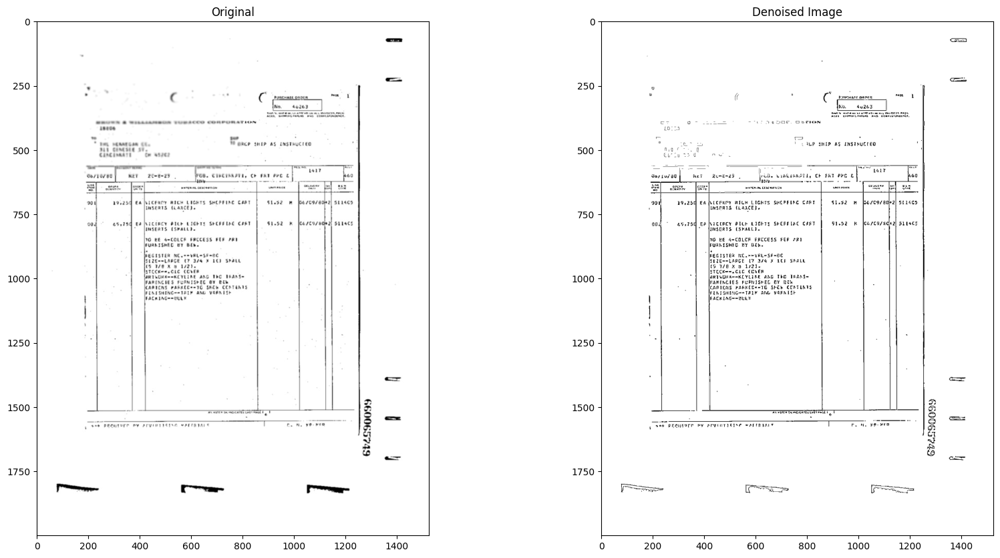

In [ ]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pytesseract

def anisotropic_diffusion(image, iterations, kappa, gamma, option):
    image = image.astype('float32')

    if option == 1:
        image = cv2.GaussianBlur(image, (1, 1), 0)
    elif option == 2:
        image = cv2.medianBlur(image.astype(np.uint8), 3)

    # Pad the image to handle border cases
    image_padded = np.pad(image, ((1, 1), (1, 1)), mode='constant')

    for i in range(iterations):
        # Compute gradients
        nablaN = image_padded[:-2, 1:-1] - image_padded[1:-1, 1:-1]
        nablaS = image_padded[2:, 1:-1] - image_padded[1:-1, 1:-1]
        nablaW = image_padded[1:-1, :-2] - image_padded[1:-1, 1:-1]
        nablaE = image_padded[1:-1, 2:] - image_padded[1:-1, 1:-1]

        # Conductance
        cN = np.exp(-(nablaN / kappa) ** 2)
        cS = np.exp(-(nablaS / kappa) ** 2)
        cW = np.exp(-(nablaW / kappa) ** 2)
        cE = np.exp(-(nablaE / kappa) ** 2)

        # Update image
        image_update = image_padded[1:-1, 1:-1] + gamma * (
            cN * nablaN + cS * nablaS + cW * nablaW + cE * nablaE
        )

        # Update padded image
        image_padded[1:-1, 1:-1] = image_update

    return image_padded[1:-1, 1:-1]

def process_image(image_path, output_path):
    # Read the original image as grayscale
    org_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Resize the image for better OCR performance
    scale_factor = 2
    org_image = cv2.resize(org_image, (0, 0), fx=scale_factor, fy=scale_factor)

    # Apply Non-Local Means Denoising
    image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Apply anisotropic diffusion
    denoised_image = anisotropic_diffusion(image, iterations=30, kappa=20, gamma=0.2, option=1)

    # Apply adaptive thresholding
    denoised_image = cv2.adaptiveThreshold(denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 7, 15)

    # Save the denoised image
    cv2.imwrite(output_path, denoised_image)

    # Display the original and denoised images
    plt.figure(figsize=(20, 10))  # Adjust width and height as desired
    plt.subplot(1, 2, 1)
    plt.title('Original')
    plt.imshow(org_image, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.title('Denoised Image')
    plt.imshow(denoised_image, cmap='gray')
    plt.show()


def main():
        image_path = '/content/WhatsApp Image 2024-05-28 at 13.20.47.jpeg'
        output_path = '/content/sample_data/denoised_enhanced_karteek.png'
        process_image(image_path, output_path)
if __name__ == "__main__":
    main()


In [ ]:
text = pytesseract.image_to_string('/content/WhatsApp Image 2024-05-28 at 11.06.24.jpeg',config=r'--oem 3 --psm 6')
print(text)

Je SES RSS Eh eceSee! do ema Goosen gice’ yaa
ivsia Poter Vio RASRIST ALB FunEGgs OEMRETACCT AROMIGD FSEUEOLDEY Hlecors
ea 7 doag: 901 saaley 7 9 90838 Bio as76] VERDAL-SEWKCS SoRTe7a |
' sorgzendo [e:z kewaks> so PA pLya ers 1 30, MEY Oee 478i
eee eee oe — os | we
Pda Rs Tee, oF he Soiccnrian alate maiat aia EEE
I Biren commas eto Ty ate
i DR MURRAY SENCS ee,
, [2525 CCUNTRY CLeB RD tg eh, die omewcig cyan ae
: WCUSTOMSALGN BC 27204 0, : Betis! 2 :
SE (gtnag mann age TART ET ES 7 nets ncaa ae oP Uae cea tea
ge Pe beseneron eae WT at leads aE as
i 3 [PRO-TEX COLORTWETRIC BADGE ScRTES pou Ce sos
i 2 S60 FORKALDZHYDS O BGR i . « :
z 3.05 BOXES . ae 4 30 26 a : \ Scionng % betes
: * : alae a :
pas \ | pol peor 3390
pes PREPAE MREIGHT |... O17 hoecto| : 7) Saks00 of eas
t | ¥ a) by Nes
: i i | 4 Uo e/
es fa tote sae loot cet Lee A
fg MAY SENKUS Aas 64 Be ;
ve 2618 COUNTY CLUB ROAD Dy & sap !
: PER or be Dele Momeni & Sig PSS |
ae ae 7 ear » SS- :
es st dew torttoedl teahie tage euad GRR ee

In [ ]:
text = pytesseract.image_to_string('/content/sample_data/denoised_enhanced_karteek.png',config=r'--oem 3 --psm 6')
print(text)

wey SdCADD Ey Std OE tae Stone ete Vi agucatea OL tears pest cng Stearn Y
rn * ot . tot EE OWIGEAL, eynDY
eh Fab A Poe O00 RARER ALD AIESHEY TeRAETCGT ARSED FSCUEOLDEY Meade ou * .
a 7. abe Gurr Cray Stor  Steretneeeg Vue 32 fate Ohi ons Dglnansy To, Burtomet Odaee la’ : - dinweczag, 7
Dep Ted > oo arene nn ———— mo Gy
io | Wasa? GO S456 FB good Bi9- 4676] VERDAL -SEMRTS , ULORT LD Fa
: Tamera Pa ome Fame | en + 4 OS GREEN wae ST
i ’ : I ede . 7 J ” . me oo tas ' M91 Otel Ot asia ay :
. 307 429000 [2- t [emir > SQ 24 Lv RTA 3G NEY Moe TASB LS
: “"s9:070 .- TT a “ - an | ye . “— Serine
. : a tn ee ne . ES : .
. Pos THE aU ga mole ot wth mo . : : : OS
: . Pou. eo to tnt et . Leone {0 Megry crac oN ALENT ANDES wnh IyuIGe MUTACE TiSland CUSTOIN
5 LOA. Weta To PET tee aay oo +) 4 GODT aus say seinen woueticr: fee Becait eo ae .
t : , . Po Suedat ep armen Soe ats te.
vo ooo cnticeto wate . oa oF side s7FG, SIT TSURL EOS ARETE GCN oO. cesacon 2.”
wee Poros hapeeticp ate ya eet 2 7 OG DON OBI, 

**PCA enhanced**

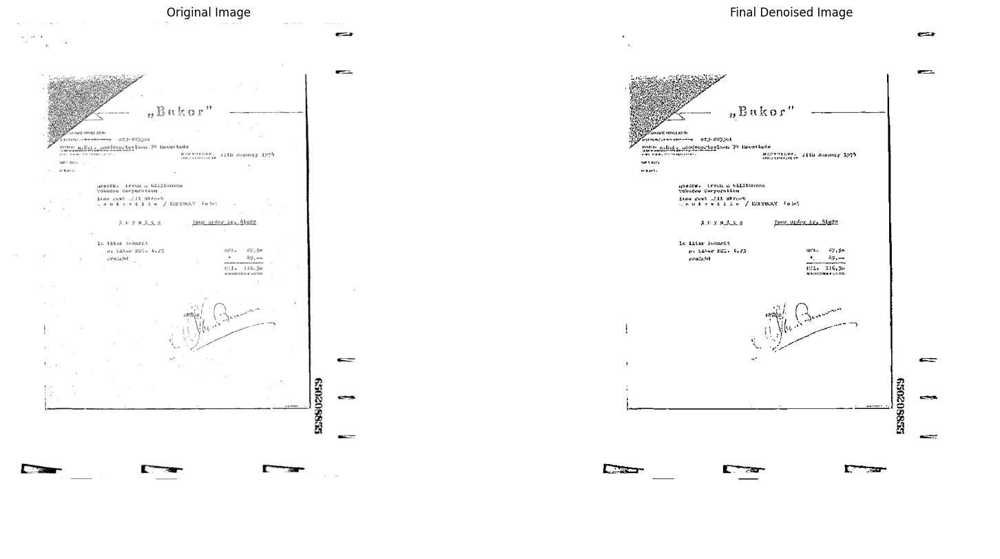

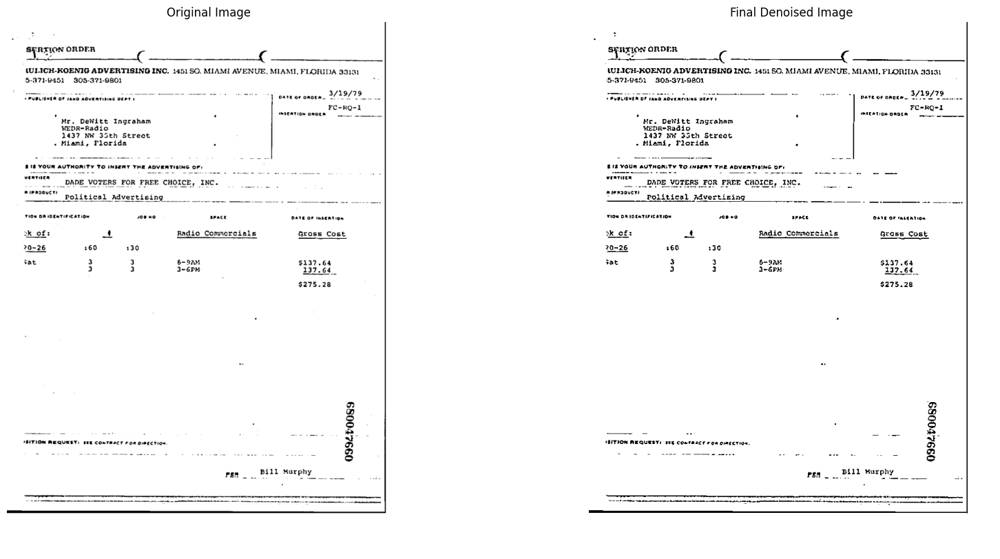

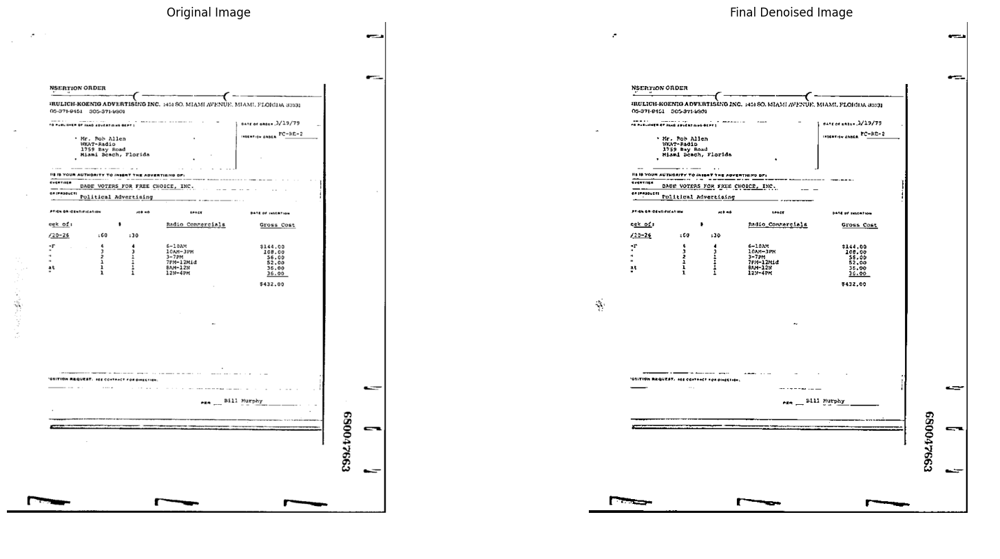

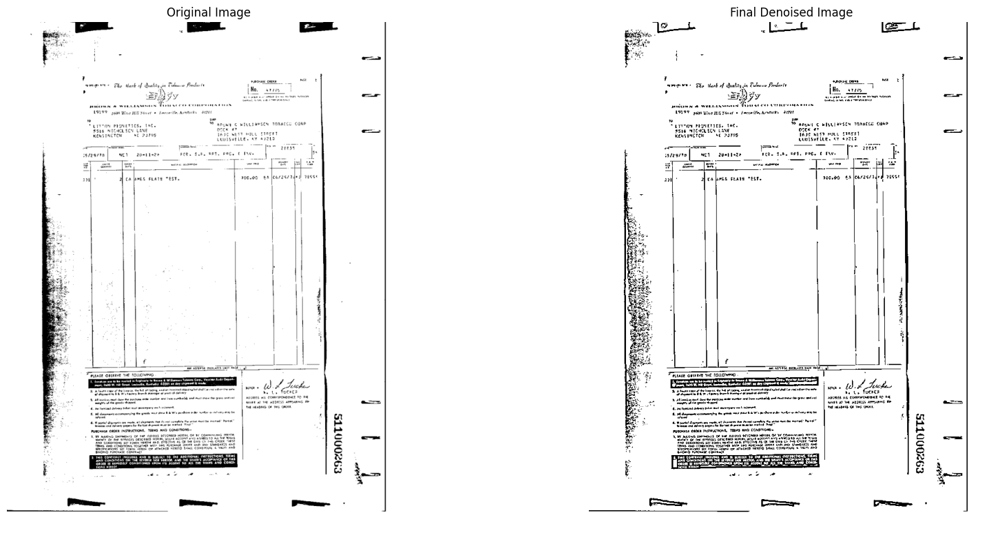

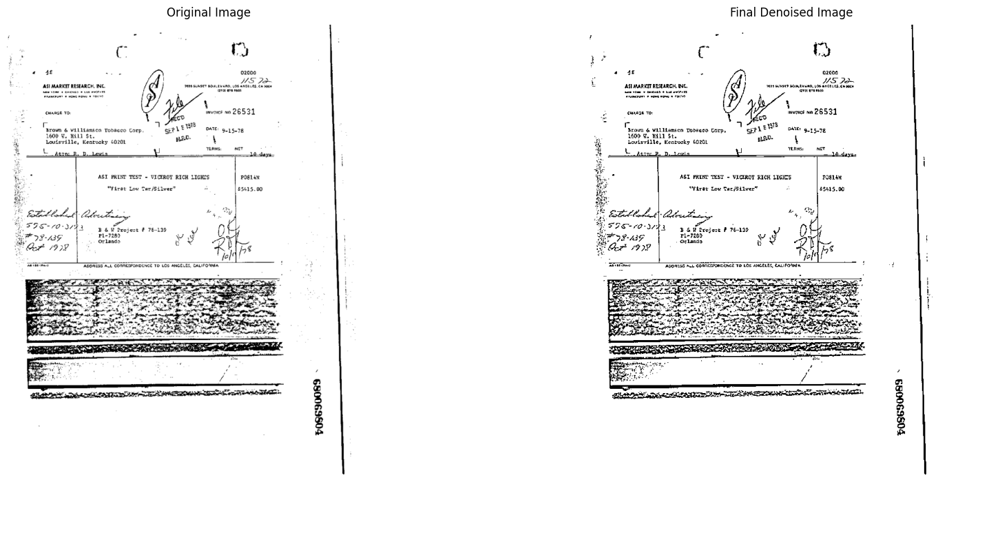

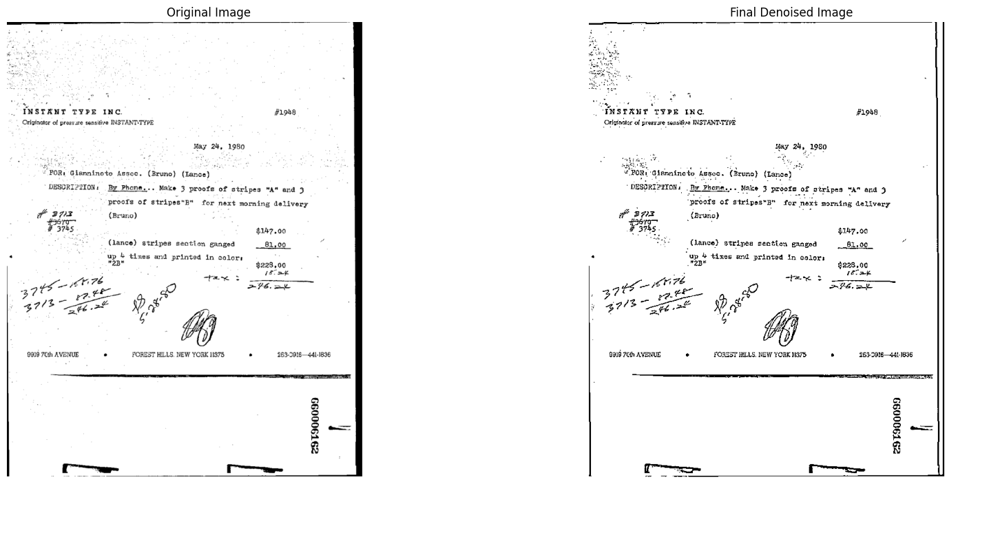

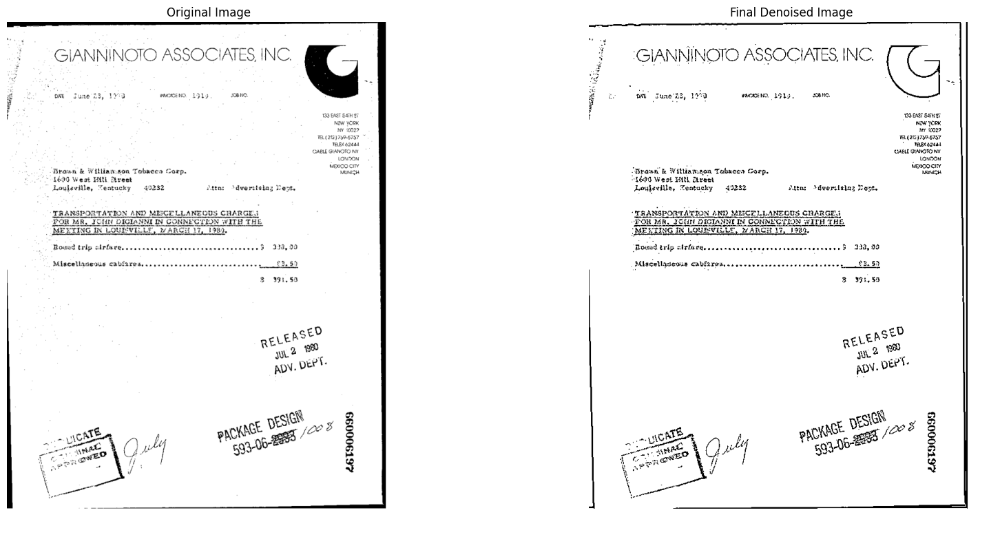

In [ ]:
import cv2
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def pca_denoising(image, variance_retained=0.95):
    # Convert image to float32 for PCA
    image_float32 = np.float32(image)

    # Flatten the image into a 1D array
    X = image_float32.flatten()

    # Perform PCA on the flattened image
    pca = PCA(n_components=variance_retained)
    pca.fit(X.reshape(-1, 1))

    # Project the noisy image onto the principal components
    projected_image = pca.transform(X.reshape(-1, 1))

    # Reconstruct the image using the reduced number of principal components
    reconstructed_image = pca.inverse_transform(projected_image).reshape(image.shape)

    # Convert reconstructed image back to uint8
    denoised_image = np.uint8(np.clip(reconstructed_image, 0, 255))

    return denoised_image

# Read the noisy text image
def process_image(image_path,output_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Step 1: Apply Gaussian Blurring
    blurred_image = cv2.GaussianBlur(image, (1, 1), 0)

    # Step 2: Apply PCA Denoising
    blurred_image = cv2.fastNlMeansDenoising(blurred_image, None, 10, 17, 60)
    variance_retained = 0.15
    pca_denoised_image = pca_denoising(blurred_image, variance_retained)

    # Step 3: Apply Non-Local Means Denoising
    #_, final_denoised_image = cv2.threshold(pca_denoised_image, 127, 255, cv2.THRESH_BINARY)
    final_denoised_image = cv2.adaptiveThreshold(pca_denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 17)

    # Display the original and denoised images
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    '''plt.subplot(1, 3, 2)
    plt.imshow(pca_denoised_image, cmap='gray')
    plt.title('PCA Denoised Image')
    plt.axis('off')'''

    plt.subplot(1, 2, 2)
    plt.imshow(final_denoised_image, cmap='gray')
    plt.title('Final Denoised Image')
    plt.axis('off')

    cv2.imwrite(output_path,final_denoised_image)
def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{10+i}.png')
        process_image(image_path, output_path)
if __name__ == "__main__":
    main()


In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000023361.tif',config=r'--oem 3 --psm 6')
print(text)

wtb il one a —_=
ae
Yeu Ss Saf ”
oe Po Bakor rs
ene”
f\ aero
” ‘otadabakogetalveectye ten 7 theemtode
a omyeyeme: autie gasumaye ap7'
oye trey watinvcn
te biter intoett
: 2 Meanene’ Magee
Was aN6,s6
i cy —
we Vy
i i er ee
¥ : a
, - —_—
g
: gs =
Ie IS
4 =—



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_11.png',config=r'--oem 3 --psm 6')
print(text)

SYNTION ORDER - C
(ULICH-KOENIG ADVERTISING INC. 145150. MIAMI AVENUE, MIAMI, FLORIDA 33131
S-B7H0451 308-371-0801
JFavtidia or van davenriame abe OY ware or ance 27282728
Fo+RQ=1
‘ Mc. DeWitt Ingraham . ~ —
WEDR=Radio
1437 NW 35th Streat
» Miami, Florida .
#14 YOUR AUTHORITY FO INSERT THE ADVERTISING OF
fervibh .. DAME VOTERS FOR FREE CHOICE, INC.
pier Politieal advertising
sk of: at Radio Commercials Bross Cost
20-26 360 330
Jat 3 3 6-9AN $137.64
3 3 3+6PH. 237.64
$275.26
oD
@
2
. S
— - - a ss
Be ee oe we - a
o
pen BELL Murphy .



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000113760.tif',config=r'--oem 3 --psm 6')
print(text)

7 GIANNINOTO ASSOCIATES, INC. | ©
¢ om fune'23, 393 mwoneno 19ty, | smn
: RO EAST SST
at Yoo
epee)
mcenesn?
‘ecu
camomtone
on
Brown & Wiltiag.son Tabacco Corp. oe
1603 West HIM street
Loulseille, “eatucky 49232 Dita: “dvertising Best.
TRANSPORTATION AND MISCELLANEOUS CHARGES
HOR MR, JoUN DIGIANNE IN CONNECTION WITB THE
MECTING IRLOUMVELLE, NARGH 17, 190),
Rowad trip alrfaressccsccceccceseecsscensaccessesee s 335,90
Miscetladesus cabiaresscsscseseeessesesesesesseerg £2053
e 391.59
sed
REE
ww?
ADV. pert.
4 2
GK aS
Ck ve joeb 3
ont, / packer / 3
EY Oly Peo 8
co wee By’ ~ a
Plone” Vy eS
\ . it a
\
\ ee



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_16.png',config=r'--oem 3 --psm 6')
print(text)

: GIANNINOTO ASSOCIATES, INC.

: : om Sune'hd, 1289 WHOKCENO. L325, sOBNG.

: wocet emis
aw YORK,
entre)

TaynRETST
Taxencas
anit GanoTO ne
Loxbon
“Brawn & Wittiamgon Tabacen Corp. bearer
4609 Wet Miti, fhreet
Aouksvitle, Zentucky 49222 Atte: Sdversizing Rost.
“TRANSPORTATION AND MISCELLANEOUS CHARGES
Fon MR, Toler HiGIA ME IN CONNECTION WITH THE
EECTING IN LOVEVIELE, NARCH 17, 1923,
[Bowod trip alvfargesssccsseveaserersecaneerseaseeee ® 123,99
Miagellyseoun caVEareiyssseeegenecesesereceateareen S253
3 391 Sa
ged
RELEASE 0
yu
apn. bert
A o
SER ae 2
eat. ppMnee Veg (F 3
noble ba » a s
Teese | yt Q3-o* Ss
ona Z xo 8
(ene i &
b aes ” J $
\



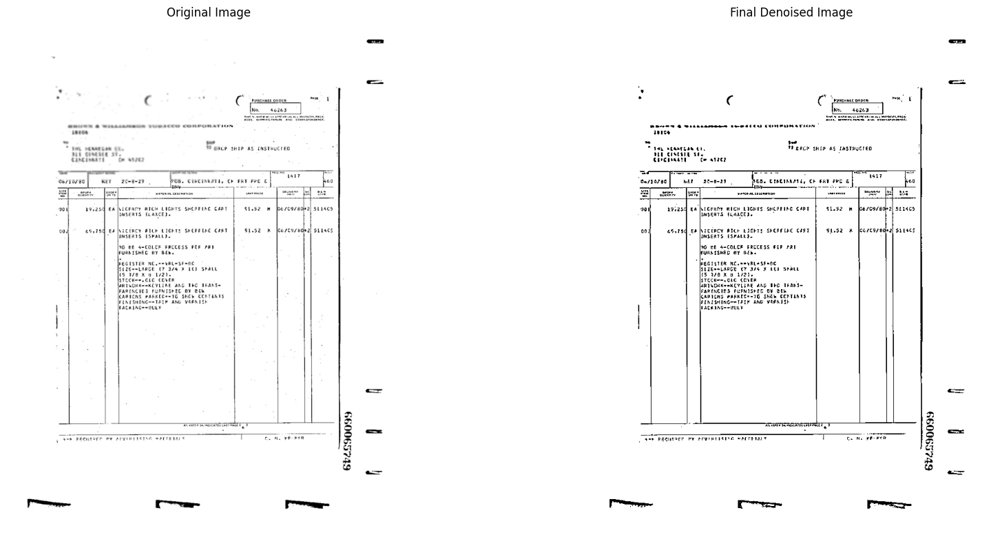

In [ ]:
import cv2
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def pca_denoising(image, variance_retained=0.95):
    # Convert image to float32 for PCA
    image_float32 = np.float32(image)

    # Flatten the image into a 1D array
    X = image_float32.flatten()

    # Perform PCA on the flattened image
    pca = PCA(n_components=variance_retained)
    pca.fit(X.reshape(-1, 1))

    # Project the noisy image onto the principal components
    projected_image = pca.transform(X.reshape(-1, 1))

    # Reconstruct the image using the reduced number of principal components
    reconstructed_image = pca.inverse_transform(projected_image).reshape(image.shape)

    # Convert reconstructed image back to uint8
    denoised_image = np.uint8(np.clip(reconstructed_image, 0, 255))

    return denoised_image

# Read the noisy text image
def process_image(image_path,output_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Step 1: Apply Gaussian Blurring
    blurred_image = cv2.GaussianBlur(image, (1, 1), 0)

    # Step 2: Apply PCA Denoising
    blurred_image = cv2.fastNlMeansDenoising(blurred_image, None, 10, 17, 60)
    variance_retained = 0.15
    pca_denoised_image = pca_denoising(blurred_image, variance_retained)

    # Step 3: Apply Non-Local Means Denoising
    #_, final_denoised_image = cv2.threshold(pca_denoised_image, 127, 255, cv2.THRESH_BINARY)
    final_denoised_image = cv2.adaptiveThreshold(pca_denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 17)

    # Display the original and denoised images
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    '''plt.subplot(1, 3, 2)
    plt.imshow(pca_denoised_image, cmap='gray')
    plt.title('PCA Denoised Image')
    plt.axis('off')'''

    plt.subplot(1, 2, 2)
    plt.imshow(final_denoised_image, cmap='gray')
    plt.title('Final Denoised Image')
    plt.axis('off')

    cv2.imwrite(output_path,final_denoised_image)
def main():
        image_path = '/content/WhatsApp Image 2024-05-28 at 13.20.47.jpeg'
        output_path = os.path.join('/content/sample_data', f'denoised_enhanced_kpca.png')
        process_image(image_path, output_path)
if __name__ == "__main__":
    main()


In [ ]:
text = pytesseract.image_to_string('/content/sample_data/denoised_enhanced_kpca.png',config=r'--oem 3 --psm 6')
print(text)

Co FISE veece Uh le LOT POTS Go Rsoecit § Chocaen ne Soca ONSEN, SoD e
al fete Do ee Vi RASRIET ALB FInSGhgs OEMRETCCT ARDKIGD FoGUEOLDEY Hlecor
a 7 doag: 901 saaley 7 9 90838 Bio as76] VERDAL-SEWKCS SroRTo78 |
 ' sorgzenco [e7z ewakes> so PA pLva ers 1, 30, NEY Dee 478i
saore Te we et
PB Te + 7S Seaham ices mast mmennsiomcusrasin
i Biren commas eto Te aise
: DR MURRAY SENCS Tennentncecwtmarnetin
, [2526 CouNTRY oLep RD co renee oi tenes
: WCUSTOMSALSN BC 27204 0, . metas! 2 :
Deed getiehmmic tan fen CRT EE 7 eit os 3g oe og set ra”
Sodas beserirron  sesee Hlast aire’ eons Sam oo haw
; 3 [PRO-TEX COLORTWETRIC BADGE ScRTES pou Ce oom
i 2 60 FORNALDZHYDS O BGR i. . « i
t 3.05 BOXES . 5 30 926 a : \ Sfionng . ecco
: “ : alas :
pas \ | pol peor 3390
pes PREPAE SREIGHT |... O17 roecto| : 7) saks00 of das
t | . ae) by Nee
: i i | 1 Poy e/
- cy ae lot eel eee
fg MOOAY SENKUS Aas 64 Be ;
ve 2648 COUNTY CLUB AOD Dy fe _ !
4 g SEE oe be Benita Hexen & Sg ESO -Eor:
ee ao ed bh A, fg tt. adh » $8_

In [ ]:
text = pytesseract.image_to_string('/content/WhatsApp Image 2024-05-28 at 11.06.24.jpeg',config=r'--oem 3 --psm 6')
print(text)

Je SES RSS Eh eceSee! do ema Goosen gice’ yaa
ivsia Poter Vio RASRIST ALB FunEGgs OEMRETACCT AROMIGD FSEUEOLDEY Hlecors
ea 7 doag: 901 saaley 7 9 90838 Bio as76] VERDAL-SEWKCS SoRTe7a |
' sorgzendo [e:z kewaks> so PA pLya ers 1 30, MEY Oee 478i
eee eee oe — os | we
Pda Rs Tee, oF he Soiccnrian alate maiat aia EEE
I Biren commas eto Ty ate
i DR MURRAY SENCS ee,
, [2525 CCUNTRY CLeB RD tg eh, die omewcig cyan ae
: WCUSTOMSALGN BC 27204 0, : Betis! 2 :
SE (gtnag mann age TART ET ES 7 nets ncaa ae oP Uae cea tea
ge Pe beseneron eae WT at leads aE as
i 3 [PRO-TEX COLORTWETRIC BADGE ScRTES pou Ce sos
i 2 S60 FORKALDZHYDS O BGR i . « :
z 3.05 BOXES . ae 4 30 26 a : \ Scionng % betes
: * : alae a :
pas \ | pol peor 3390
pes PREPAE MREIGHT |... O17 hoecto| : 7) Saks00 of eas
t | ¥ a) by Nes
: i i | 4 Uo e/
es fa tote sae loot cet Lee A
fg MAY SENKUS Aas 64 Be ;
ve 2618 COUNTY CLUB ROAD Dy & sap !
: PER or be Dele Momeni & Sig PSS |
ae ae 7 ear » SS- :
es st dew torttoedl teahie tage euad GRR ee

**Bilateral **

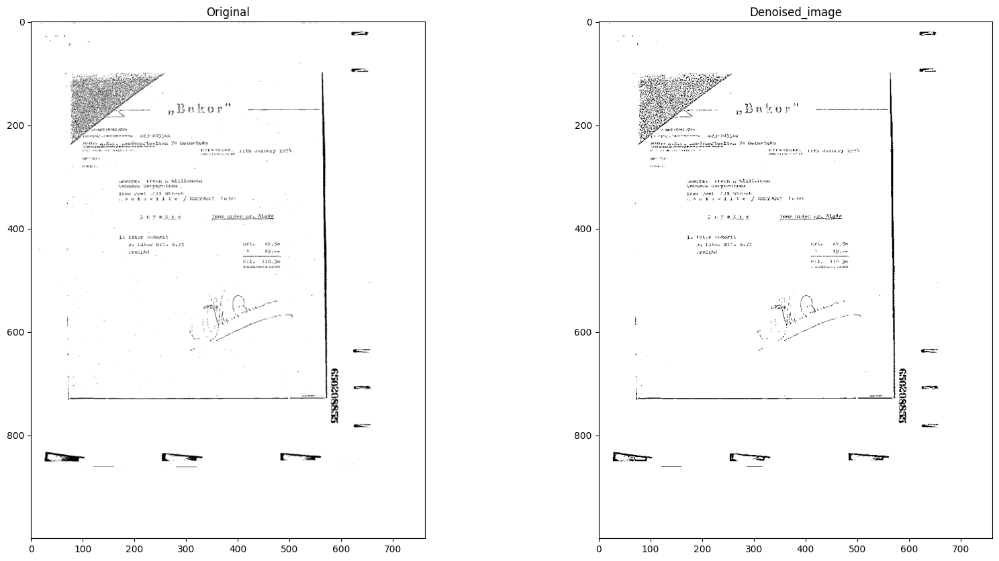

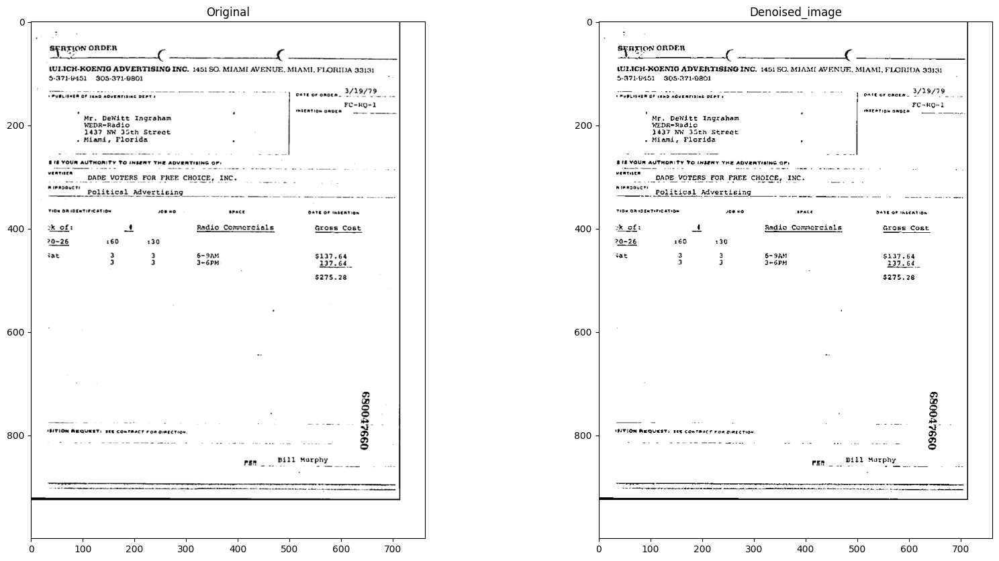

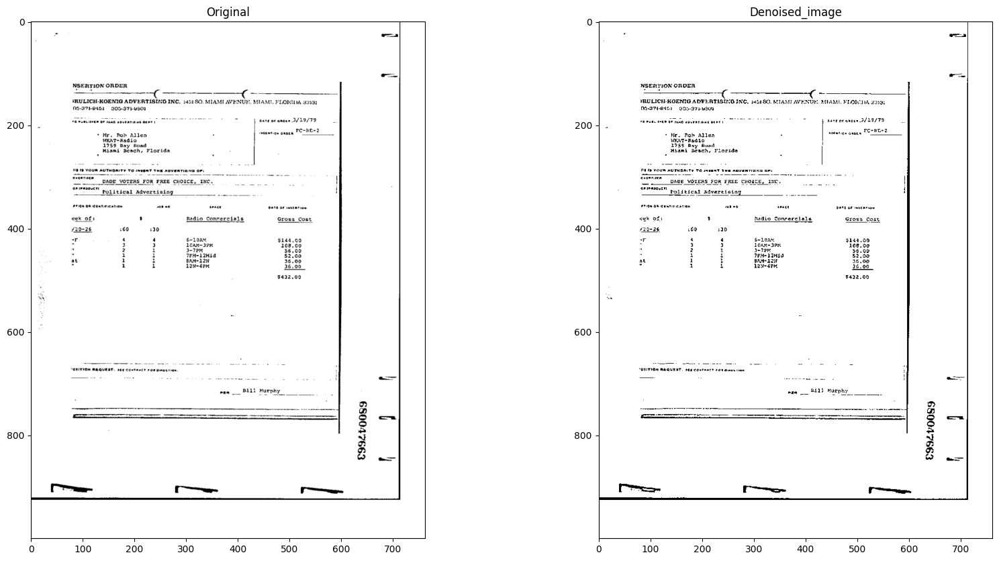

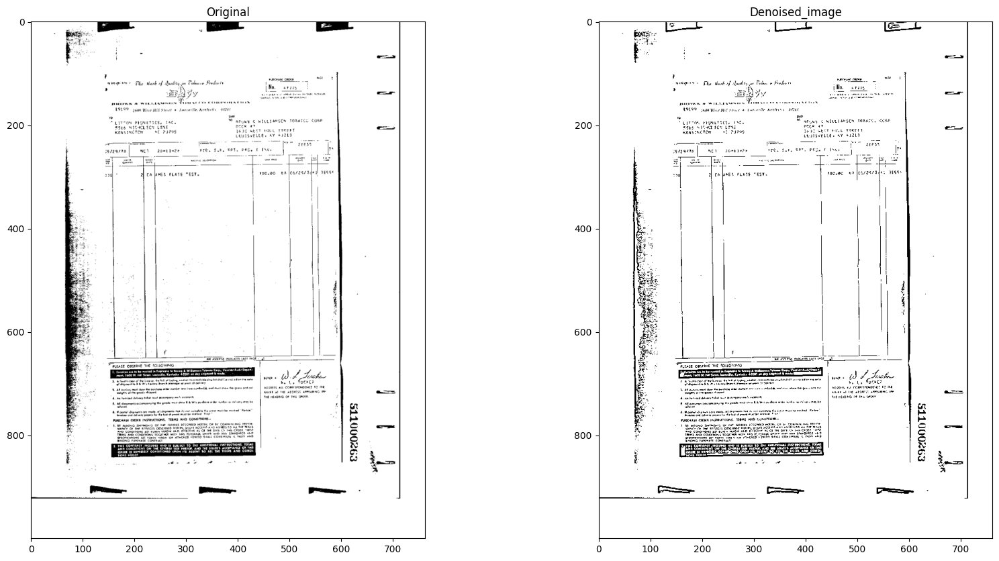

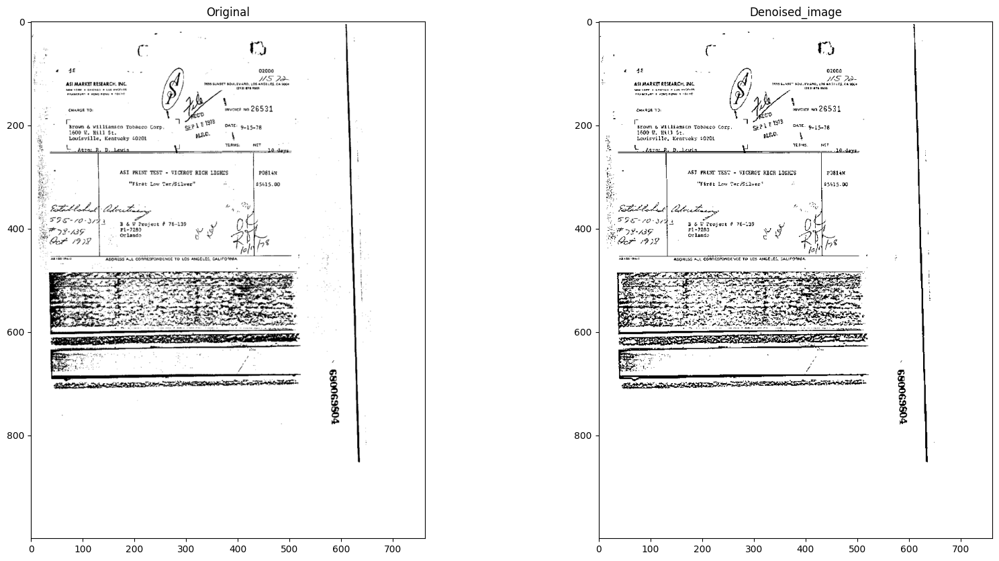

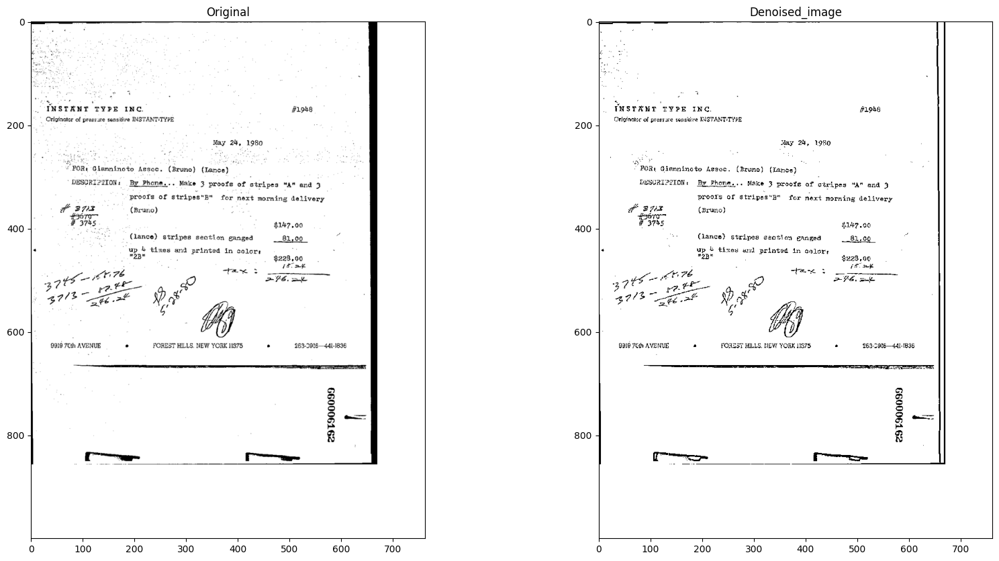

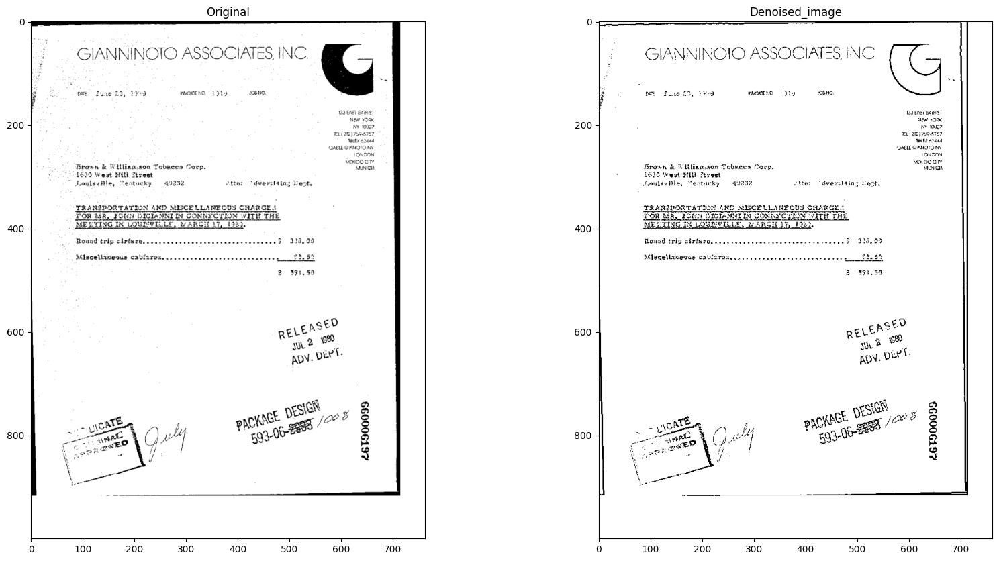

In [ ]:
# Bilateral filtering

import cv2
import matplotlib.pyplot as plt

def process_image(image_path,output_path):

    # Read the image
    org_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Apply Bilateral Filtering

    image = cv2.fastNlMeansDenoising(org_image, None, h=10, templateWindowSize=7, searchWindowSize=41)
    denoised_image = cv2.bilateralFilter(image, d=15, sigmaColor=75, sigmaSpace=75)
    denoised_image = cv2.adaptiveThreshold(denoised_image.astype(np.uint8), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 19)



    #_, denoised_image_bilateral = cv2.threshold(denoised_image_bilateral, 25, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    plt.figure(figsize=(20, 10))  # Adjust width and height as desired
    plt.subplot(1,2,1)
    plt.title('Original')
    plt.imshow(org_image,cmap='gray')

    plt.subplot(1,2,2)
    plt.title('Denoised_image')
    plt.imshow(denoised_image,cmap='gray')

    cv2.imwrite(output_path,denoised_image)
def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        output_path = os.path.join(dataset_directory, f'denoised_enhanced_{1+i}.png')
        process_image(image_path, output_path)
if __name__ == "__main__":
    main()



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/0000113760.tif',config=r'--oem 3 --psm 6')
print(text)

7 GIANNINOTO ASSOCIATES, INC. | ©
¢ om fune'23, 393 mwoneno 19ty, | smn
: RO EAST SST
at Yoo
epee)
mcenesn?
‘ecu
camomtone
on
Brown & Wiltiag.son Tabacco Corp. oe
1603 West HIM street
Loulseille, “eatucky 49232 Dita: “dvertising Best.
TRANSPORTATION AND MISCELLANEOUS CHARGES
HOR MR, JoUN DIGIANNE IN CONNECTION WITB THE
MECTING IRLOUMVELLE, NARGH 17, 190),
Rowad trip alrfaressccsccceccceseecsscensaccessesee s 335,90
Miscetladesus cabiaresscsscseseeessesesesesesseerg £2053
e 391.59
sed
REE
ww?
ADV. pert.
4 2
GK aS
Ck ve joeb 3
ont, / packer / 3
EY Oly Peo 8
co wee By’ ~ a
Plone” Vy eS
\ . it a
\
\ ee



In [ ]:
text = pytesseract.image_to_string('/content/drive/MyDrive/Datasets/invoice (1)/invoice/denoised_enhanced_7.png',config=r'--oem 3 --psm 6')
print(text)

i GIANNINCTO ASSOCIATES, INC. (G
4 pm dune 23, 13 women Lig x0
roesersanst
Se rome
wr on?
suatnventar
estou
cauccmnrone
Brown & Willian.gon Tobmesn Corp. ea
4630 West HOM Ptrwet
Loulsviite, “entucky 49222 Qiker ‘dvertiaing Vest.
TRANIPONTATION AND MISCELLANEOUS CHARGES
POR MR. FouM IGIANNEIN CONNECTION WITH THE
MPCINOR LSeRvEL wenen i a
Boned trip sirlare. ces cater cena tare ct eenec interned OMI
| 8 891s
std
RELERS 0
we *
pby- pert.
a0 2
GR D
K. vs ek B
ont pce / 3
7 we ry) by as Re 3
ee RS BO be gat g
leno fi S
4 “ye a
\
ee



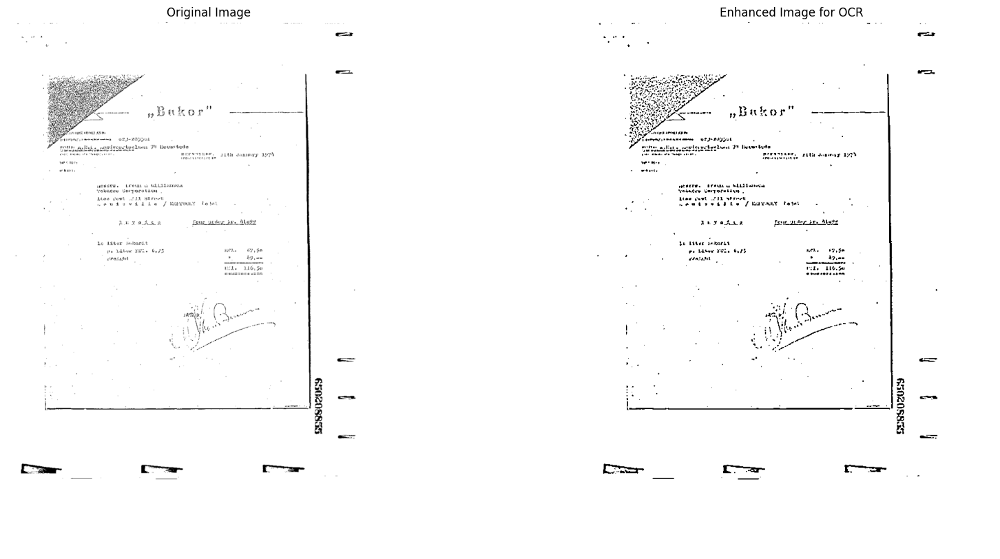

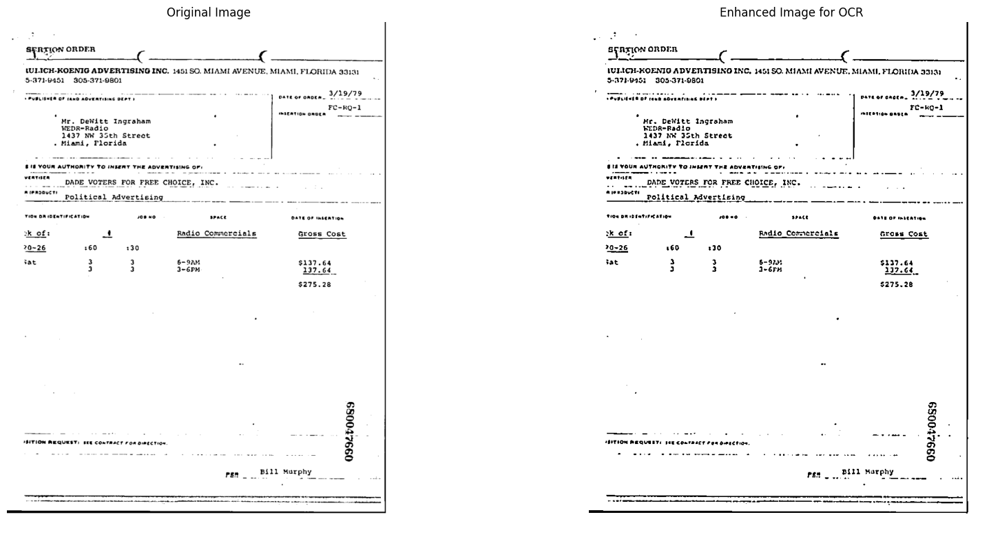

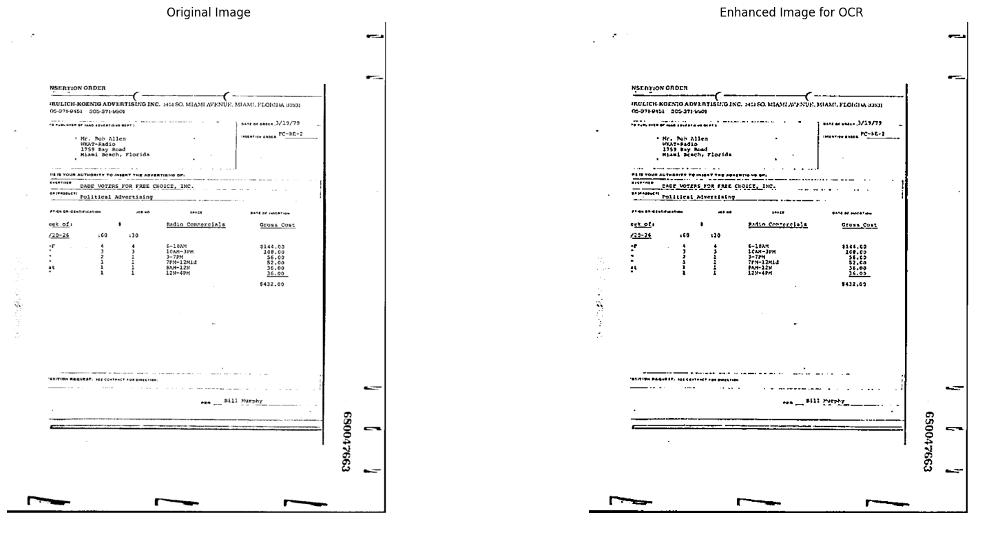

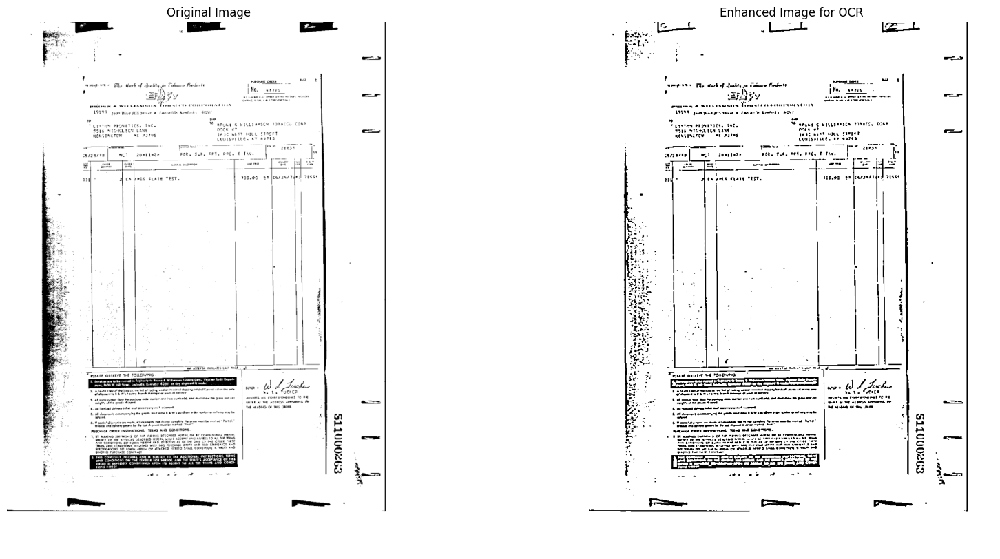

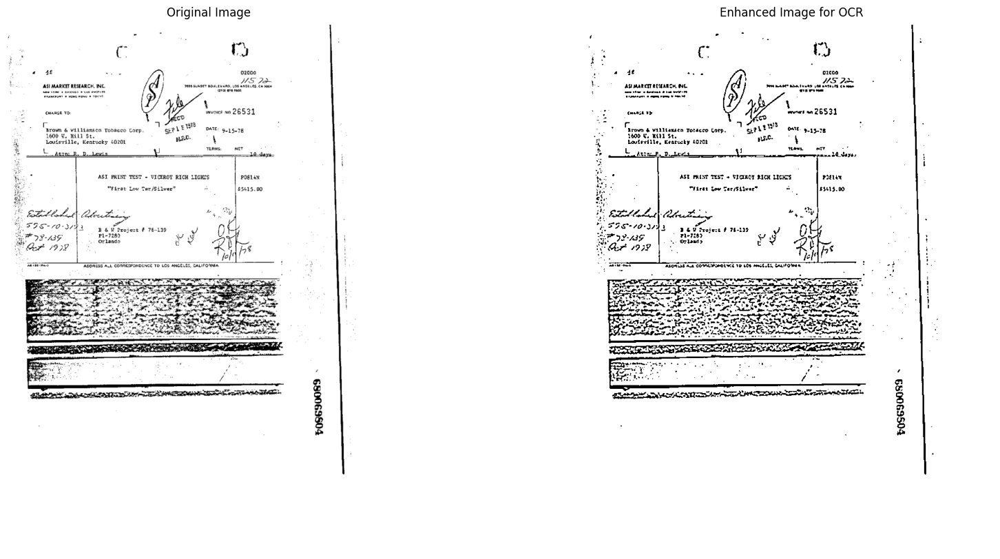

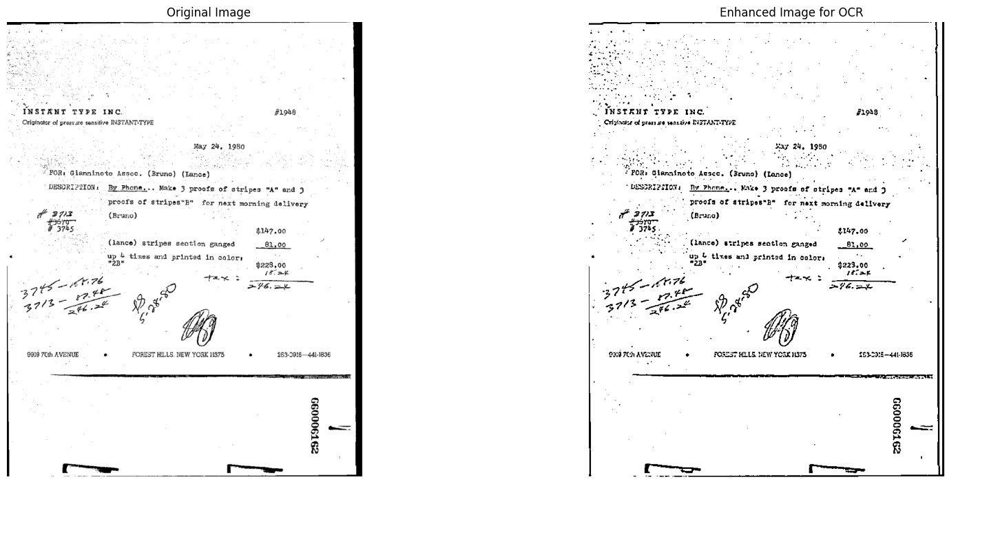

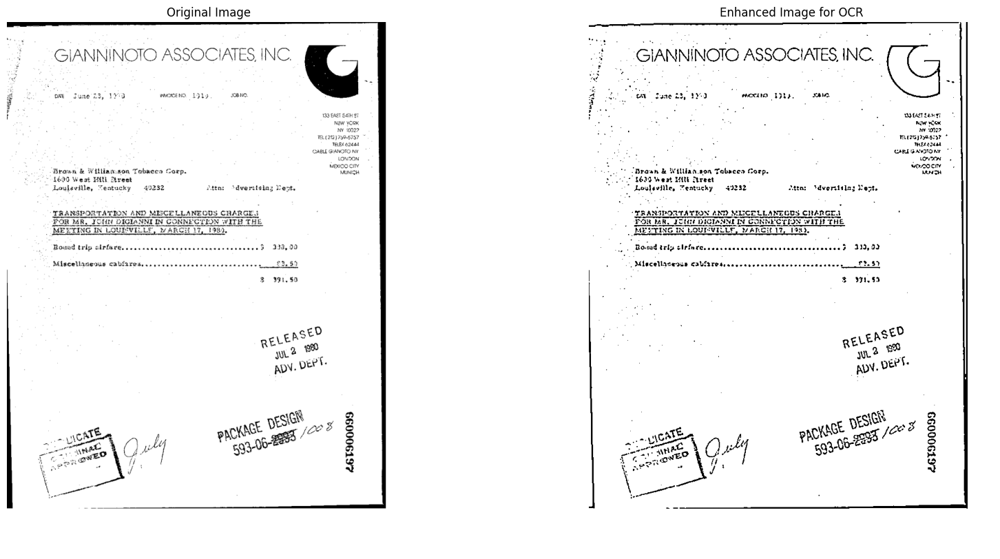

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def gaussian_blur(image, ksize=(5, 5), sigmaX=0):
    # Apply Gaussian blur to the image
    blurred_image = cv2.GaussianBlur(image, ksize, sigmaX)
    return blurred_image

def binary_threshold(image, method='global', threshold_value=127):
    if method == 'global':
        _, binary_image = cv2.threshold(image, threshold_value, 255, cv2.THRESH_BINARY)
    elif method == 'otsu':
        _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    elif method == 'adaptive_mean':
        binary_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 13, 21)
    elif method == 'adaptive_gaussian':
        binary_image = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 13, 21)
    else:
        raise ValueError(f"Unsupported thresholding method: {method}")
    return binary_image

def enhance_for_ocr(image):
    # Apply Gaussian blurring
    blurred_image = gaussian_blur(image, ksize=(3, 3), sigmaX=0)

    # Apply binary thresholding
    binary_image = binary_threshold(blurred_image, method='adaptive_gaussian')

    return binary_image

def process_image(image_path):
    # Read the input image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Enhance image for OCR
    enhanced_image = enhance_for_ocr(image)

    # Display original and enhanced images side by side
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(enhanced_image, cmap='gray')
    plt.title("Enhanced Image for OCR")
    plt.axis('off')

    plt.show()

def main():
    dataset_directory = '/content/drive/MyDrive/Datasets/invoice (1)/invoice'

    # List all files in the directory
    files = sorted(os.listdir(dataset_directory))

    # Filter out non-image files
    files = [file for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

    # Process the first seven files
    for i, file in enumerate(files[:7]):
        image_path = os.path.join(dataset_directory, file)
        process_image(image_path)

if __name__ == "__main__":
    main()


**Random Forest Regressor**

Image loaded successfully.
Gaussian Blur applied.
Median Blur applied.
Bilateral Filter applied.


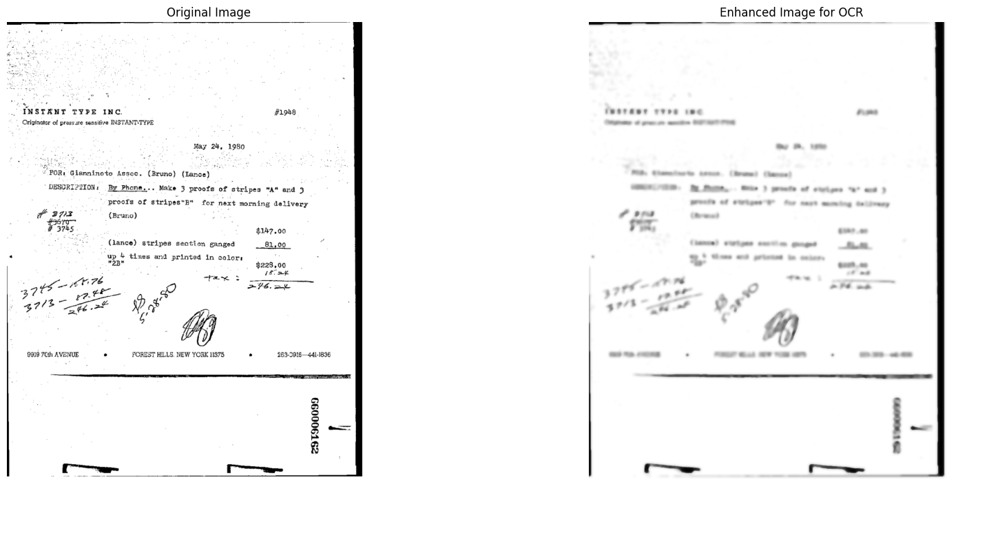

In [ ]:
import cv2
import numpy as np

def combined_denoise(image_path, gaussian_ksize=(5, 5), median_ksize=5, bilateral_diameter=9, bilateral_sigma_color=75, bilateral_sigma_space=75):
    # Load the image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise ValueError(f"Image at path {image_path} could not be loaded.")
    print("Image loaded successfully.")

    # Apply Gaussian Blur
    gaussian_blur = cv2.GaussianBlur(image, gaussian_ksize, 0)
    print("Gaussian Blur applied.")

    # Apply Median Blur
    median_blur = cv2.medianBlur(gaussian_blur, median_ksize)
    print("Median Blur applied.")

    # Apply Bilateral Filter
    bilateral_filter = cv2.bilateralFilter(median_blur, bilateral_diameter, bilateral_sigma_color, bilateral_sigma_space)
    print("Bilateral Filter applied.")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(bilateral_filter, cmap='gray')
    plt.title("Enhanced Image for OCR")
    plt.axis('off')

    return bilateral_filter

# Example usage
input_image_path = "/content/drive/MyDrive/Datasets/0000113725.tif"
denoised_result = combined_denoise(input_image_path)


In [ ]:
+